# Automating medullary segmentation 

I loath to call this drawing the CMJ because the CMJ is not a simple decision boundary. 

Use the Mesmer_pypi conda environment.

In [1]:
import numpy as np
from scipy import ndimage
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
from sklearn.mixture import GaussianMixture
import tifffile
from pathlib import Path
import os
import cv2
import re
import typing
str_or_path = typing.Union[str, os.PathLike]
from deco import synchronized, concurrent

/stor/home/jfm2773/anaconda3/envs/Mesmer_pypi/lib/python3.7/site-packages/sklearn/utils/validation.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  LARGE_SPARSE_SUPPORTED = LooseVersion(scipy_version) >= '0.14.0'
/stor/home/jfm2773/anaconda3/envs/Mesmer_pypi/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
/stor/home/jfm2773/anaconda3/envs/Mesmer_pypi/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning

## Functions

In [3]:
def remove_tif(img_dir, image_to_remove= "image.tif") -> None:
    img_path = [os.path.join(img_dir, img_file) for img_file in os.listdir(img_dir) if re.search(image_to_remove, img_file) and not img_file.startswith(".")]
    assert len(img_path)  == 1, f"More than one file to remove in {img_dir}"
    img_path = img_path[0]
    os.remove(img_path)
    return None
    
def setup_image(image_dir, glob_str= "image.tif", channel_loc= 2, median_ksize= 11, mean_ksize = (11,11), normalize= False):
    image_name = [file_path for file_path in Path(image_dir).rglob(glob_str)]
    if len(image_name) > 1:
        print(image_dir + " has more than one tif")
    full_img  = tifffile.imread(os.path.join(image_dir, *image_name))
    img = full_img[channel_loc, ...]
    
    if normalize: 
        ## Normalize imaging data
        scaled_img = (img - np.mean(img)) / np.std(img)
        norm_img = np.arcsinh(scaled_img)
        norm_img = norm_img.astype("uint8")
        ## Median blur
        med_blur = cv2.medianBlur(norm_img, median_ksize)  
    else: 
        ## Median blur
        med_blur = cv2.medianBlur(img, median_ksize)  

    ## Trying a mean blur instead to get an even blurry medulla. 
    mean_ksize = (11,11)
    mean_blur = cv2.blur(med_blur, mean_ksize)

    return mean_blur

def run_image_GMM(img, n_gaussians= 4, downsample_divisor= 4):
    ## Downsampling to decrease computation time
    reshaped_img = img.reshape((img.size, 1)).flatten()

    ## Removing the outliers to deal w/ some bright medulla that might've caused some issues. 
        ## I thought about filtering the bottom outliers, but the values are always going to be 0. 
    top_outliers = np.percentile(reshaped_img, [97.5])
    reshaped_img = reshaped_img[(reshaped_img < top_outliers)]
    downsampled_img = np.random.choice(a       = reshaped_img, 
                                       size    = reshaped_img.size // downsample_divisor, 
                                       replace = False)

    ## Add dimension for use w/ GMM
    downsampled_img= downsampled_img[..., np.newaxis]
    gm = GaussianMixture(n_components= n_gaussians)
    gm.fit(downsampled_img)
        ## This is the step that takes a while 

    thresholds = gm.means_.flatten()
    thresholds.sort()

    return thresholds


@concurrent
def GMM_wrapper(img, n):
    ## Making this wrapper to add deco concurrency to GMM function
    model = GaussianMixture(n_components= n).fit(img)
    return model


@synchronized # And we add this for the function which calls the concurrent function
def parallelize_GMMs(img, max_components):
    models = [GMM_wrapper(img= img, n= n) for n in np.arange(2, max_components+1)]
    return(models)


def find_n_gaussians(img, max_components):
    downsampled_img= np.random.choice(a        = img.reshape((img.size, 1)).flatten(), 
                                      size     = img.size // 4, 
                                      replace  = False)

    GMM_models = parallelize_GMMs(img= downsampled_img, max_components= max_components)

    n_components = np.arange(2, max_components)
    plt.plot(n_components, [m.bic(downsampled_img) for m in GMM_models], label='BIC')
    plt.plot(n_components, [m.aic(downsampled_img) for m in GMM_models], label='AIC')
    plt.legend(loc='best')
    plt.xlabel('n_components')


def make_threshold_masks(img, sorted_thresholds, morph_ksize= (75, 75), morph_median_ksize= 251):

    num_thresholds = sorted_thresholds.size

    threshold_masks = np.zeros((num_thresholds, img.shape[0], img.shape[1]))

    for i in range(0, num_thresholds):
        threshold  = sorted_thresholds[i]
        binary_img = img > threshold
        binary_img = binary_img * np.uint8(1)     

        ## Generate tissue shapes 
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, morph_ksize)
        binary_img = cv2.morphologyEx(binary_img, cv2.MORPH_CLOSE, kernel)

        ## Remove salt-and-pepper noise
        binary_img = cv2.medianBlur(binary_img, morph_median_ksize)

        ## I flipped the order of the small island removal and the hole filling 

        ## Removing small islands
        num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(binary_img)

        min_spot_area = 50_000
        filtered_img = np.zeros_like(binary_img)
        for label in range(1, num_labels):
            area = stats[label, cv2.CC_STAT_AREA]
            if area >= min_spot_area:
                filtered_img[labels == label] = 255

        ## Filling small holes
        contour, hier = cv2.findContours(filtered_img, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
        # max_hole_area= 25_000
        max_hole_area= 250_000
            ## Setting max_hole_area to 1e11 removes all holes, so there is a sweat spot between 25000 and 1e11.
        for cnt in contour:
            area = cv2.contourArea(cnt)
            if area <= max_hole_area:
                cv2.drawContours(filtered_img,[cnt],0,255,-1)

        threshold_masks[i,...] = filtered_img
    return threshold_masks

def overlay_cortex_and_medulla(image_dir, medulla, cortex, out_name= "tissue_segmented_image.ome.tif", image_name= "reordered_image.ome.tif") -> None:
    ## Adding dimension for concatenation
    medulla = medulla[np.newaxis,...]
    cortex  = cortex[np.newaxis,...]

    all_channels_img = tifffile.imread(os.path.join(image_dir, image_name))
    tissue_img = np.concatenate((all_channels_img, cortex, medulla))
    tifffile.imwrite(os.path.join(image_dir, out_name), tissue_img)
    return None 

@concurrent
def histocytometry_wrapper(image_dir, whole_lobe_threshold_rank, medullary_threshold_rank, medulla_layer= 2, cortical_layer= 1, save_masks= True, plot_thresholds= True, plot_tissues= True, setup_kwargs= {}, run_image_GMM_kwargs= {}, make_threshold_masks_kwargs= {}):
    print("Starting segmentation of " + image_dir + "\n")
    
    img = setup_image(image_dir = image_dir, **setup_kwargs)

    sorted_thresholds = run_image_GMM(img= img, **run_image_GMM_kwargs)

    threshold_masks = make_threshold_masks(img= img, sorted_thresholds= sorted_thresholds, **make_threshold_masks_kwargs)
    threshold_masks = threshold_masks.astype("uint8") 
        ## Hard-coding, but I could replace with img.dtype

    medulla_mask = threshold_masks[medullary_threshold_rank-1,...]
    whole_lobe_mask = threshold_masks[whole_lobe_threshold_rank-1,...]
    cortex_mask = whole_lobe_mask - medulla_mask

    if plot_tissues:
        _, ax = plt.subplots(1,4)
        ax[0].imshow(img)
        ax[0].set_title('Marker')
        ax[1].imshow(whole_lobe_mask, cmap= plt.cm.gray)
        ax[1].set_title('Whole lobe')
        ax[2].imshow(medulla_mask, cmap= plt.cm.gray)
        ax[2].set_title('Medulla')
        ax[3].imshow(cortex_mask, cmap= plt.cm.gray)
        ax[3].set_title("Cortex")
        plt.suptitle(image_dir) 
        plt.show()

    if "n_gaussians" in list(run_image_GMM_kwargs.keys()):
        n_gaussians= run_image_GMM_kwargs["n_gaussians"]
    else:
        n_gaussians= 4

    if plot_thresholds:
        _, ax = plt.subplots(1,n_gaussians)
        for i in range(0, n_gaussians):
            ax[i].imshow(threshold_masks[i,...], cmap= plt.cm.gray)
            ax[i].set_title(f'Gaussian {i+1}')
            ax[i].axison= False
        plt.suptitle(image_dir) 
        plt.show() 


    if save_masks:
        tifffile.imwrite(os.path.join(image_dir, "medulla_mask.tif"), medulla_mask)
        tifffile.imwrite(os.path.join(image_dir, "cortex_mask.tif"),  cortex_mask)  

        overlay_cortex_and_medulla(image_dir = image_dir, 
                                   medulla   = medulla_mask, 
                                   cortex    = cortex_mask)


@synchronized
def histocytometry_wrapper_parallelization(image_dirs, whole_lobe_threshold_rank, medullary_threshold_rank, n_gaussians= 4, save_masks= True, plot_tissues= False, plot_thresholds= True):
    for image_dir in image_dirs:
        histocytometry_wrapper(
            image_dir                 = image_dir, 
            setup_kwargs              = {"glob_str" : "reordered_image.ome.tif"}, 
            save_masks                = save_masks, 
            run_image_GMM_kwargs      = {"n_gaussians" : n_gaussians}, 
            plot_tissues              = plot_tissues,  
            plot_thresholds           = plot_thresholds, 
            whole_lobe_threshold_rank = whole_lobe_threshold_rank,
            medullary_threshold_rank  = medullary_threshold_rank)
    return None


def tissue_segmentation_plot(img_dir, img, thresholds, threshold_masks):
    print("Starting plot")
    _, ax = plt.subplots(1,len(thresholds)+1, figsize= (12,6))
    ax[0].imshow(img)
    ax[0].set_title("Marker")
    for i in range(1, len(thresholds)+1):
        ax[i].imshow(threshold_masks[i-1,...], cmap= plt.cm.gray)
        ax[i].set_title(f'Thresh: {round(thresholds[i-1], 1)}')
    plt.suptitle(img_dir) 
    plt.show() 

@concurrent
def tissue_segmentation(img_dir, thresholds, morph_ksize, channel_loc, out_name= "", glob_str= "reordered_image.ome.tif", save_mask= False, normalize= False) -> None:
    print("Starting " + img_dir + "\n")

    ## Take stain and apply thresholds
    img = setup_image(image_dir= img_dir, glob_str= glob_str,  channel_loc= channel_loc, normalize= normalize)
    threshold_masks = make_threshold_masks(img= img, sorted_thresholds= thresholds, morph_ksize= morph_ksize)
    threshold_masks = threshold_masks.astype("uint8") 

    tissue_segmentation_plot(
        img_dir         = img_dir, 
        img             = img,
        thresholds      = thresholds, 
        threshold_masks = threshold_masks
    )

    if save_mask:
        assert min(threshold_masks.shape) == 1, "There are multiple threshold masks. Make sure there is only one threshold in the thresholds argument."
        tifffile.imwrite(os.path.join(img_dir, out_name), threshold_masks.squeeze())

    return None


@synchronized
def parallelize_segmentation(img_dirs, thresholds, morph_ksize, channel_loc, save_mask, out_name= "", glob_str= "reordered_image.ome.tif", normalize= False):
    ## Use this function to speed up plotting of whole lobe masks and medulla masks
    ## I'll visually inspect the results to pick the best thresholds
    for img_dir in img_dirs:
        tissue_segmentation(img_dir     = img_dir, 
                            thresholds  = thresholds, 
                            channel_loc = channel_loc, 
                            glob_str    = glob_str,
                            save_mask   = save_mask,
                            out_name    = out_name,
                            normalize   = normalize,
                            morph_ksize = morph_ksize)
        

@concurrent
def medulla_gmm_wrapper(img_dir, medullary_threshold_rank= 4, glob_str= "reordered_image.ome.tif", channel_loc= 2, downsample_divisor= 8, n_gaussians= 4, save_mask= False, out_name= "medulla_mask.tif", normalize= False) -> None:
    ## Take CD11c or CD63 stains 
    medulla_stain = setup_image(image_dir= img_dir, glob_str= glob_str,  channel_loc= channel_loc, normalize= normalize)
    
    ## Run various GMMs
    sorted_thresholds = run_image_GMM(img= medulla_stain, n_gaussians= n_gaussians, downsample_divisor= downsample_divisor)

    threshold_masks = make_threshold_masks(img= medulla_stain, sorted_thresholds= sorted_thresholds)
    threshold_masks = threshold_masks.astype("uint8") 

    tissue_segmentation_plot(
        img_dir         = img_dir, 
        img             = medulla_stain,
        thresholds      = sorted_thresholds, 
        threshold_masks = threshold_masks
    )

    medulla_mask= threshold_masks[medullary_threshold_rank-1,...]

    if save_mask:
        tifffile.imwrite(os.path.join(img_dir, out_name), medulla_mask)

    return None


@synchronized
def parallelize_medulla(img_dirs, medullary_threshold_rank, save_mask= False, channel_loc= 2, n_gaussians= 4, normalize= False):
    for img_dir in img_dirs: 
        medulla_gmm_wrapper(
            img_dir                  = img_dir, 
            save_mask                = save_mask,
            channel_loc              = channel_loc, 
            medullary_threshold_rank = medullary_threshold_rank,
            n_gaussians              = n_gaussians,
            normalize                = normalize
        )

def make_cortex(img_dir, medulla_mask= "medulla_mask.tif", whole_lobe_mask= "whole_lobe_mask.tif") -> None:

    medulla_mask = tifffile.imread(os.path.join(img_dir, medulla_mask))
    whole_lobe_mask = tifffile.imread(os.path.join(img_dir, whole_lobe_mask))
    cortex_mask = whole_lobe_mask - medulla_mask
    cortex_mask = cortex_mask.astype("uint8") 
    
    tifffile.imwrite(os.path.join(img_dir, "cortex_mask.tif"), cortex_mask)
    return None    

Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
Done with /stor/scratch/Ehrlich/Users/John

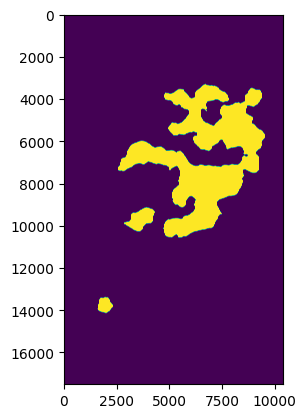

In [4]:
## Pulling out the cleaned Medulla masks 
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir) and not re.search("_Sirpa_C$", img_dir)]
img_dirs.sort()

for img_dir in img_dirs:
    img_w_medulla = tifffile.imread(os.path.join(img_dir, "img_w_medulla.ome.tif"))
    medulla_mask  = img_w_medulla[4,...]
    binary_medulla_mask = medulla_mask > 0 

    plt.imshow(binary_medulla_mask)
    

    tifffile.imwrite(os.path.join(img_dir, "cleaned_medulla_mask.tif"), binary_medulla_mask)
    print(f"Done with {img_dir}")

In [8]:
## Saving cortex and medulla cortex
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir) and not re.search("Sirpa_C$", img_dir)]
img_dirs.sort()

for img_dir in img_dirs:
    print(img_dir)
    img= tifffile.imread(os.path.join(img_dir, "reordered_image.ome.tif"))
    whole_lobe_mask = tifffile.imread(os.path.join(img_dir, "whole_lobe_mask.tif")).astype("uint8")
    ## Convert my poorly formatted whole lobe mask to 0 and 1 instead of 0 and 255
    whole_lobe_mask = whole_lobe_mask > 0
    cleaned_medulla_mask = tifffile.imread(os.path.join(img_dir, "cleaned_medulla_mask.tif")).astype("uint8")

    cortex_mask = whole_lobe_mask - cleaned_medulla_mask

    medulla        = img * cleaned_medulla_mask 
    cortex         = img * cortex_mask

    tifffile.imwrite(os.path.join(img_dir, "cleaned_medulla_img.ome.tif"), medulla)
    tifffile.imwrite(os.path.join(img_dir, "cleaned_cortex_img.ome.tif"), cortex)
    

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A


/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_D
/stor/scratch/E

## Whole lobe thresholding

All of this looks good. LOCKED.

In [4]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir)]
img_dirs.sort()

for img_dir in img_dirs:
    print(img_dir)

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
/stor/scratch

Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
Starting /stor/scratch/Ehrlich/Users/John/histocytom

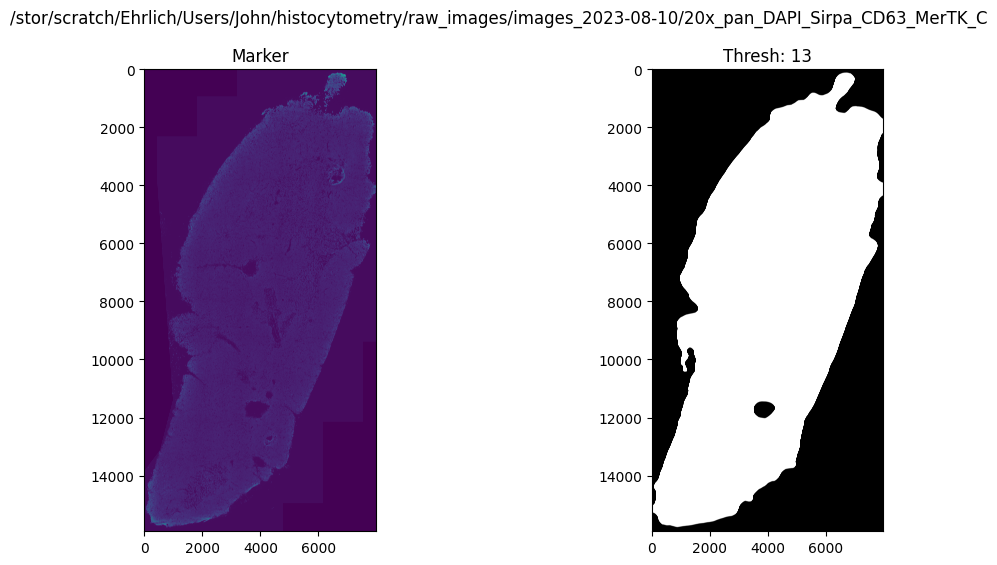

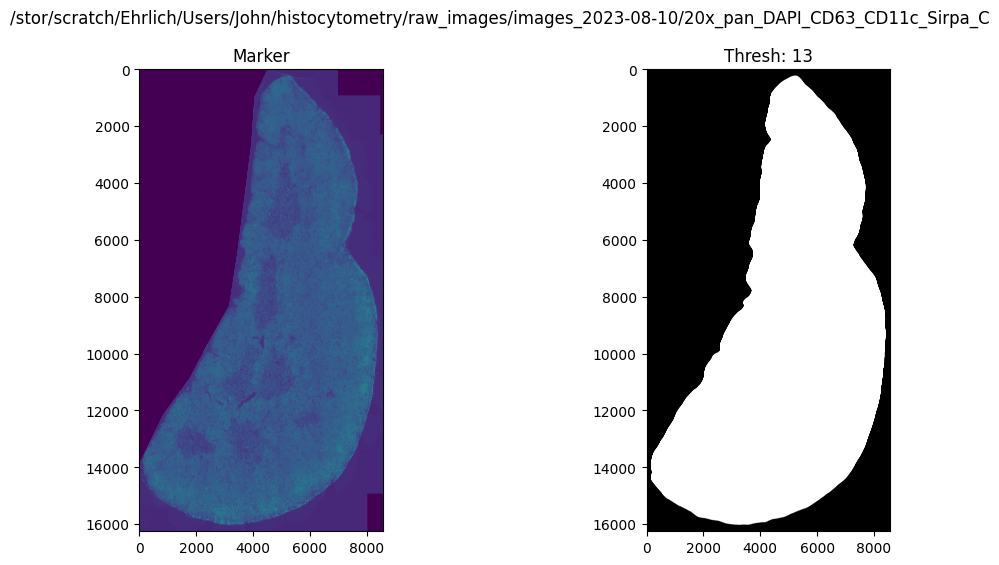

Starting plot


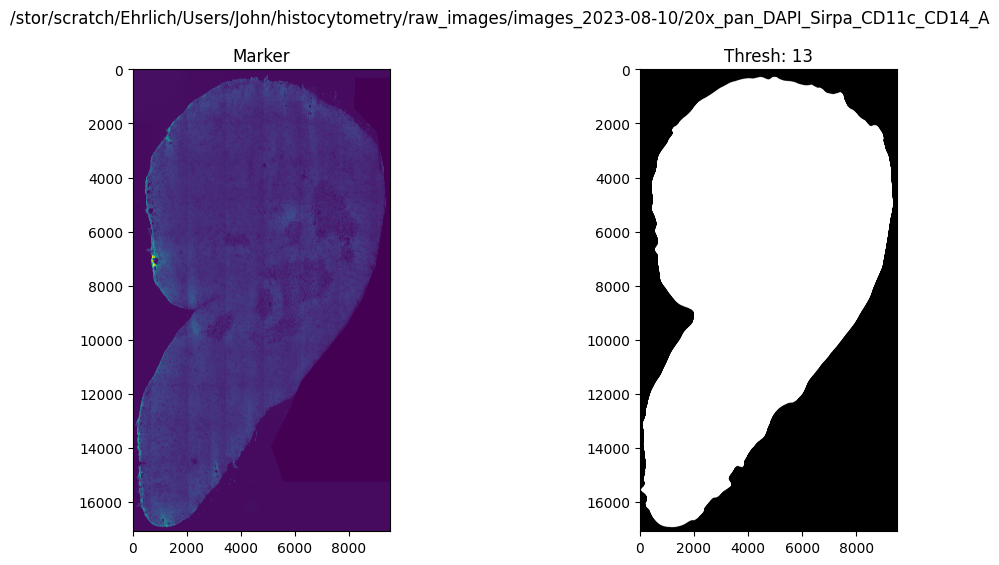

Starting plot
Starting plot
Starting plot


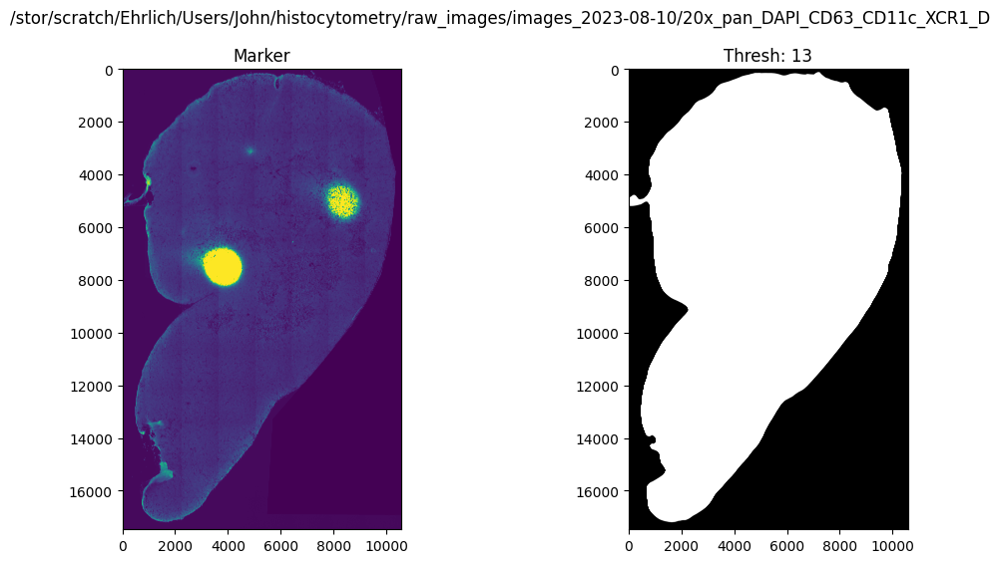

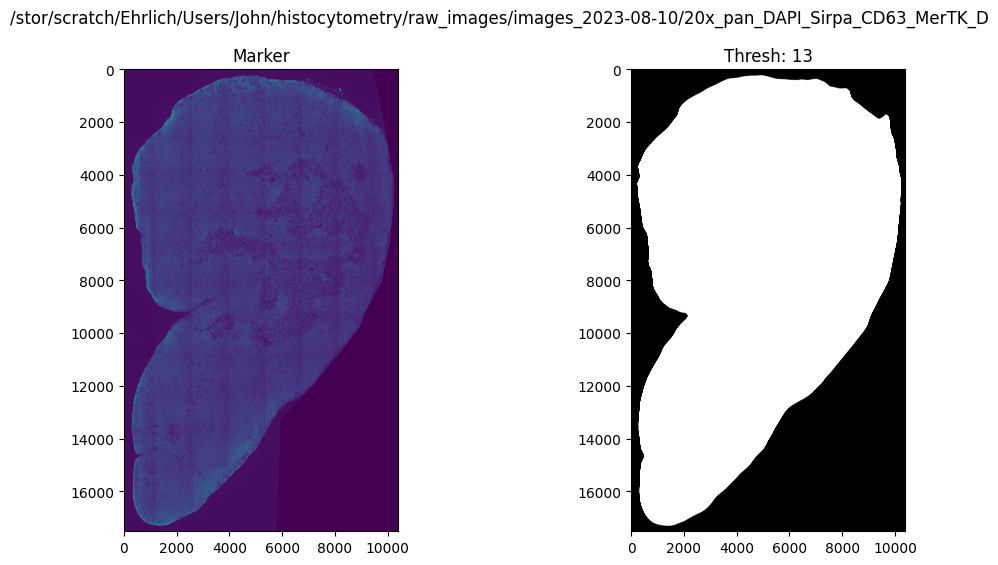

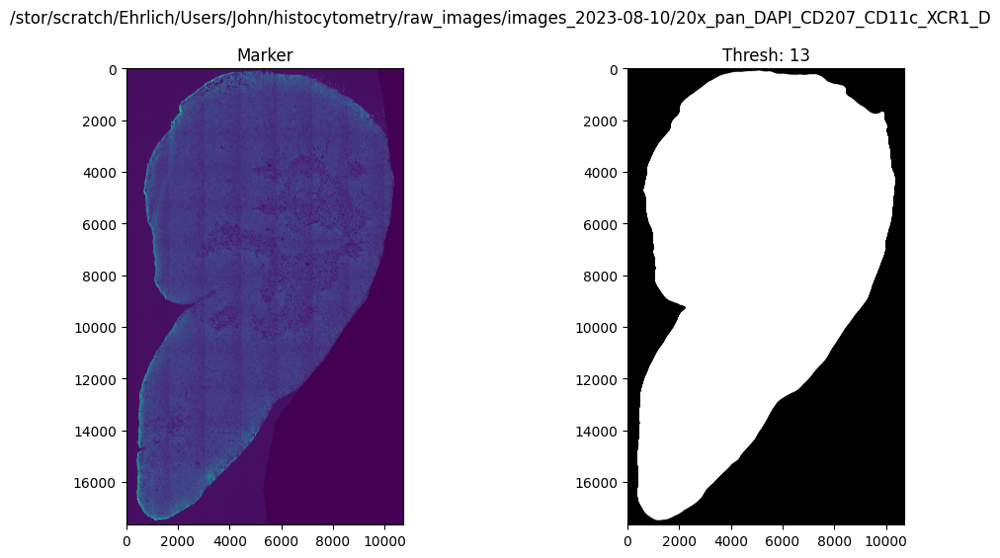

Starting plot
Starting plot
Starting plot
Starting plot


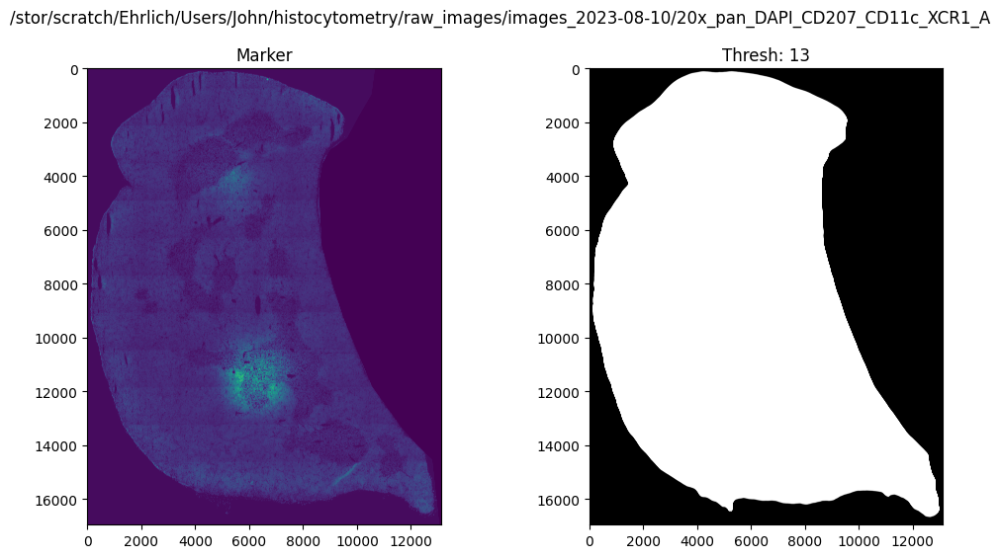

Starting plot


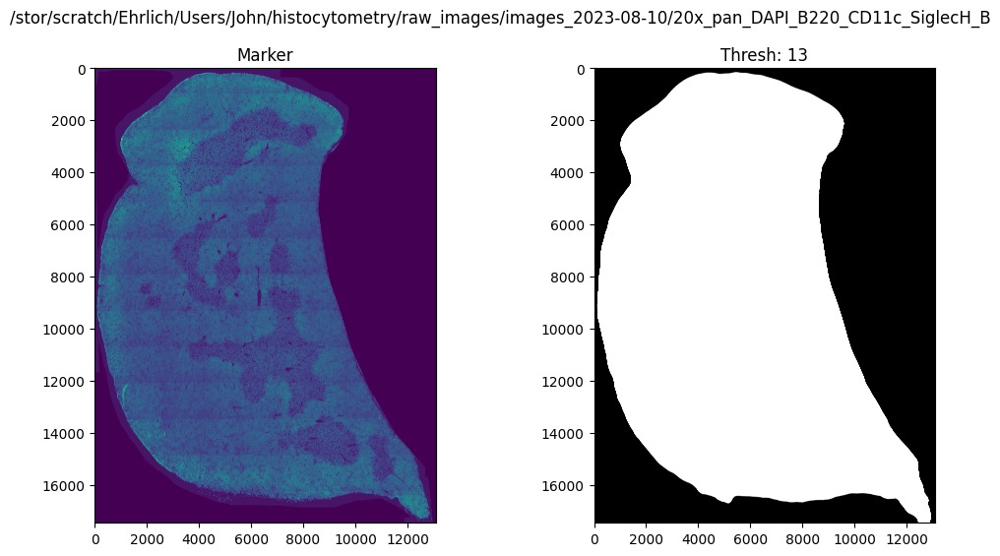

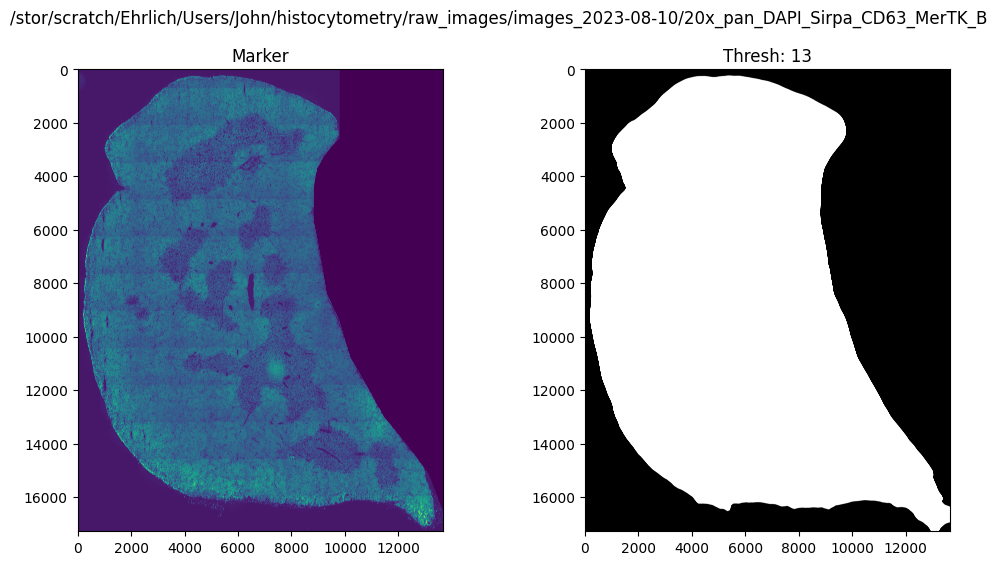

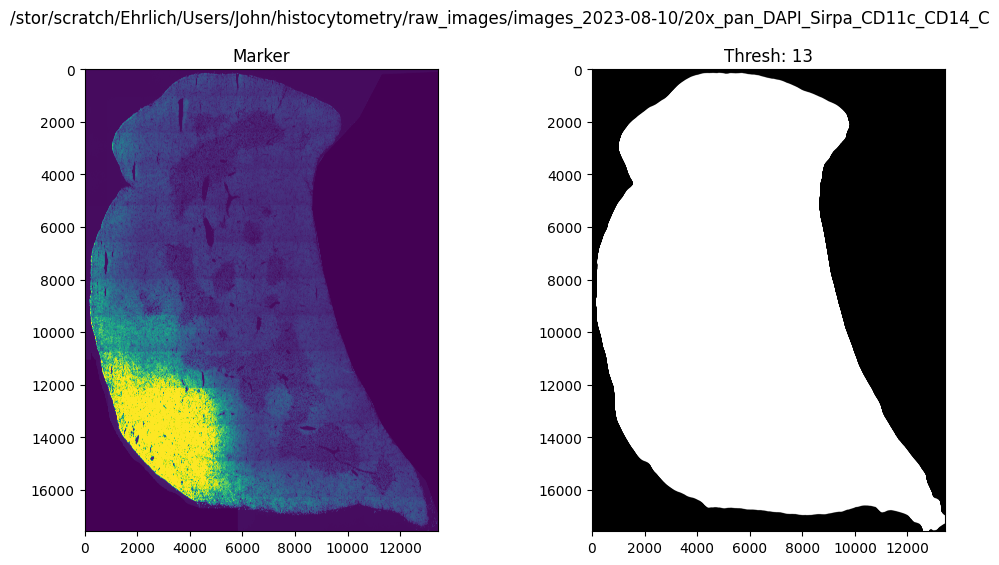

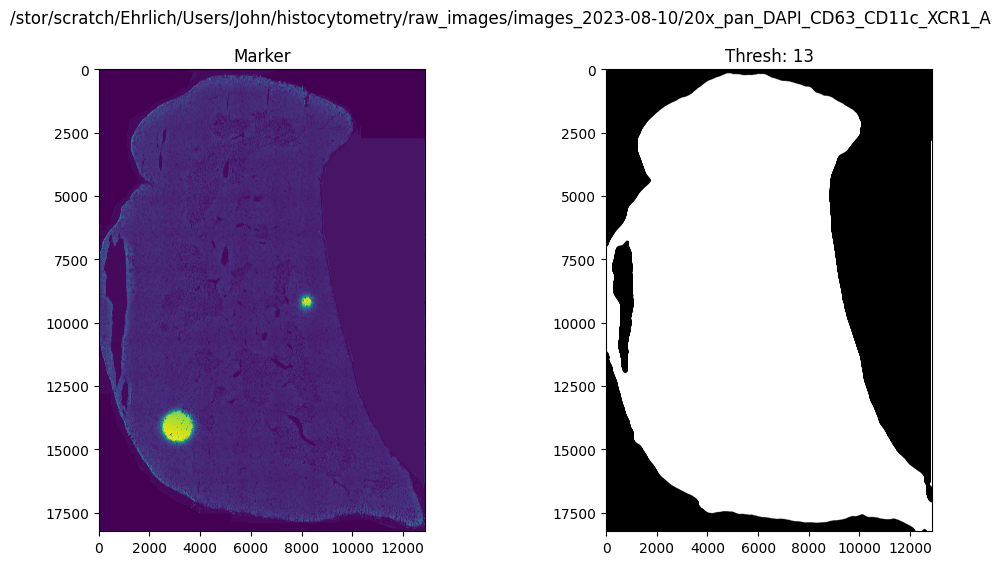

Starting plot
Starting plot
Starting plot
Starting plot
Starting plot


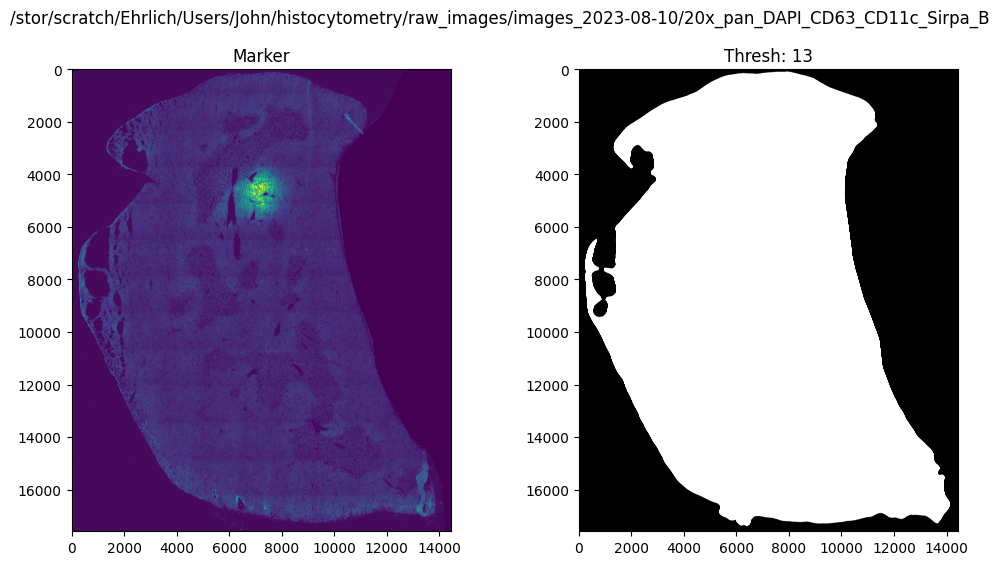

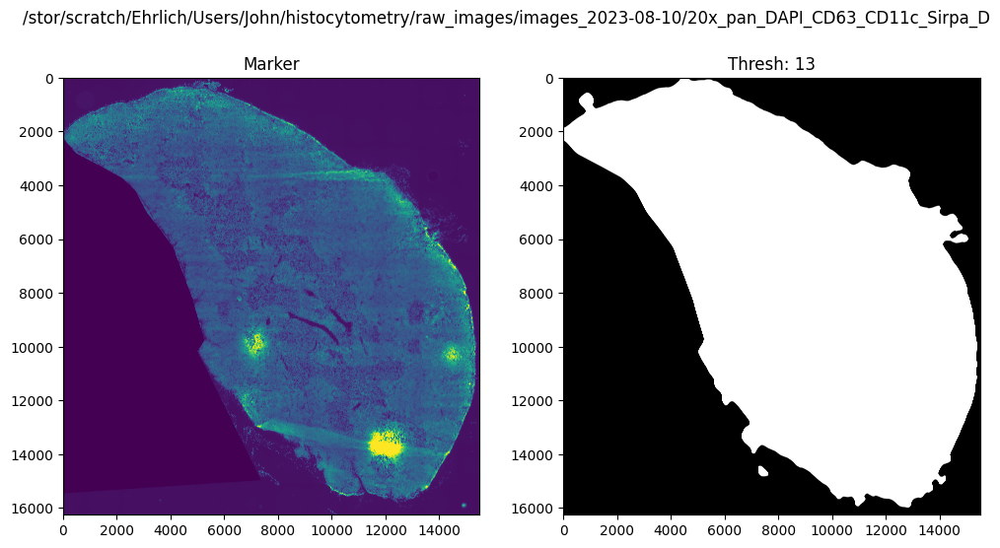

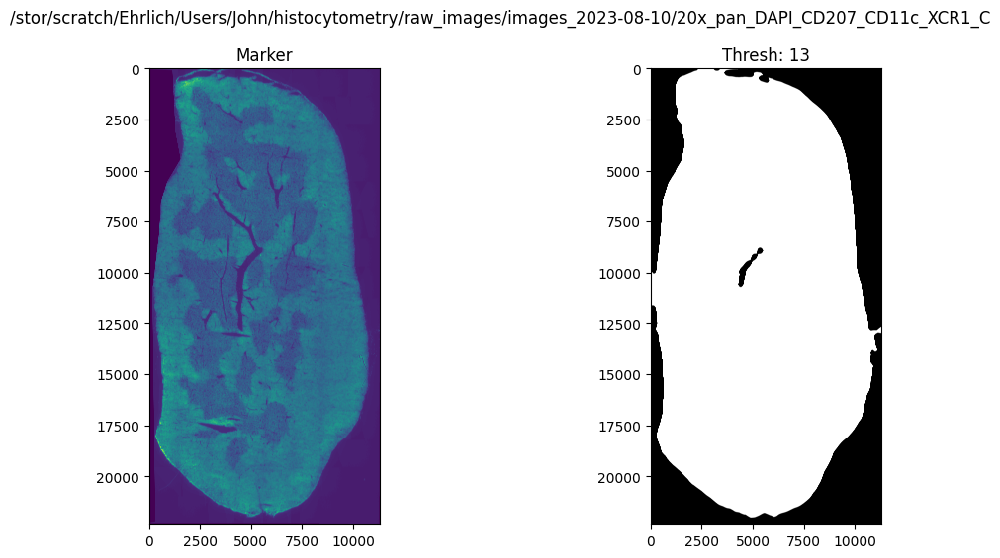

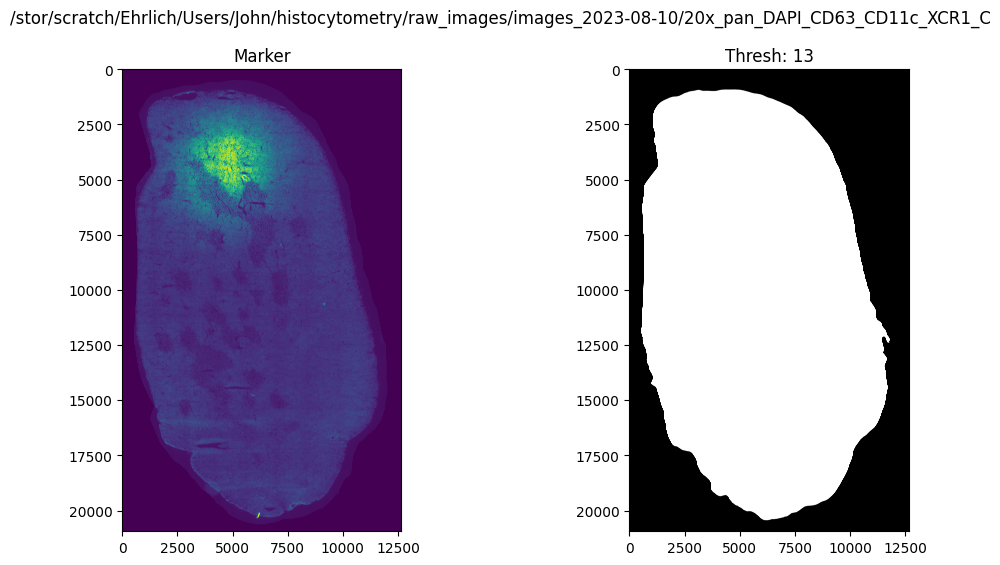

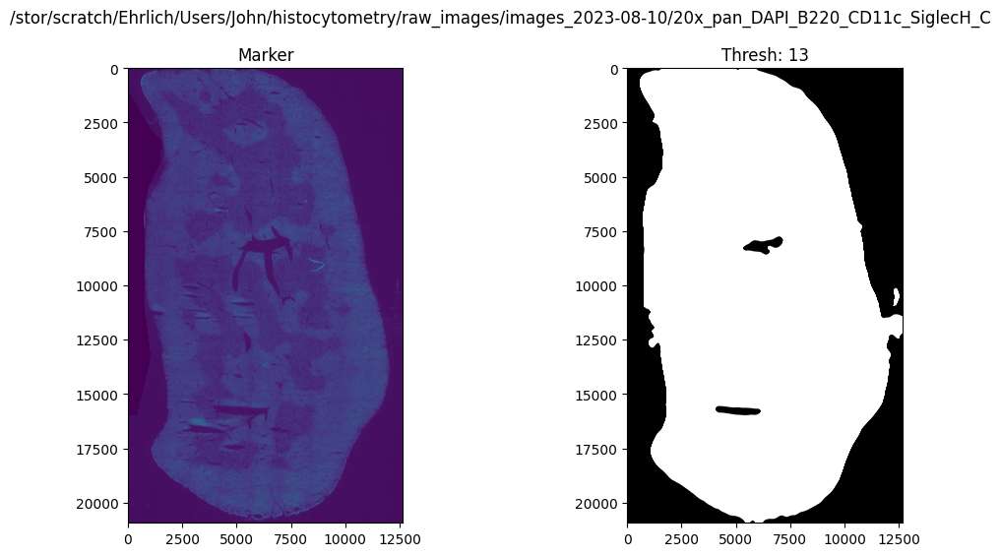

Starting plot


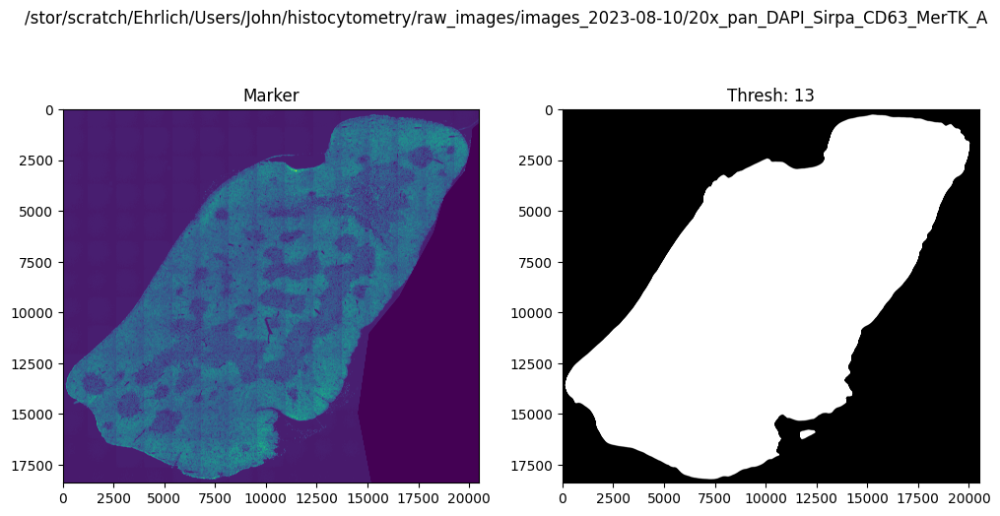

Starting plot
Starting plot


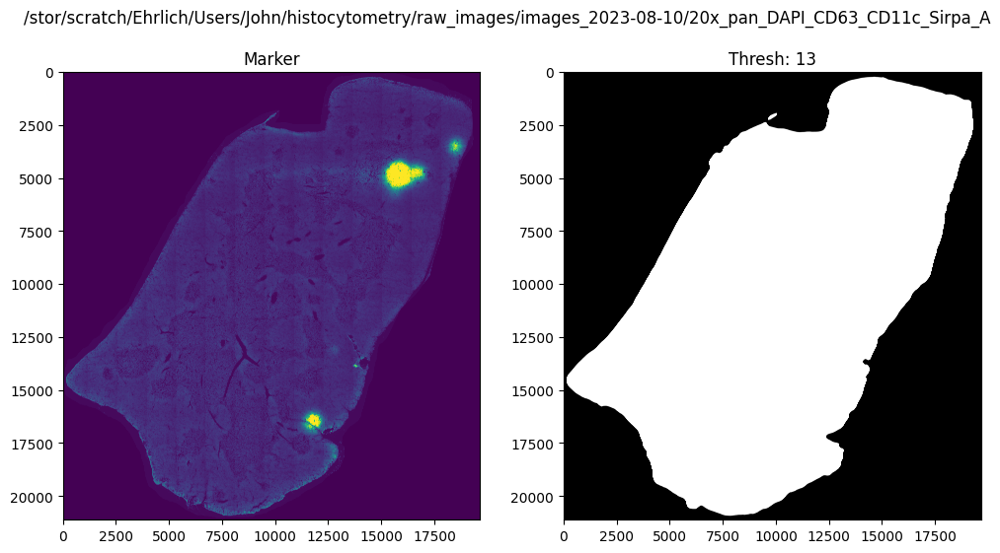

Starting plot
Starting plot
Starting plot


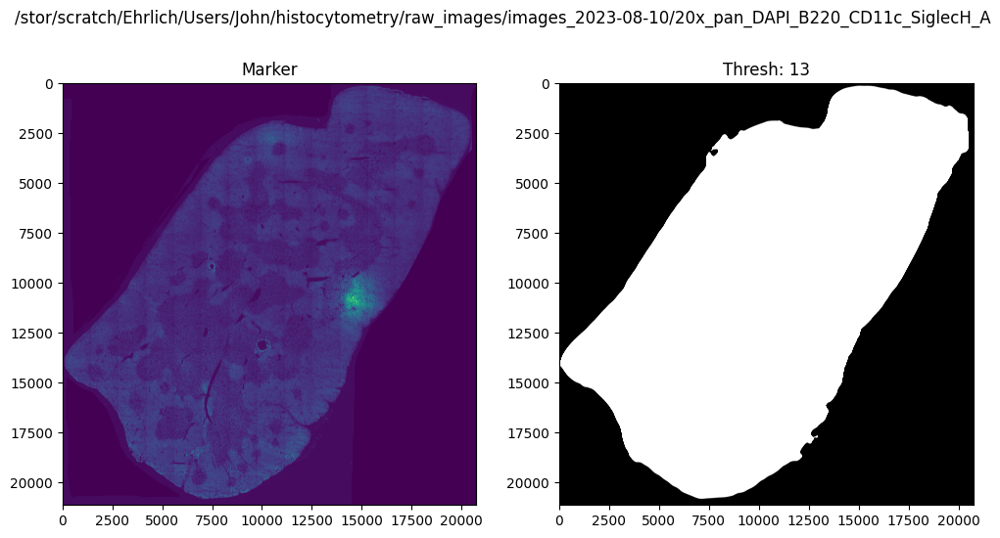

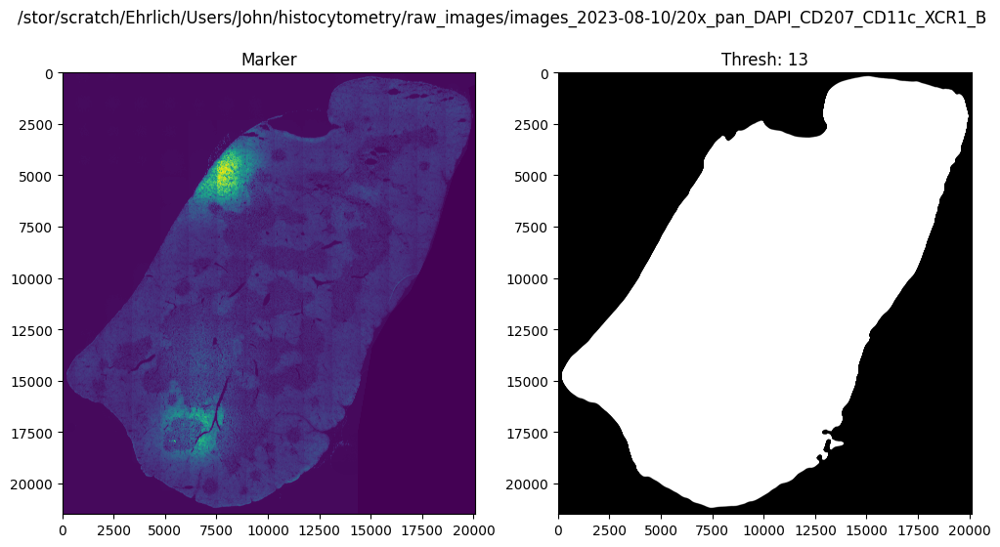

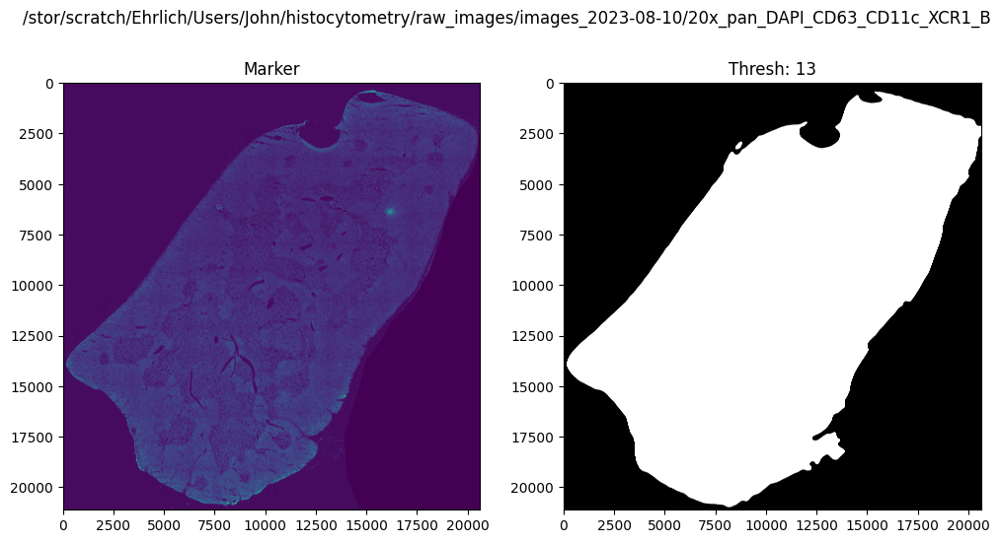

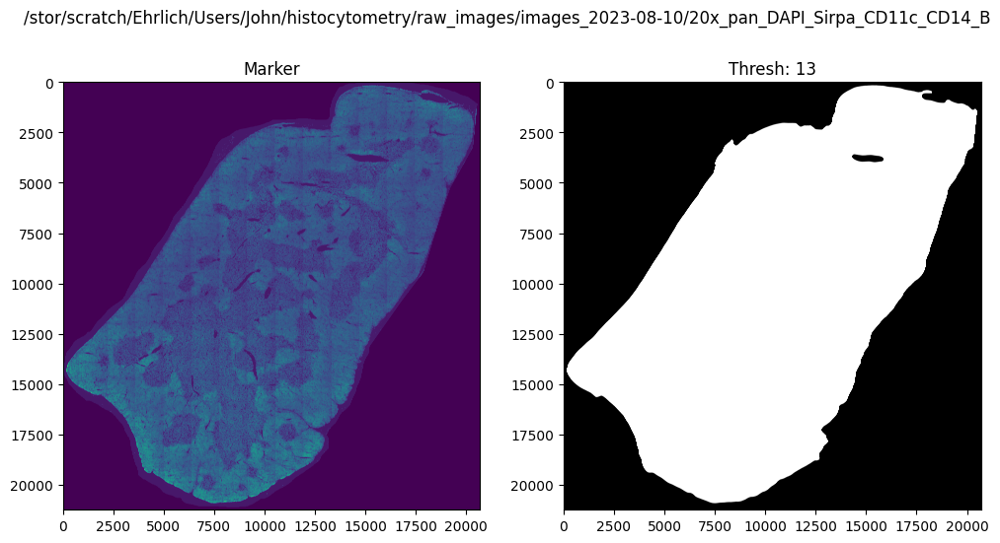

In [12]:
## This is what I used to generate the whole_lobe_mask.tif
## I followed this up with some manual filling of holes and removing artifacts.  
if False:
    raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
    img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir)]
    img_dirs.sort()

    thresholds = np.arange(13,14)

    parallelize_segmentation(
        img_dirs    = img_dirs, 
        thresholds  = thresholds, 
        channel_loc = 0, 
        glob_str    = "reordered_image.ome.tif",
        save_mask   = True,
        out_name    = "whole_lobe_mask.tif",
        morph_ksize = (201, 201) ## (75, 75), (201,201)
    )

Starting plot


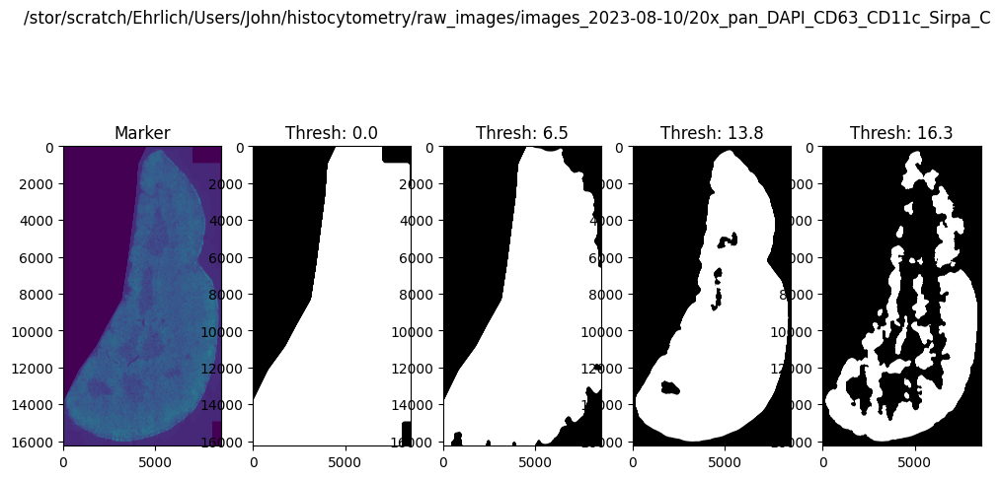

Starting plot
Starting plot


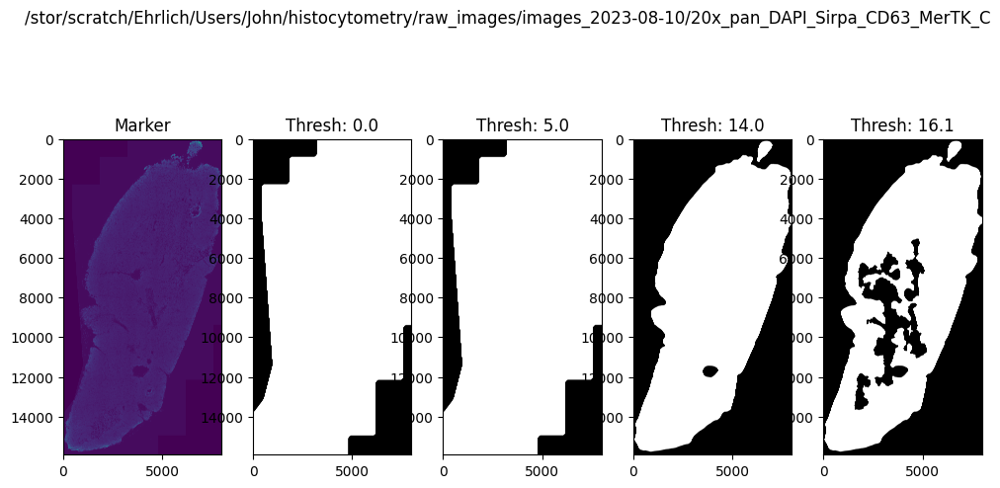

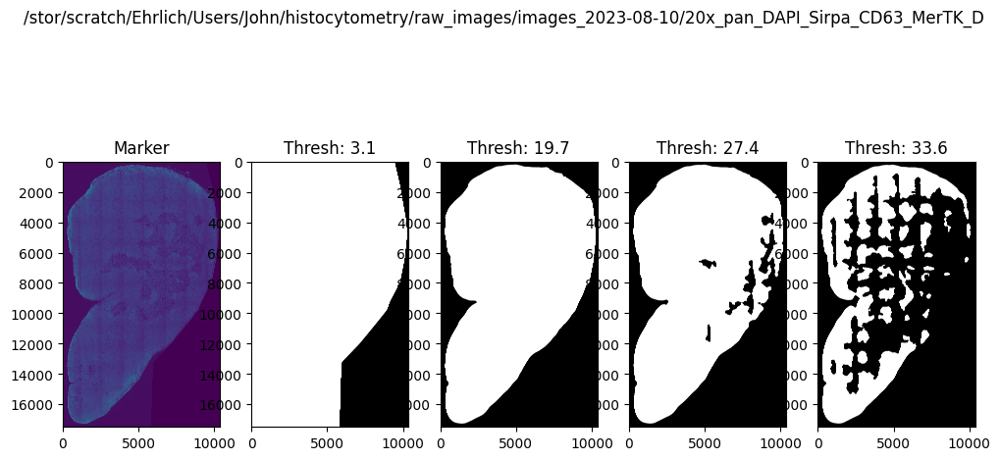

Starting plot
Starting plot
Starting plot


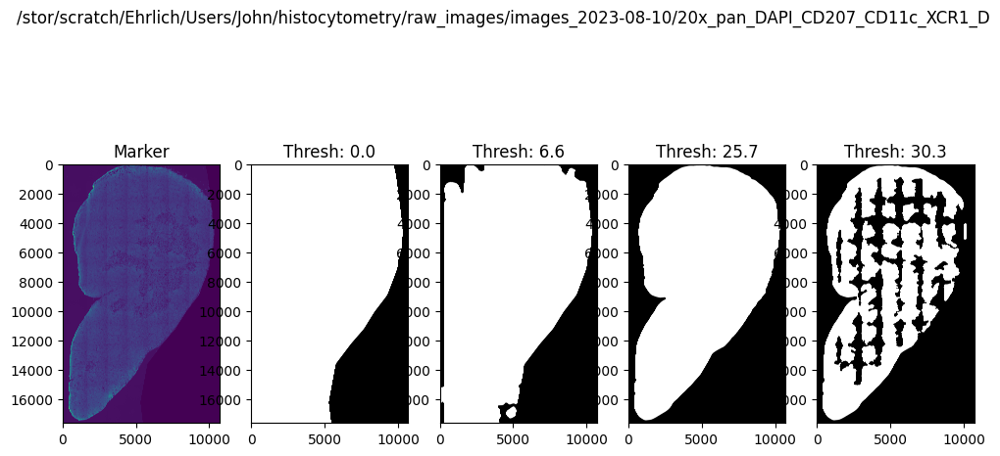

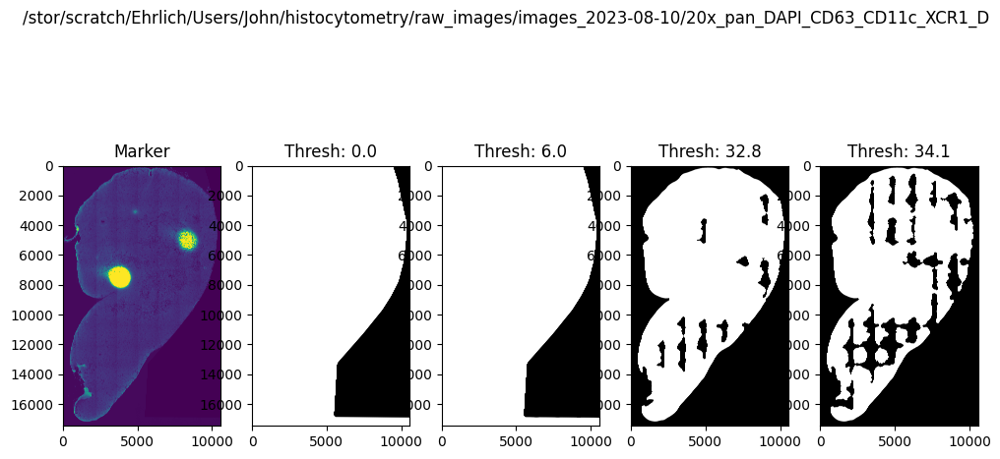

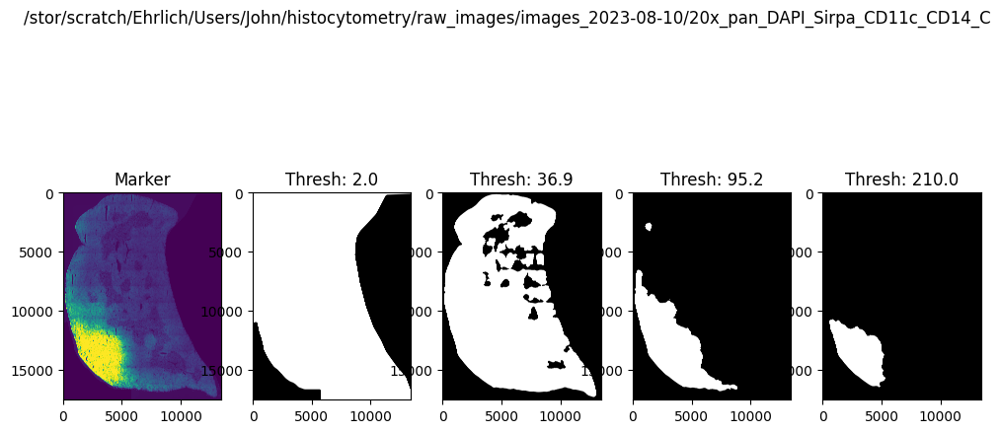

Starting plot
Starting plot
Starting plot
Starting plot


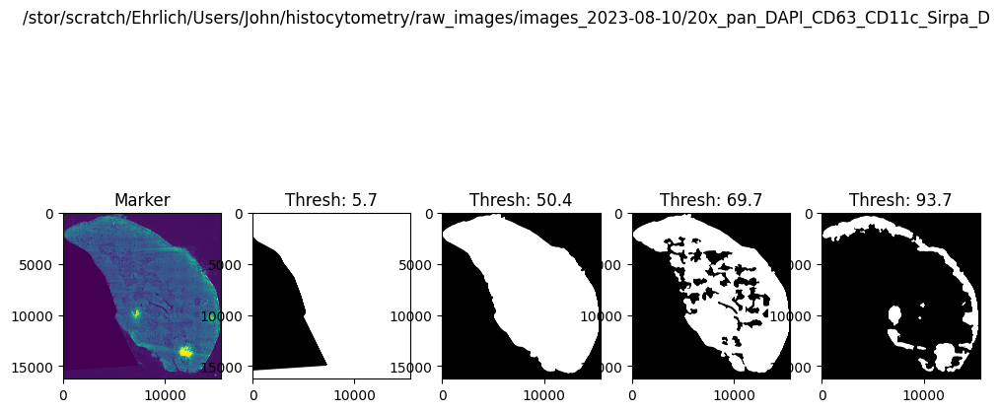

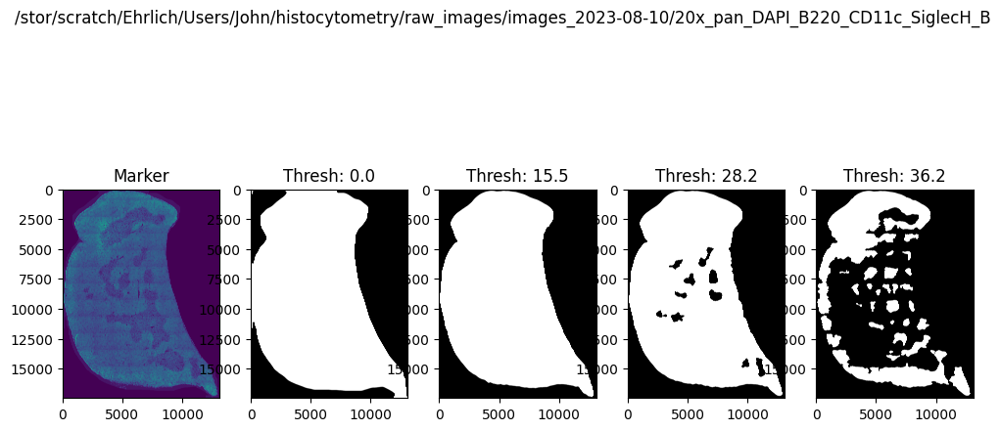

Starting plot
Starting plot
Starting plot


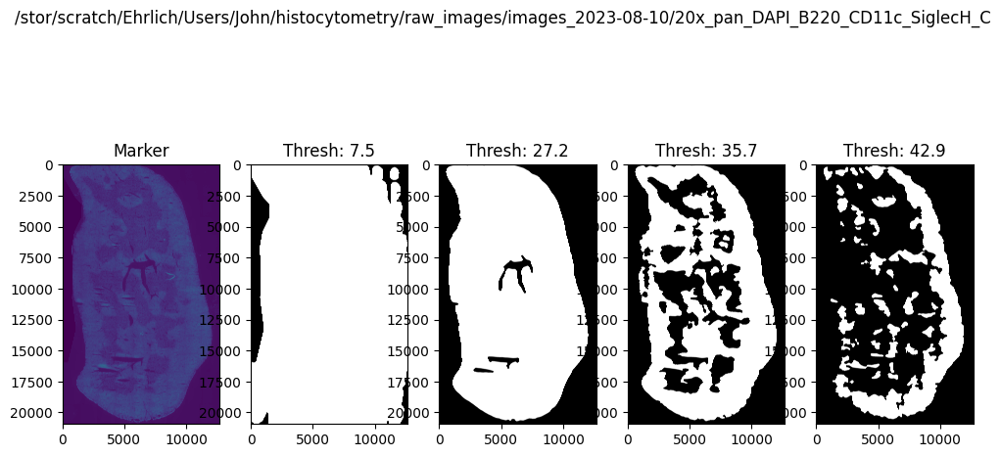

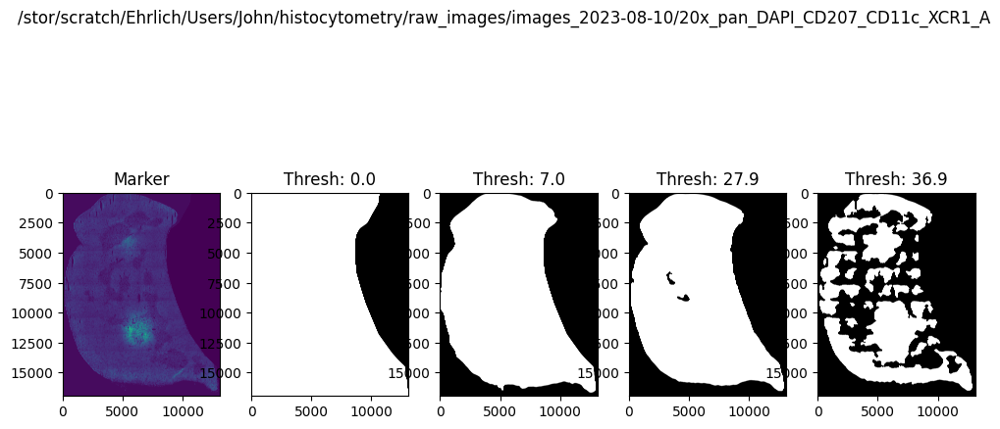

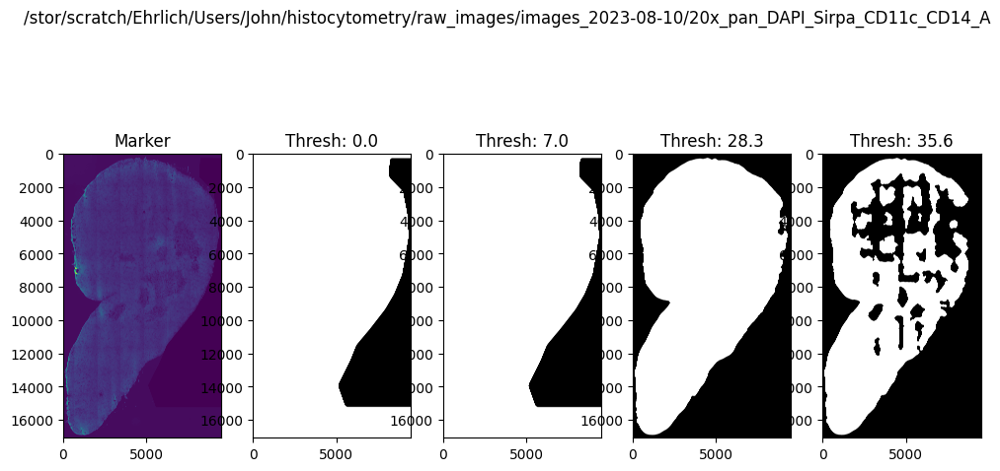

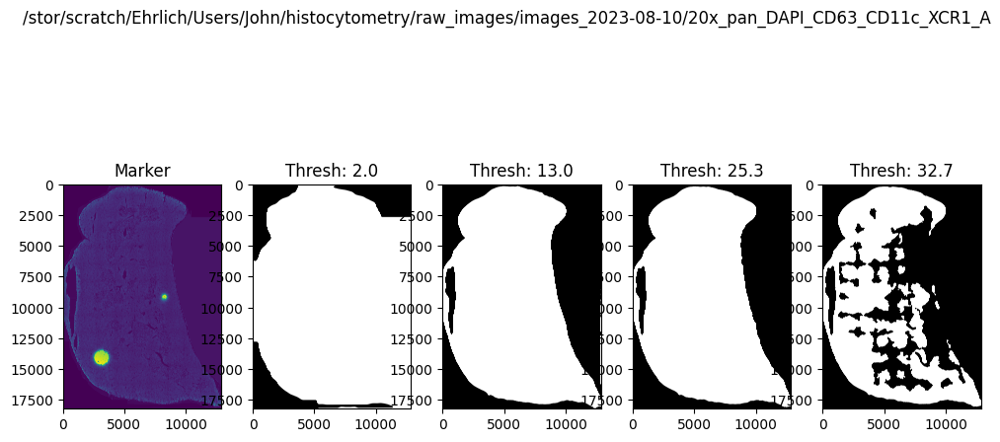

Starting plot


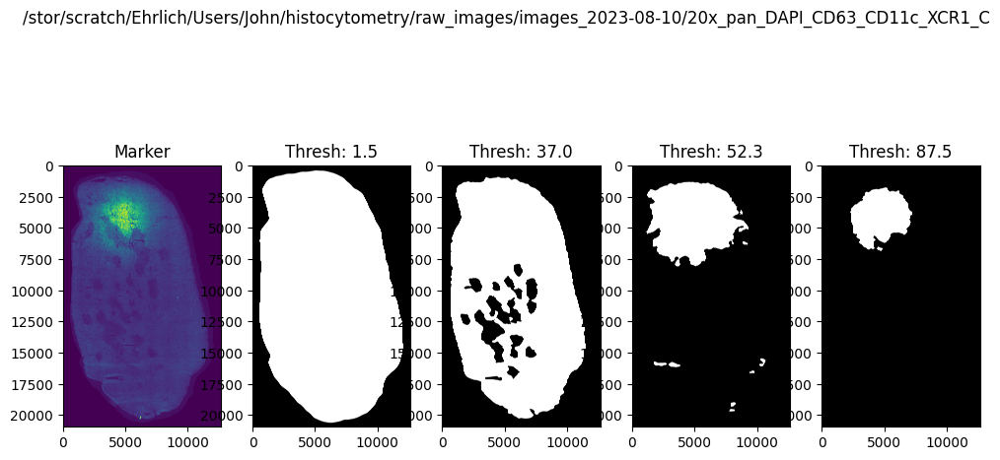

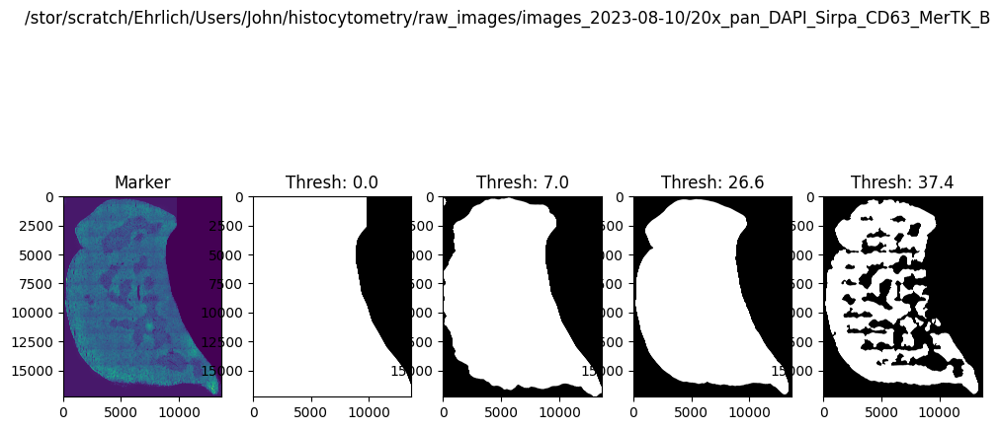

Starting plot
Starting plot


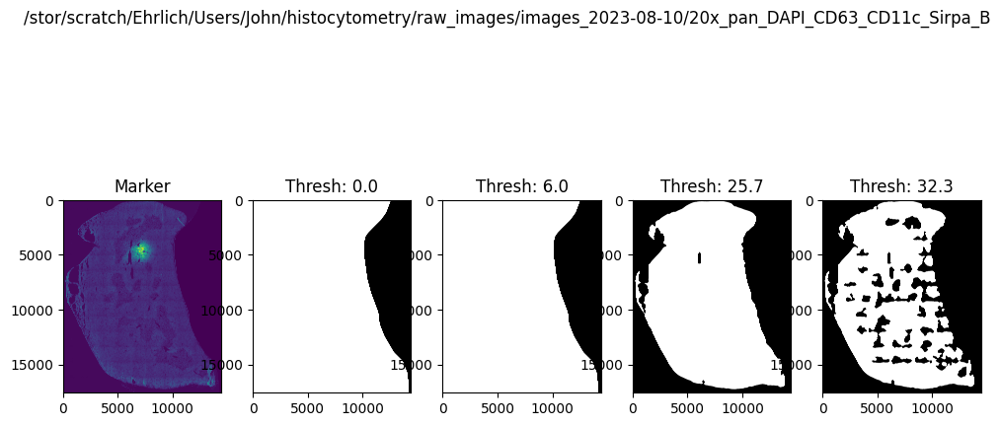

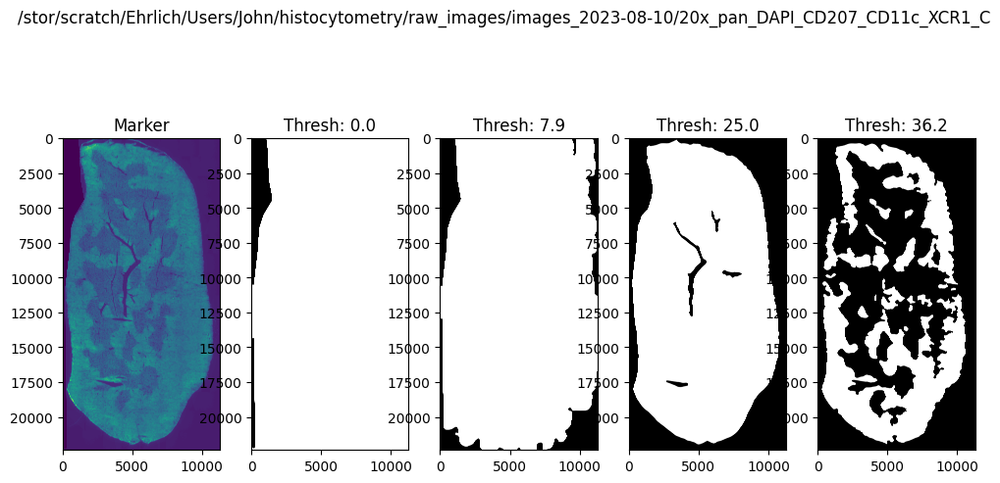

KeyboardInterrupt: 

Starting plot


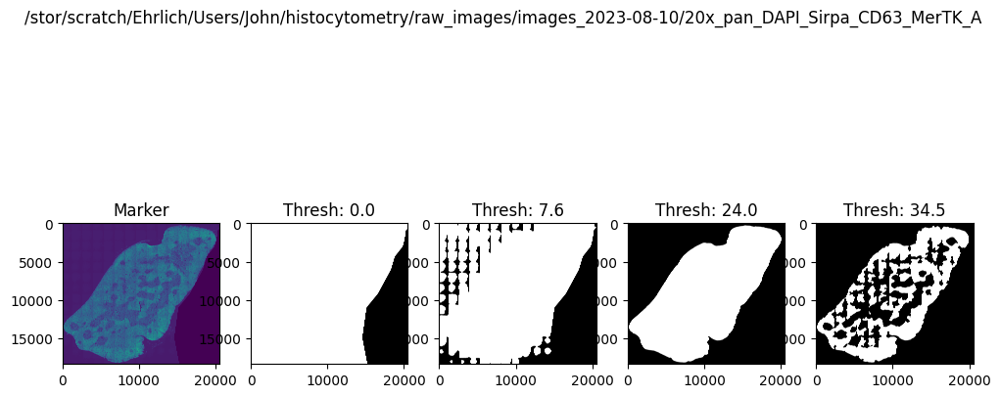

Starting plot


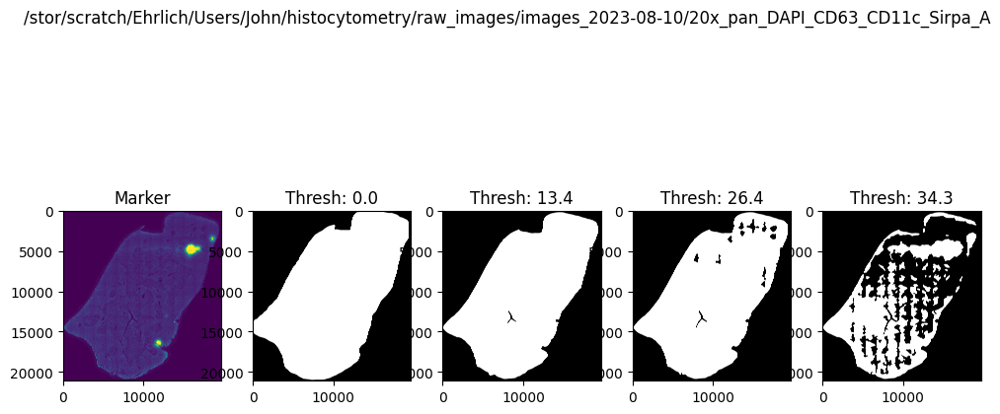

Starting plot


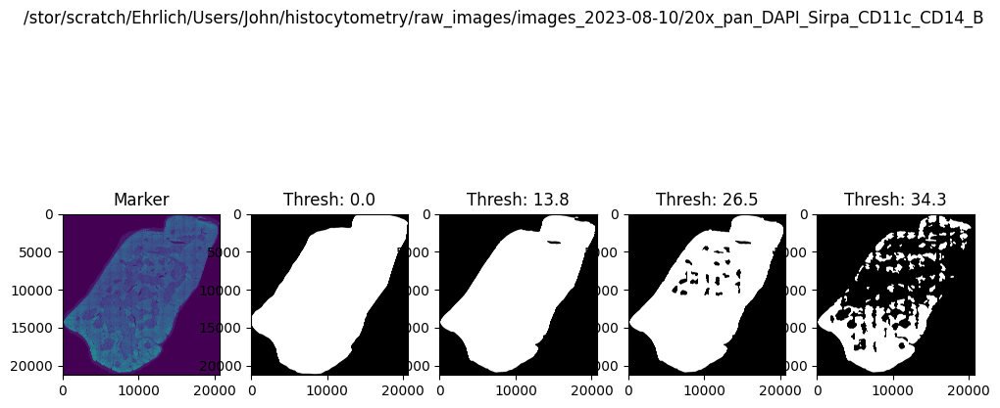

Starting plot
Starting plot


In [17]:
# raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
# img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]", img_dir)]
# img_dirs.sort()

# parallelize_medulla(
#     img_dirs                 = img_dirs, 
#     medullary_threshold_rank = 1, 
#     save_mask                = False, 
#     channel_loc              = 0, 
#     n_gaussians              = 4, 
#     normalize                = False
# )

## Am I doing it with the first gaussian? 

Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
Starting /stor/scratch/Ehrlich/Users/John/histocyt

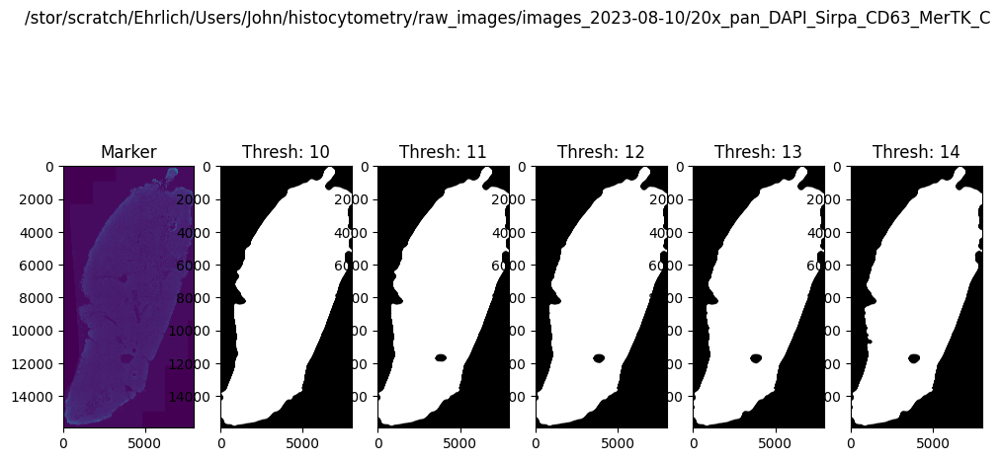

Starting plot


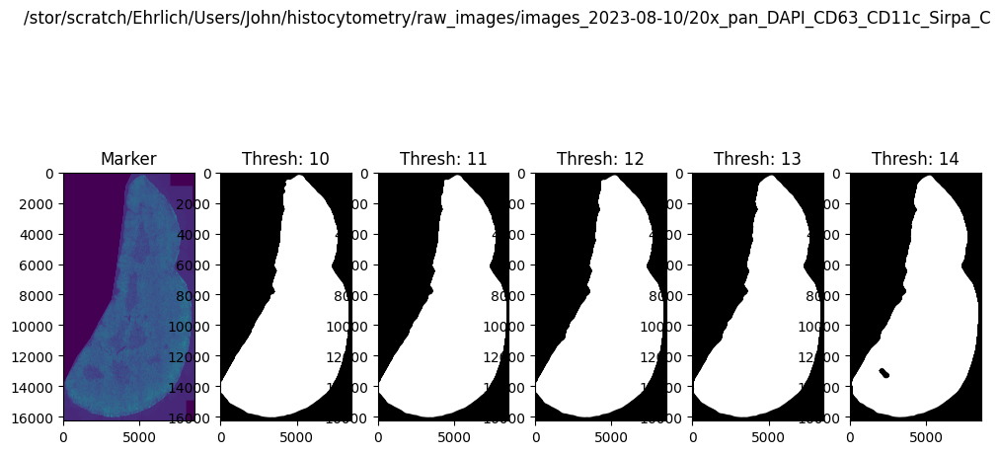

Starting plot


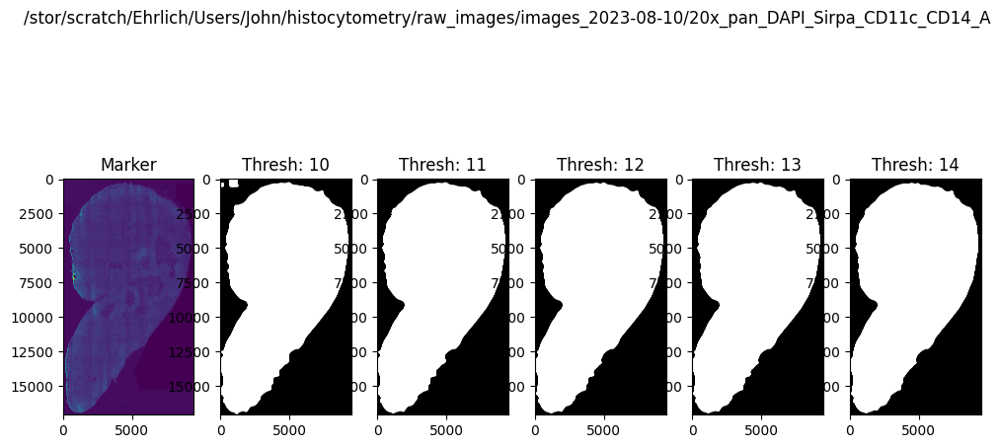

Starting plot


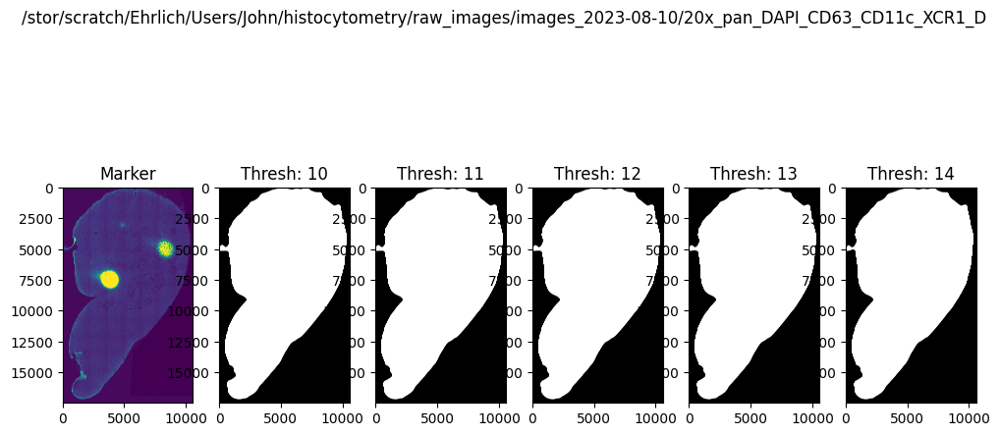

Starting plot


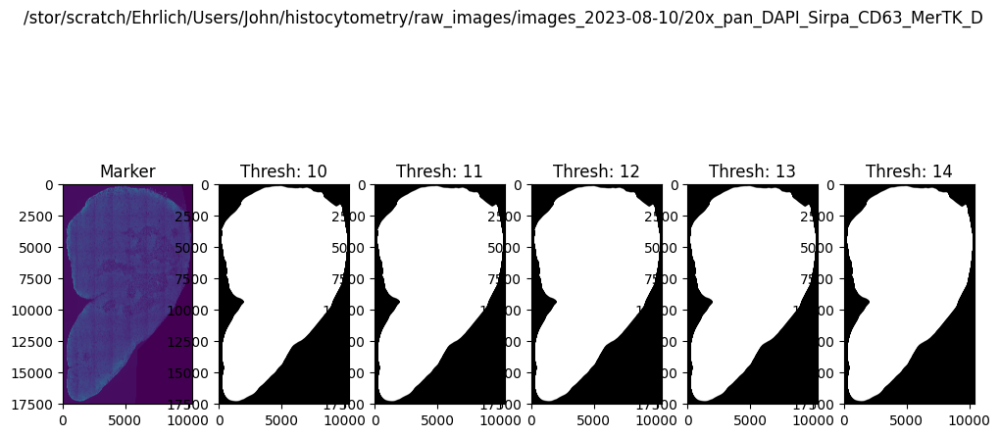

Starting plot


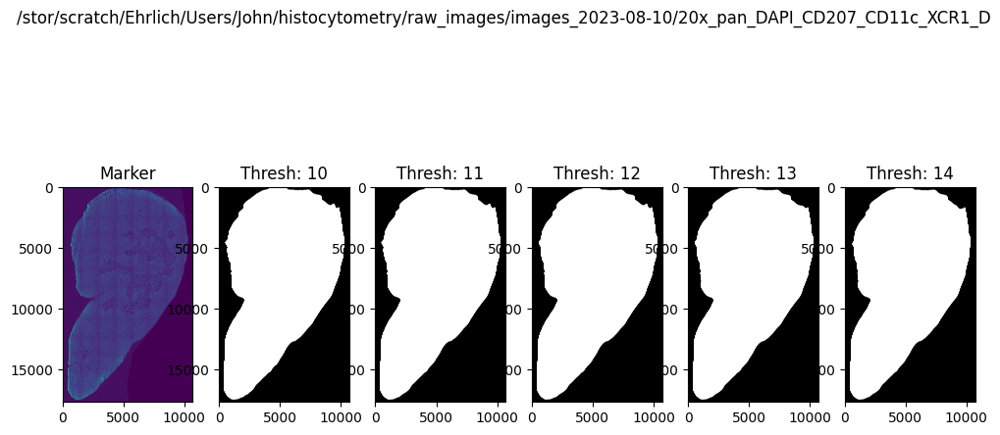

Starting plot


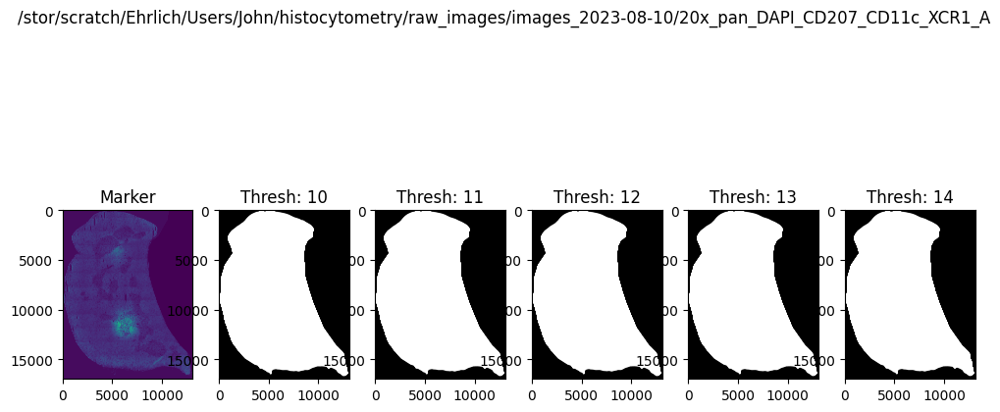

Starting plot
Starting plot


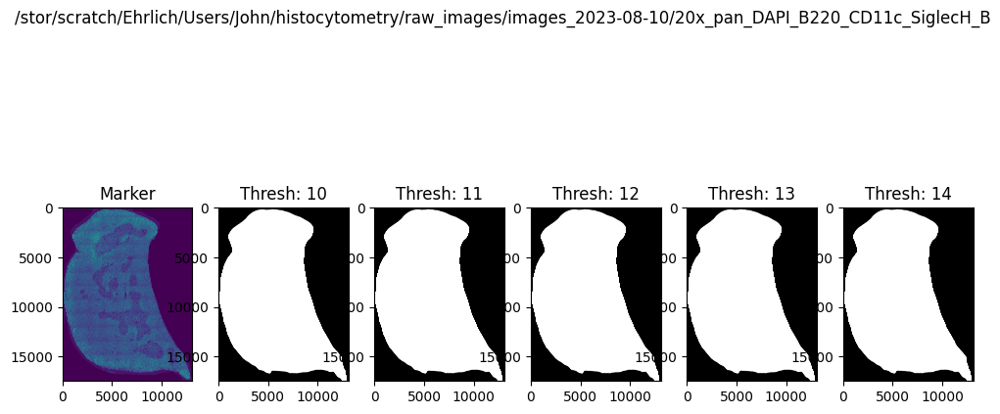

Starting plot


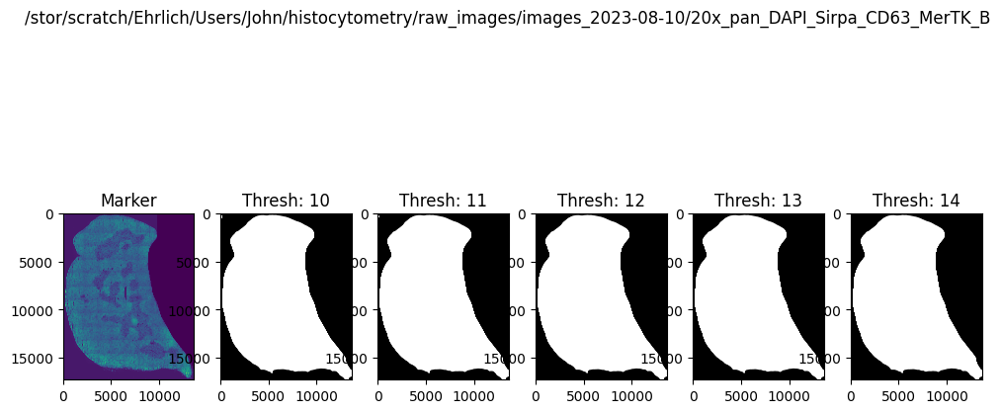

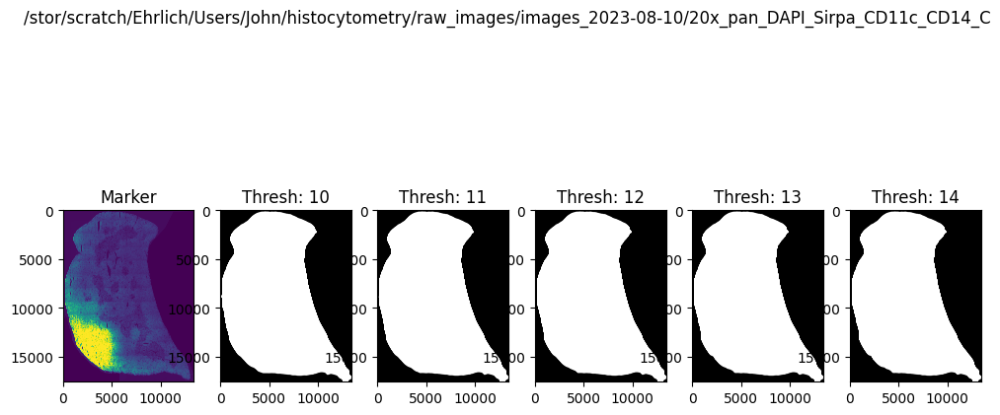

Starting plot


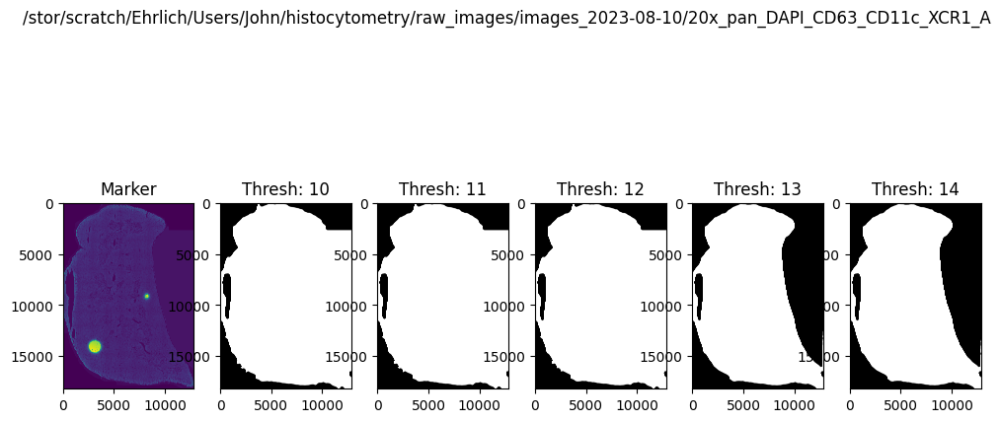

Starting plot


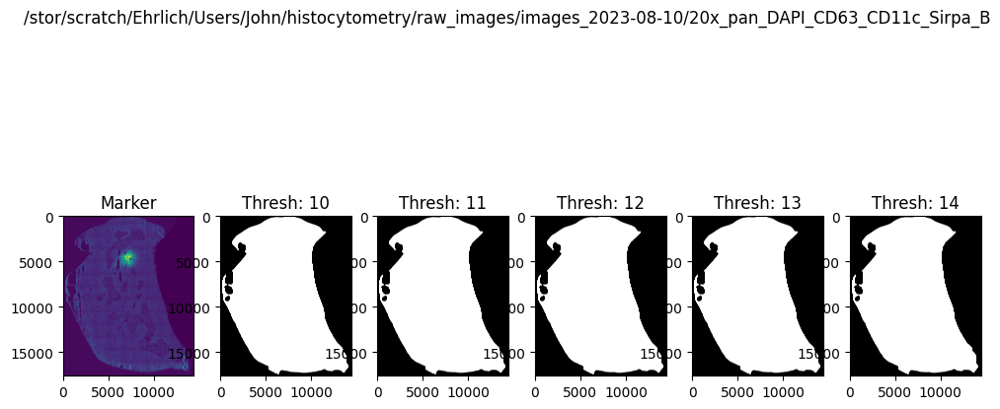

Starting plot


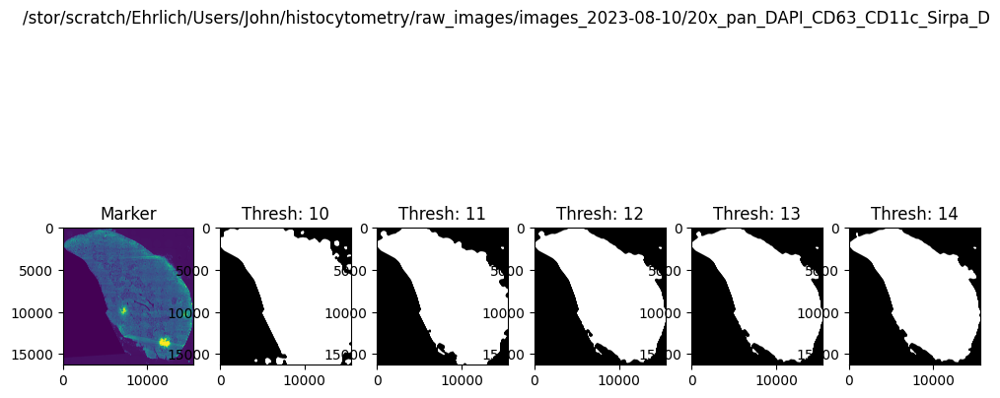

Starting plot


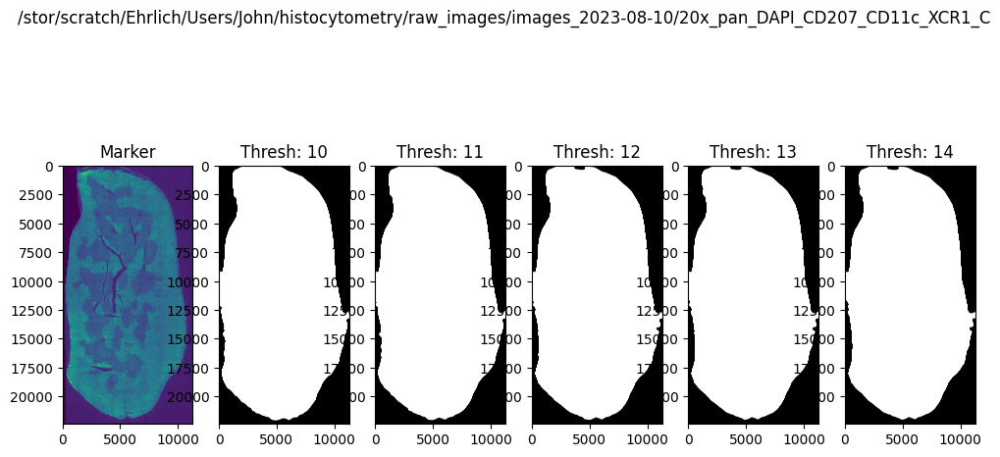

Starting plot


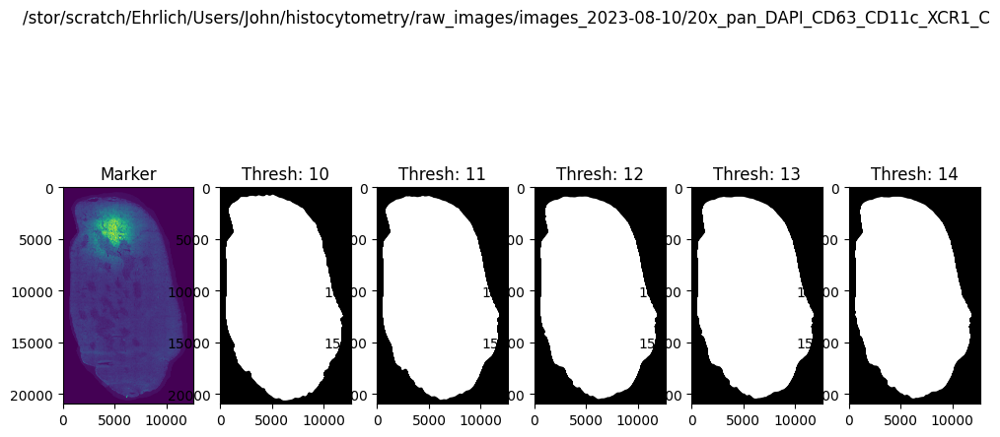

Starting plot


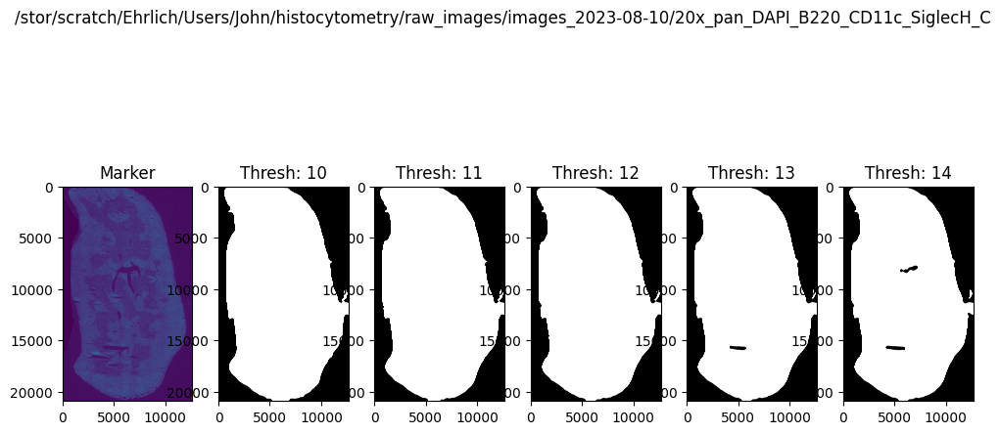

KeyboardInterrupt: 

In [55]:
if False:
    raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
    img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]", img_dir)]
    img_dirs.sort()

    thresholds = np.arange(10,15)

    parallelize_segmentation(
        img_dirs    = img_dirs, 
        thresholds  = thresholds, 
        channel_loc = 0, 
        glob_str    = "reordered_image.ome.tif",
        save_mask   = False,
        out_name    = "whole_lobe_mask.tif",
        morph_ksize = (301, 301) ## (75, 75), (201,201)
            ## I need to try (250, 250) instead, but I can live with (201, 201) over (301, 301)
    )

## Normalized data looks bad, don't use it for whole lobe. 
    
## I'll re-run this to save the masks. I can leave the axis titles on. I don't cause an issue unless there are too many thresholds.
## MerTK_C and Sirpa_C have the lowest DAPI signal, so I had to lower the threshold to work for them. 
## 23 looks great for the rest of them. 
## Maybe an even lower threshold would work for MerTK_C and Sirpa_C as well as the rest of them. 

## There are a couple of images that can be removed if they don't get nice pretty whole lobes. 

## Medullary thresholding

Doing whole number thresholds across different images doesn't look great. 

I'm going to stick with the slow GMM. 

In my notes, I have all markers as going with M4. Is this correct? 

In [ ]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs= [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir)]
M3_dirs= ["20x_pan_DAPI_CD207_CD11c_XCR1_C", "20x_pan_DAPI_CD207_CD11c_XCR1_D", "20x_pan_DAPI_B220_CD11c_SiglecH_C", "20x_pan_DAPI_CD63_CD11c_Sirpa_B"]
CD14_dirs = [img_dir for img_dir in os.listdir(raw_dir) if re.search("CD14_[A-D]$", img_dir)]
CD14_dirs.sort()
M4_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]", img_dir) and img_dir not in M3_dirs and img_dir not in CD14_dirs]
M4_dirs.sort()

CD14_dirs = [os.path.join(raw_dir, img_dir) for img_dir in CD14_dirs]
M3_dirs= [os.path.join(raw_dir, img_dir) for img_dir in M3_dirs]

img_dict = {
    "M4" : M4_dirs,
    "M3" : M3_dirs
}

Starting plot


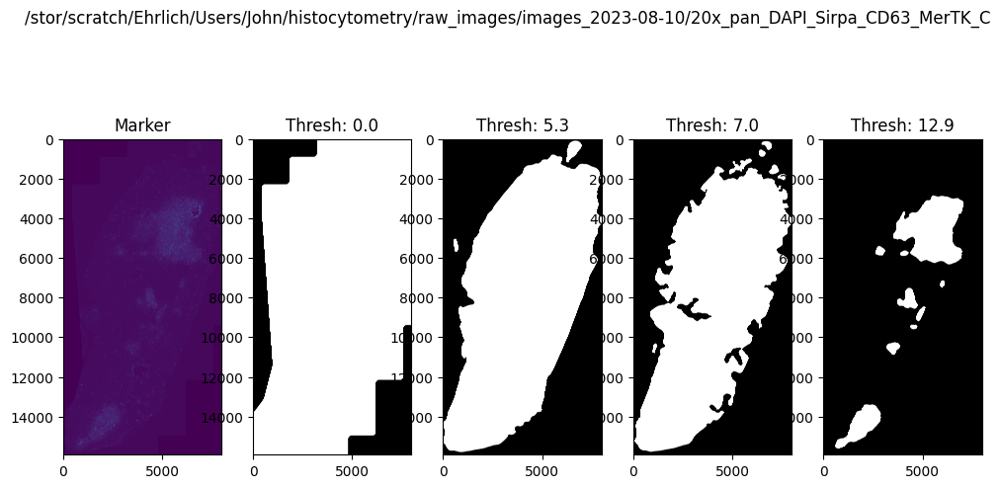

Starting plot


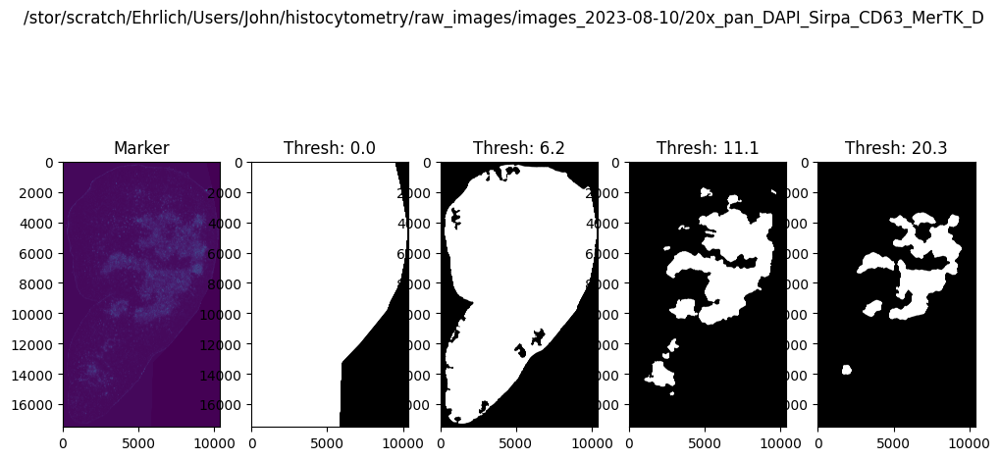

Starting plot
Starting plot


Starting plot


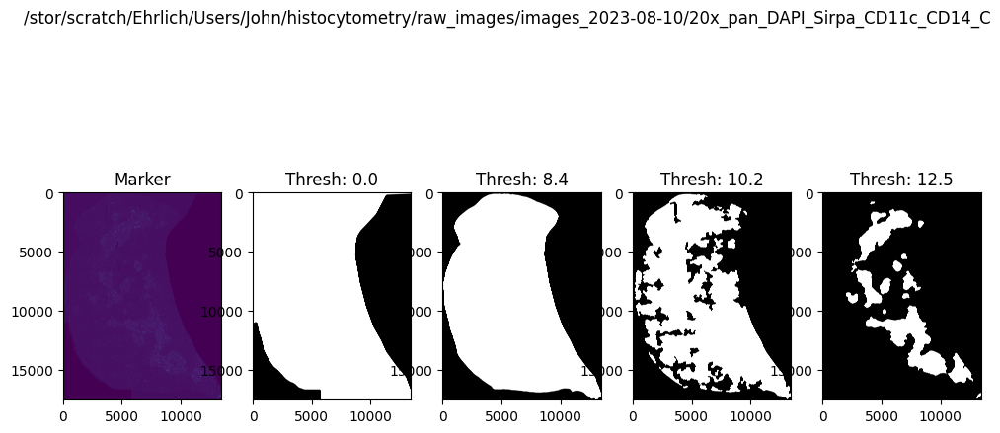

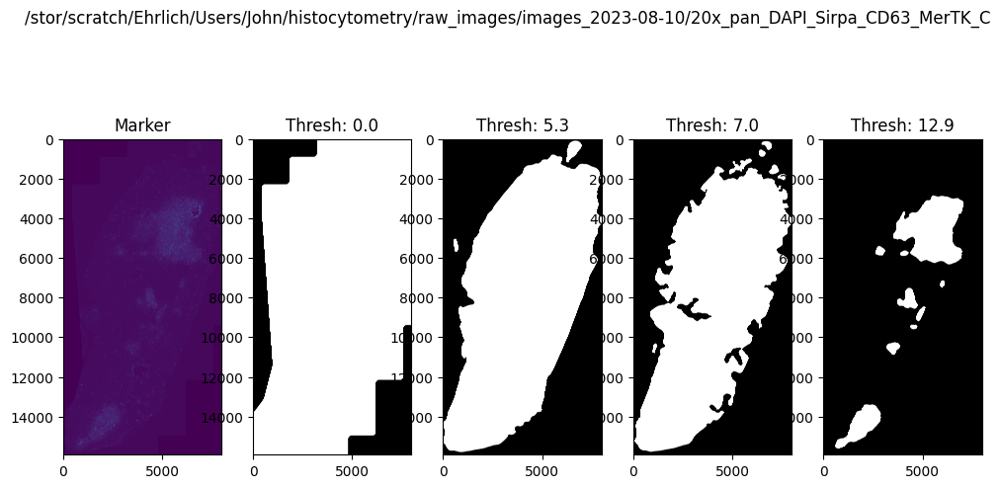

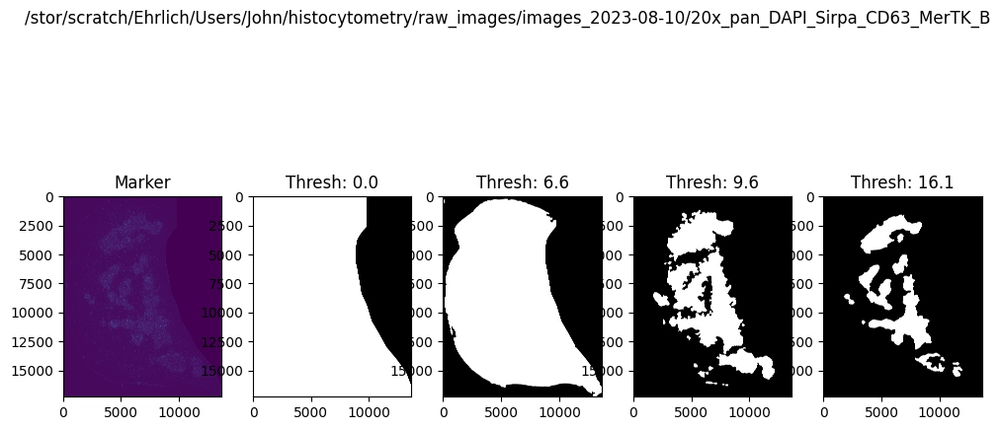

Starting plot


Starting plot


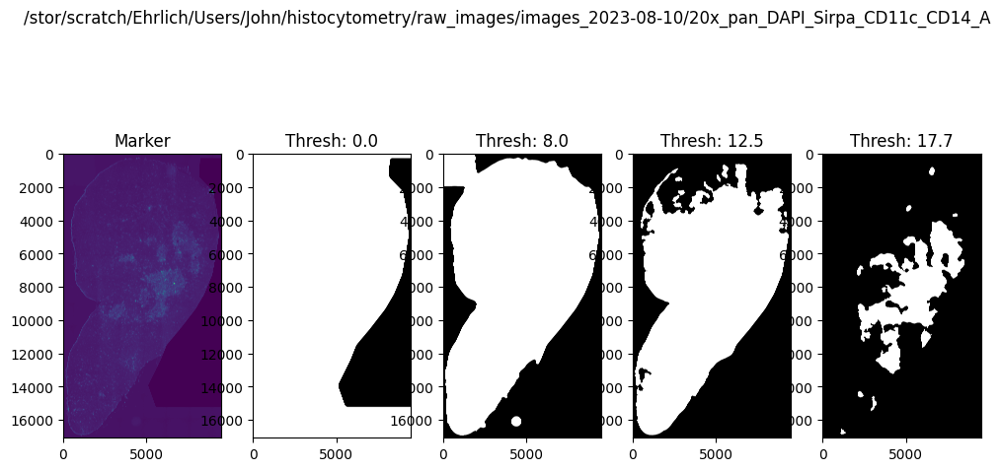

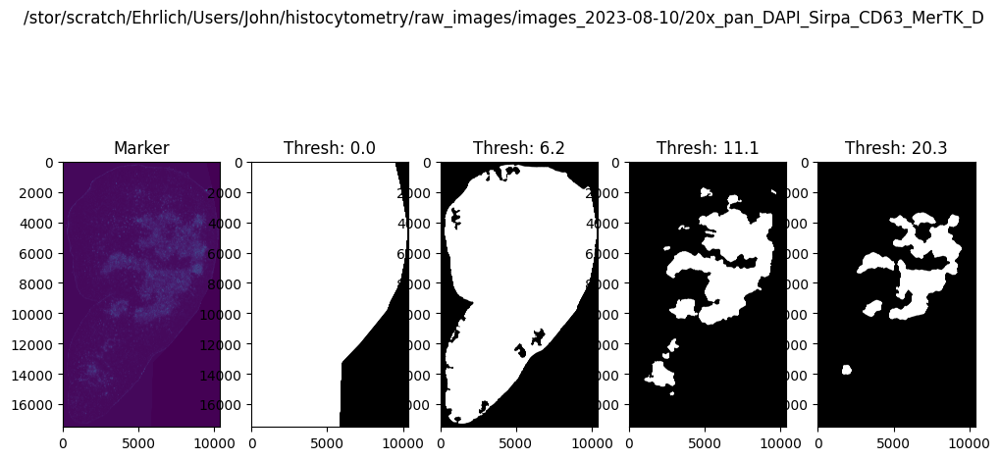

Starting plot
Starting plot


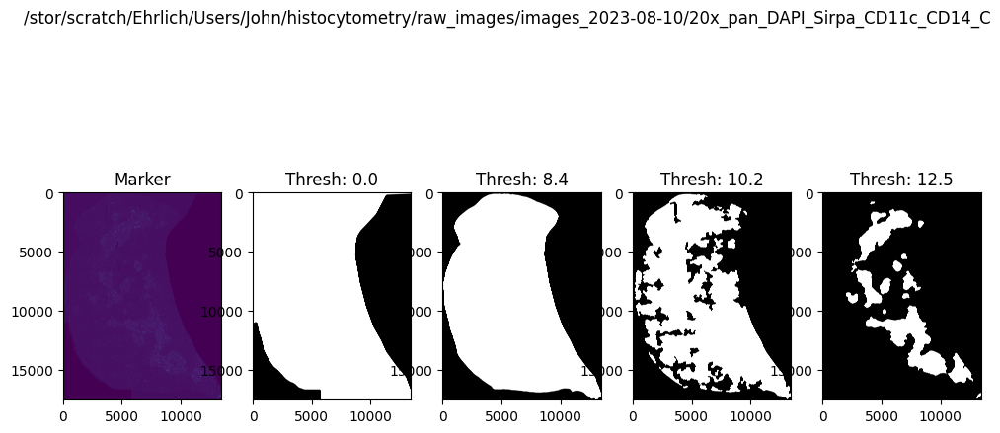

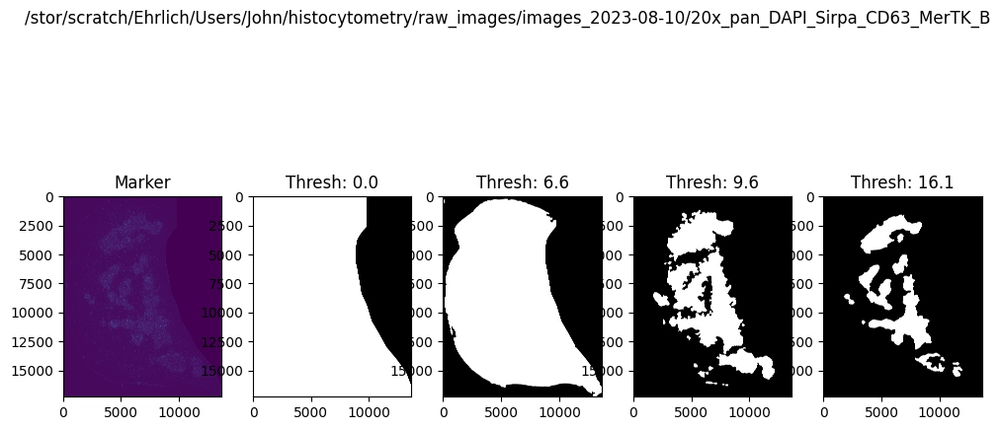

Starting plot


Starting plot


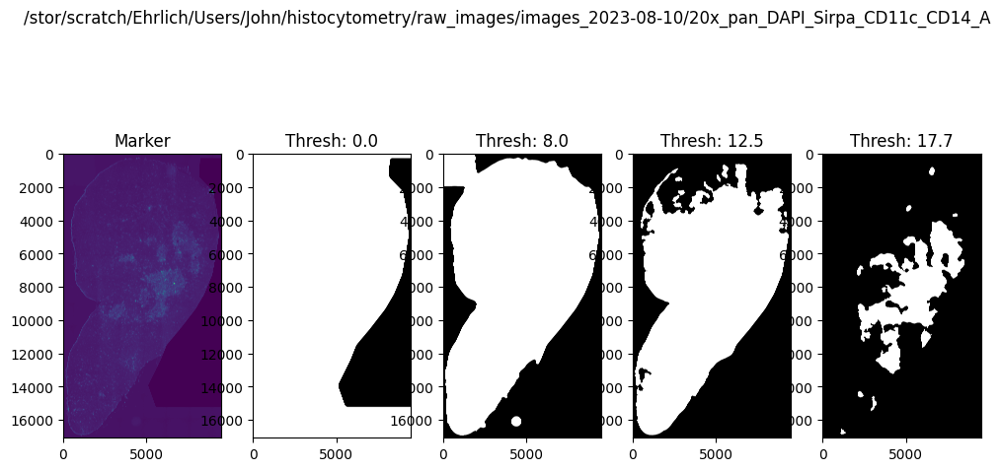

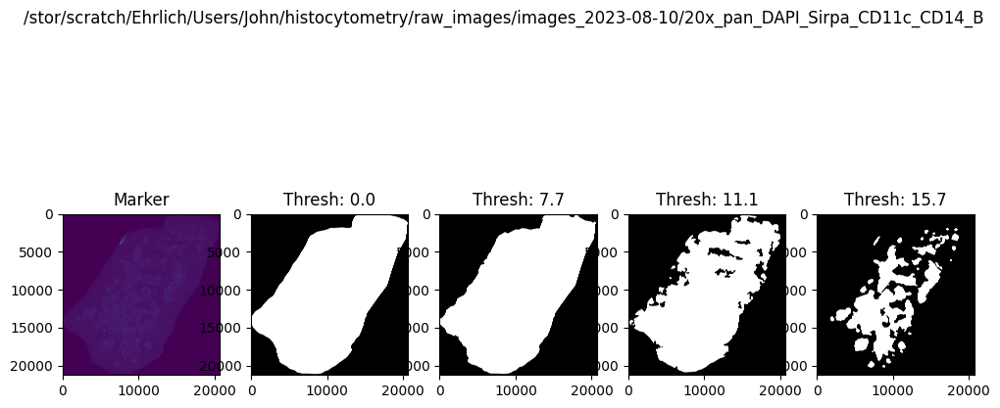

Starting plot


Starting plot


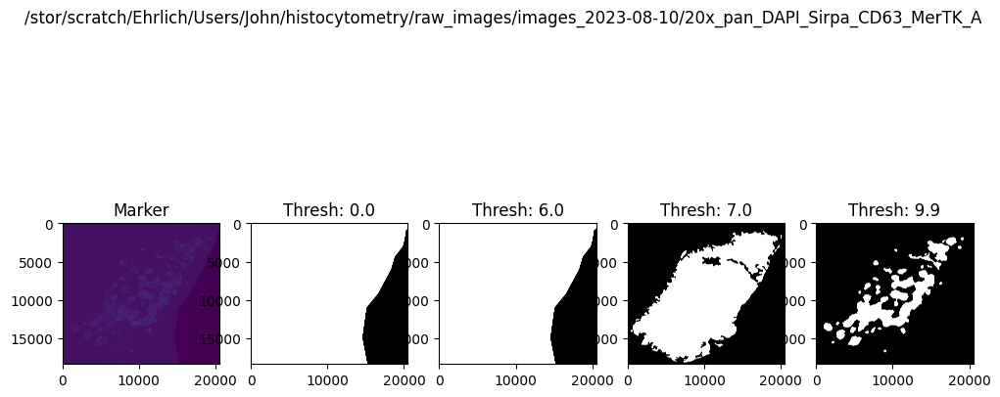

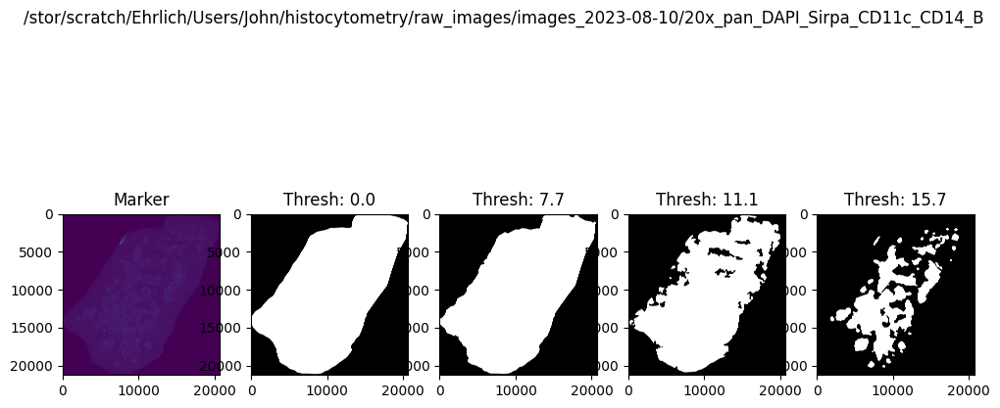

Starting plot


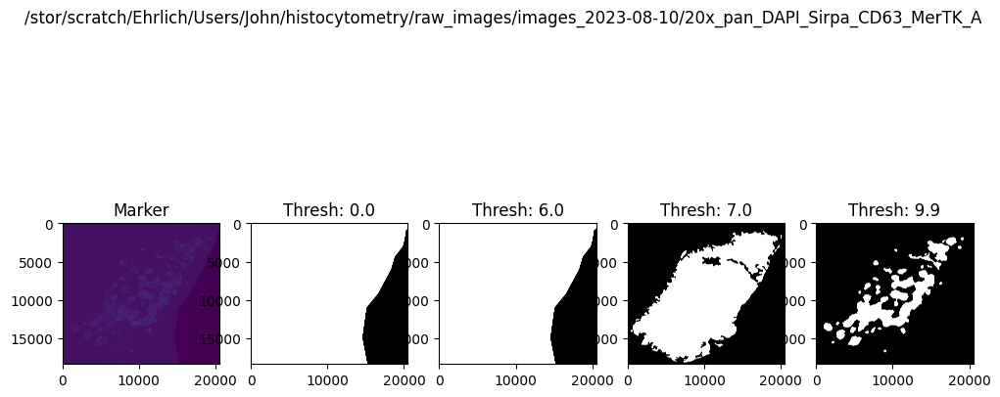

In [8]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs= [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir) and re.search("(CD14|MerTK)_[A-D]$", img_dir)]


parallelize_medulla(
    img_dirs                 = img_dirs, 
    medullary_threshold_rank = 4, 
    save_mask                = False, 
    channel_loc              = 2, 
    n_gaussians              = 4, 
    normalize                = False
) 

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
Starting plot
Starting plot


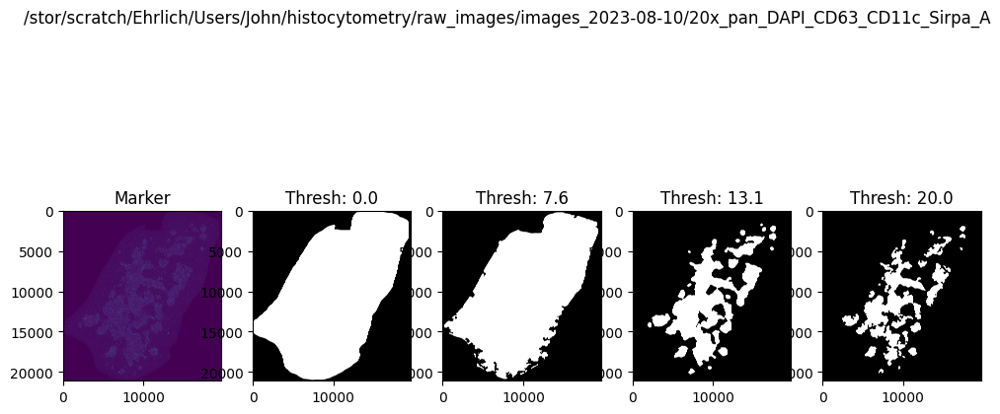

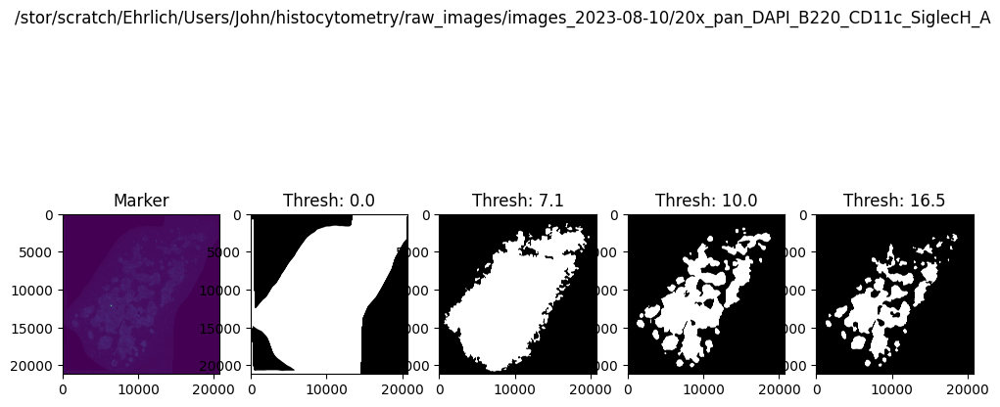

In [5]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"

## Using the third gaussian 
assigned_M3_dirs = ["CD63_CD11c_Sirpa_A",   ## definitely 3
                    "B220_CD11c_SiglecH_A"] ## definitely 3
M3_dirs = [os.path.join(raw_dir, "20x_pan_DAPI_" + img_dir) for img_dir in assigned_M3_dirs]
M3_dirs.sort()

for img_dir in M3_dirs:
    print(img_dir)
    
parallelize_medulla(
    img_dirs                 = M3_dirs, 
    medullary_threshold_rank = 3, 
    save_mask                = True, 
    channel_loc              = 2, 
    n_gaussians              = 4, 
    normalize                = False
) 

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_B
Starting plot


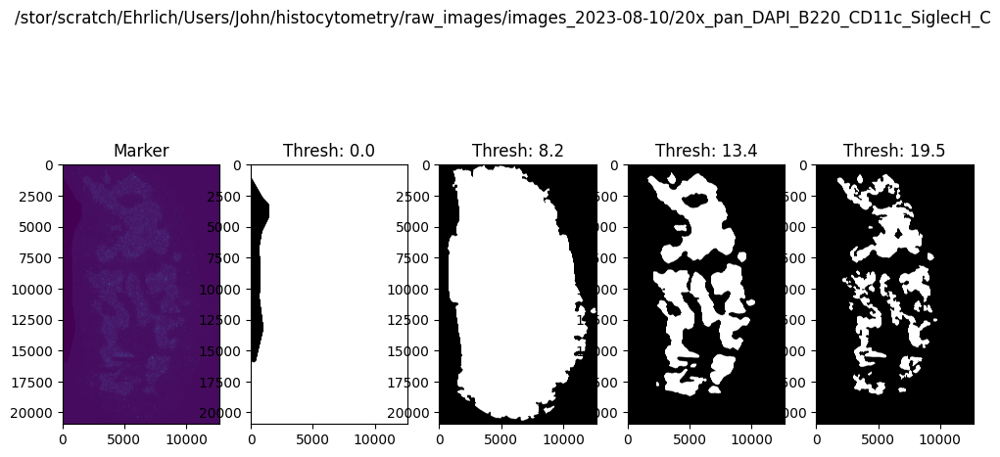

Starting plot


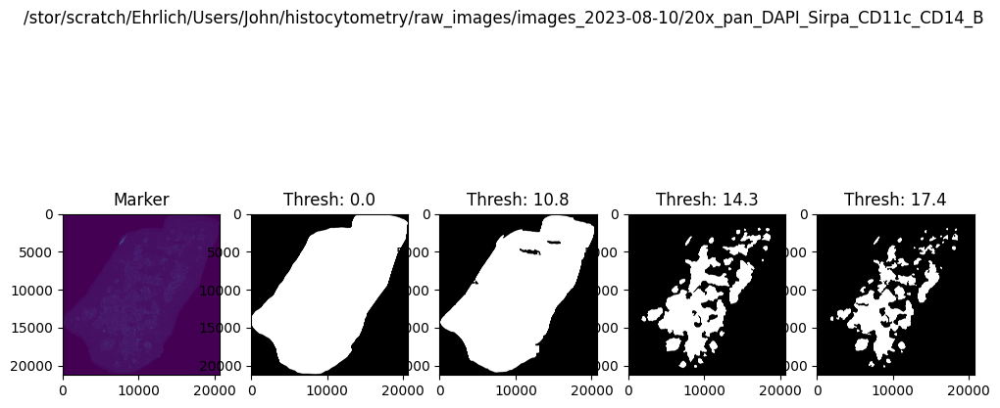

In [4]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"

## Using the third gaussian for some extra ones that didn't look good as G4.
assigned_M3_dirs = ["Sirpa_CD11c_CD14_B", 
                    "B220_CD11c_SiglecH_C"] 
M3_dirs = [os.path.join(raw_dir, "20x_pan_DAPI_" + img_dir) for img_dir in assigned_M3_dirs]
M3_dirs.sort()

for img_dir in M3_dirs:
    print(img_dir)
    
parallelize_medulla(
    img_dirs                 = M3_dirs, 
    medullary_threshold_rank = 3, 
    save_mask                = True, 
    channel_loc              = 2, 
    n_gaussians              = 4, 
    normalize                = False
) 

In [6]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in ["20x_pan_DAPI_Sirpa_CD11c_CD14_B", "20x_pan_DAPI_B220_CD11c_SiglecH_C"]]
img_dirs.sort()
for img_dir in img_dirs:
    print(img_dir)

out_name = "img_w_medulla.ome.tif"
for img_dir in img_dirs:
    medulla= tifffile.imread(os.path.join(img_dir, "medulla_mask.tif"))
    medulla = medulla[np.newaxis,...]
    img    = tifffile.imread(os.path.join(img_dir, "reordered_image.ome.tif"))

    img_w_medulla= np.concatenate((img, medulla))
    tifffile.imwrite(os.path.join(img_dir, out_name), img_w_medulla)
    print(f"Done with {img_dir}")

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_B
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_B


/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_D
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_A
/stor/scratch/Eh

Starting plot


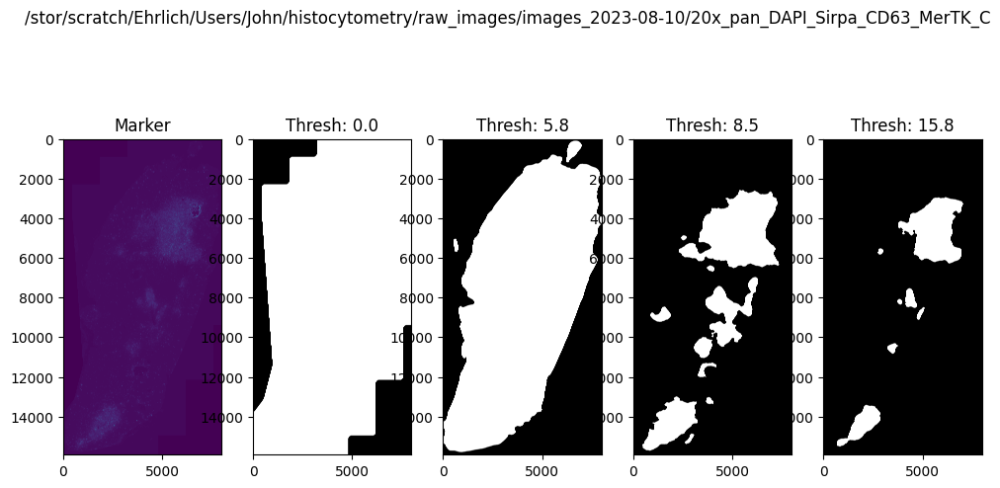

Starting plot
Starting plot


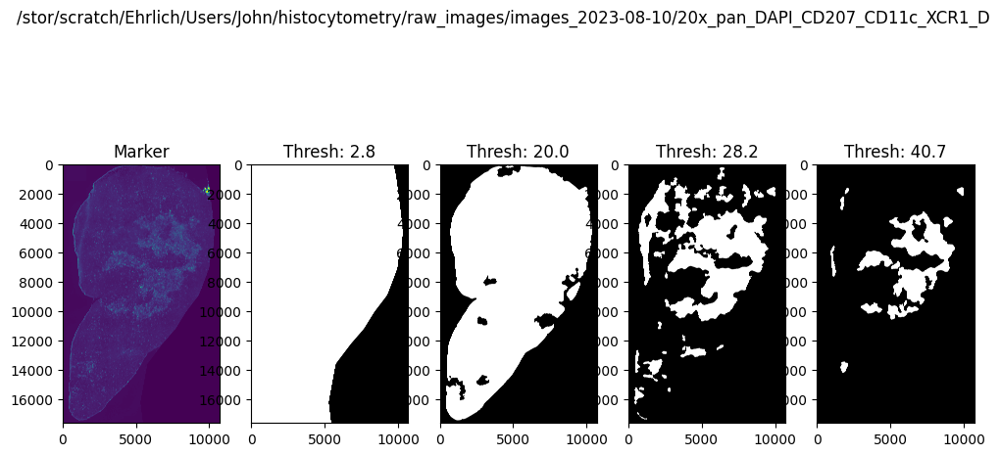

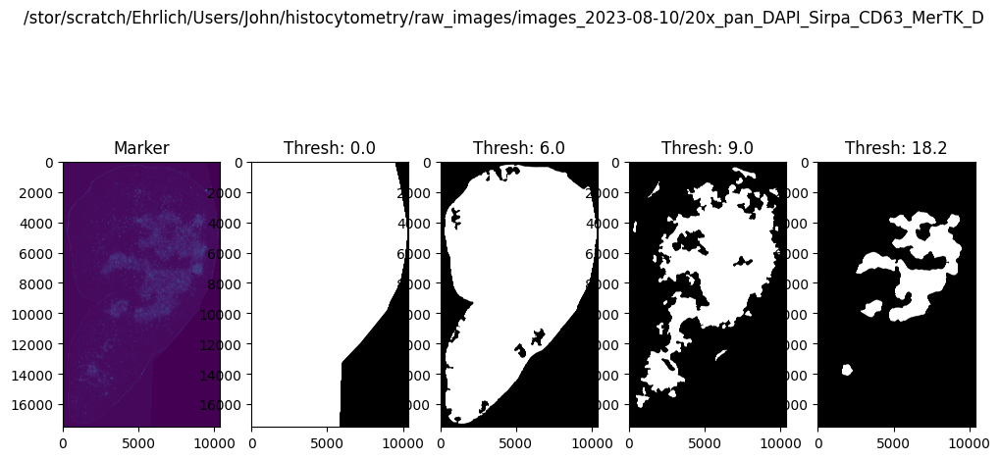

Starting plot
Starting plot


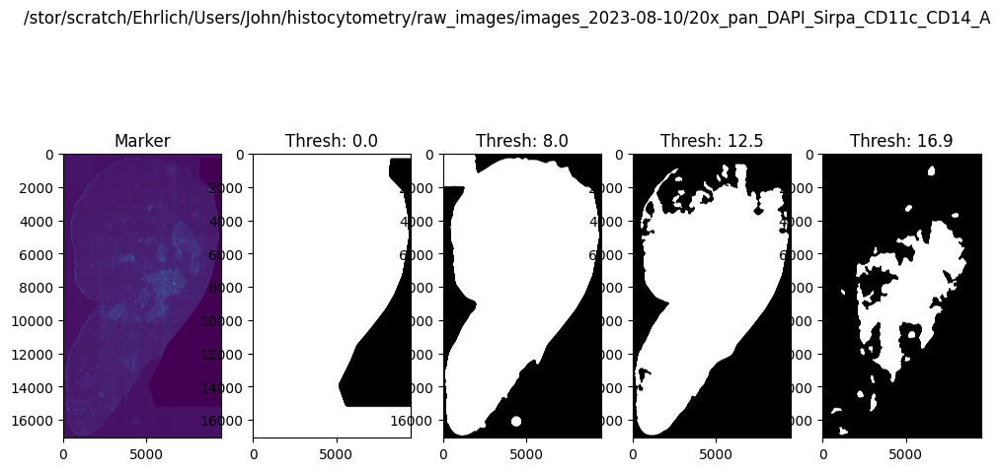

Starting plot


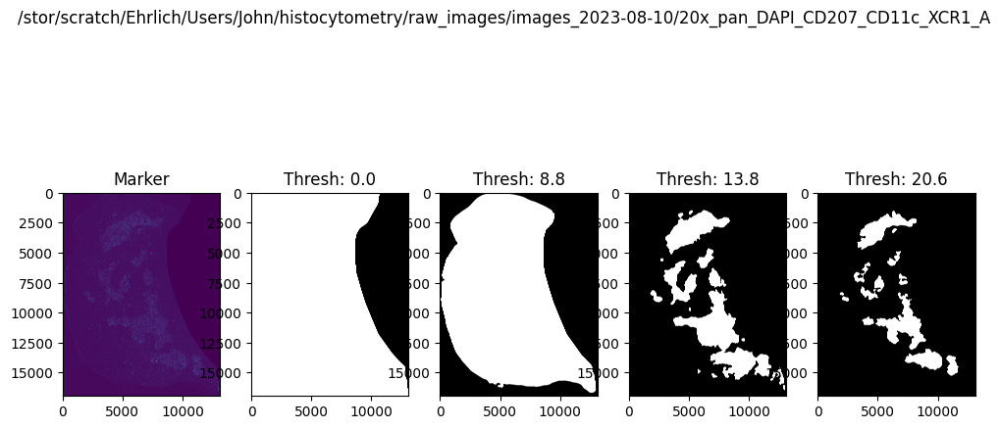

Starting plot


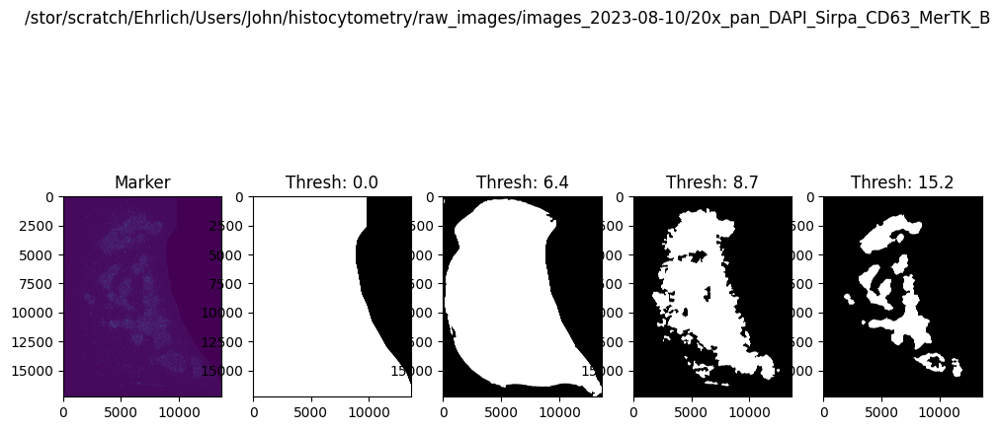

Starting plot


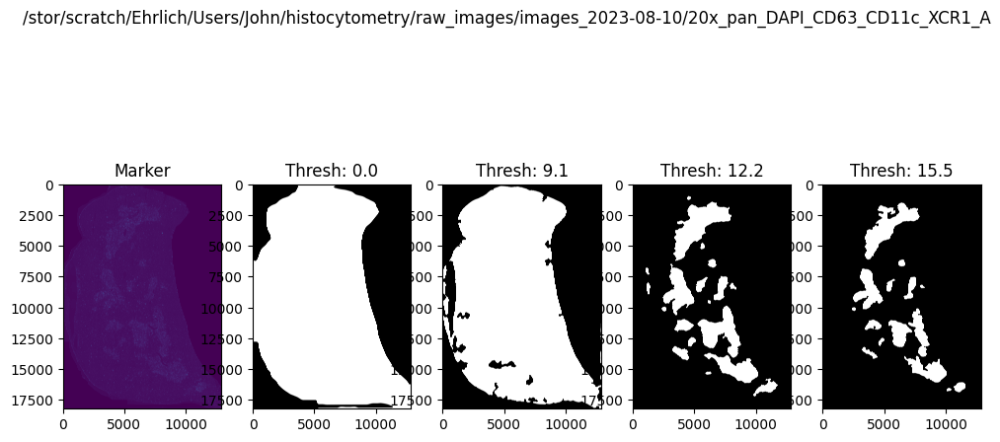

Starting plot
Starting plot
Starting plot


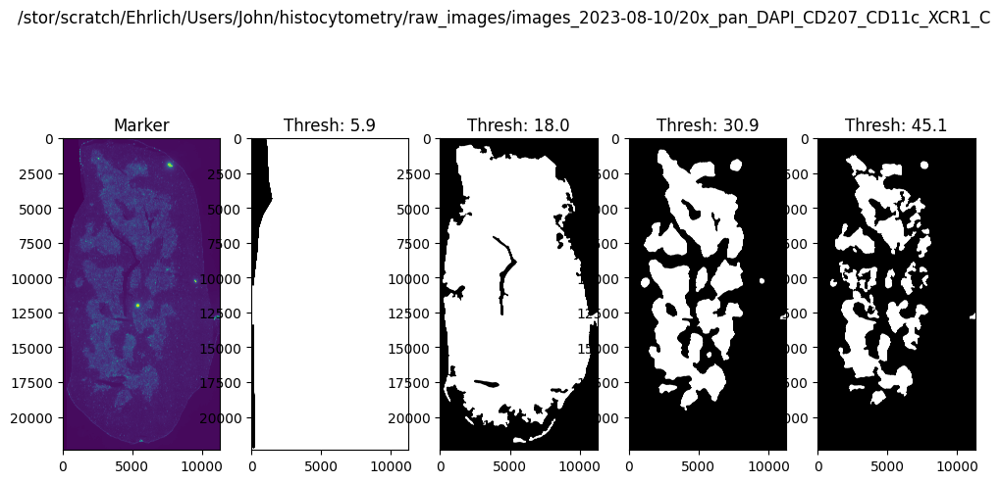

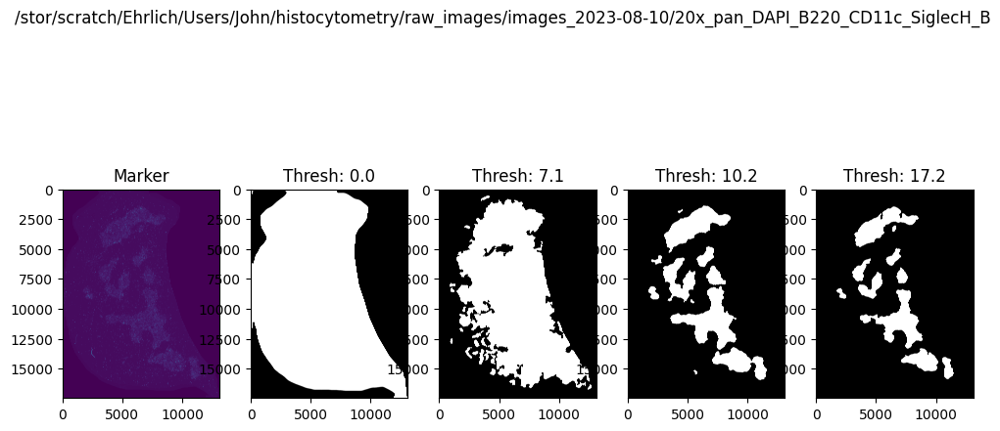

Starting plot


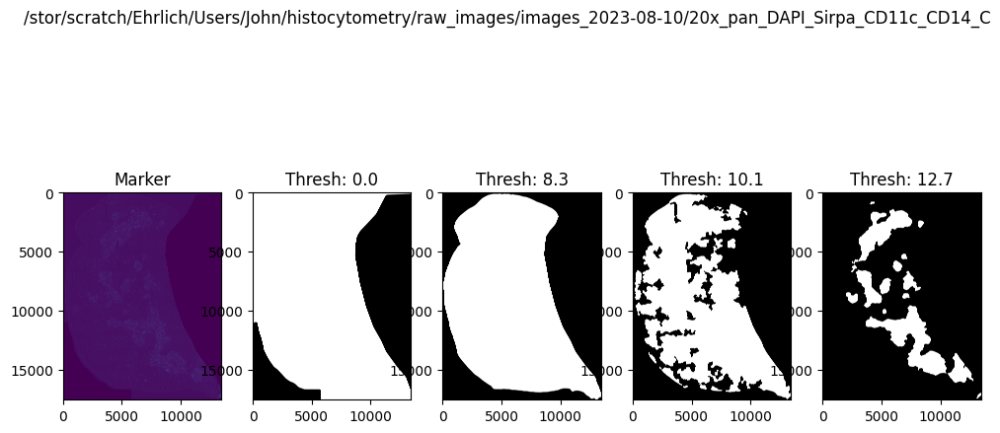

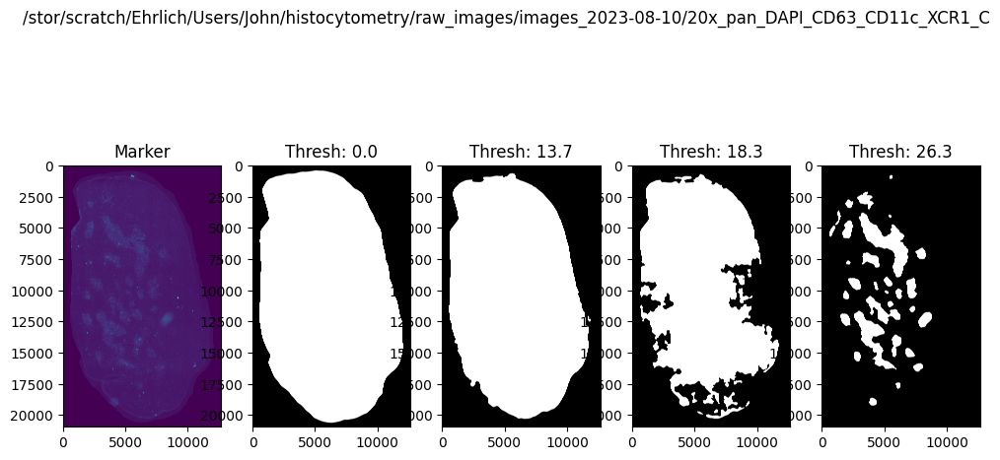

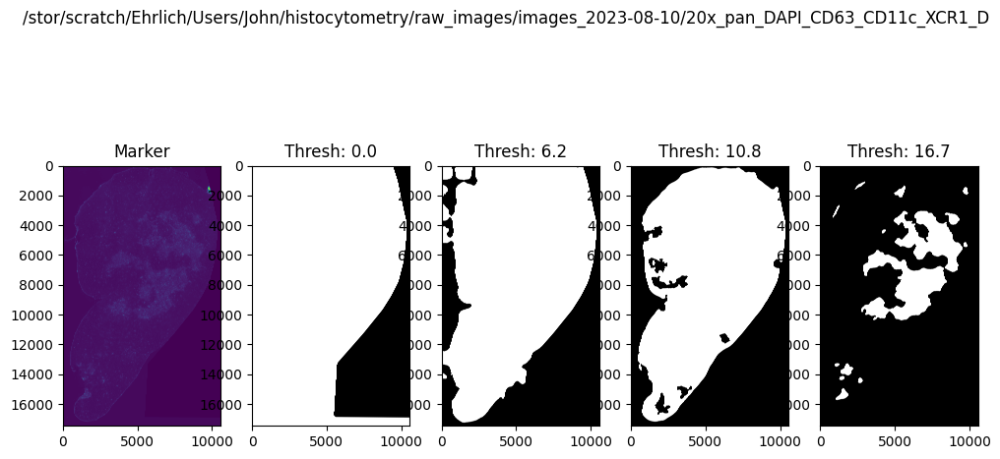

Starting plot


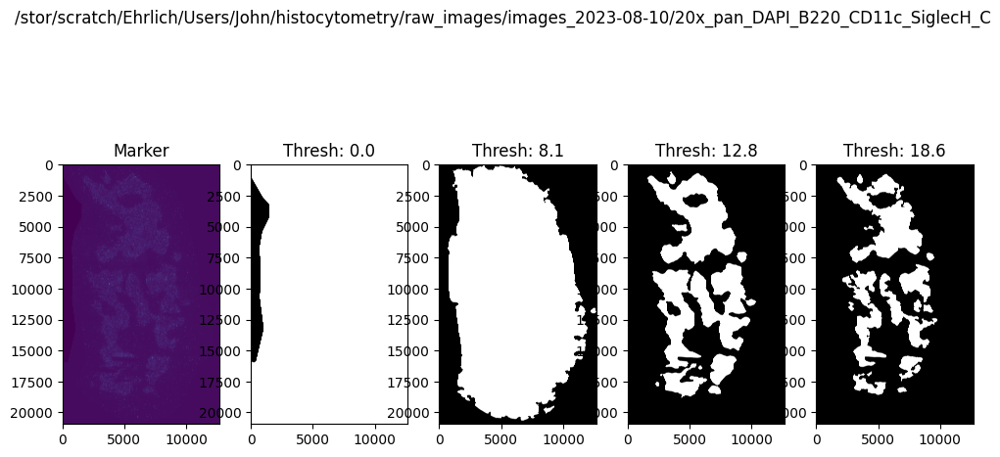

Starting plot


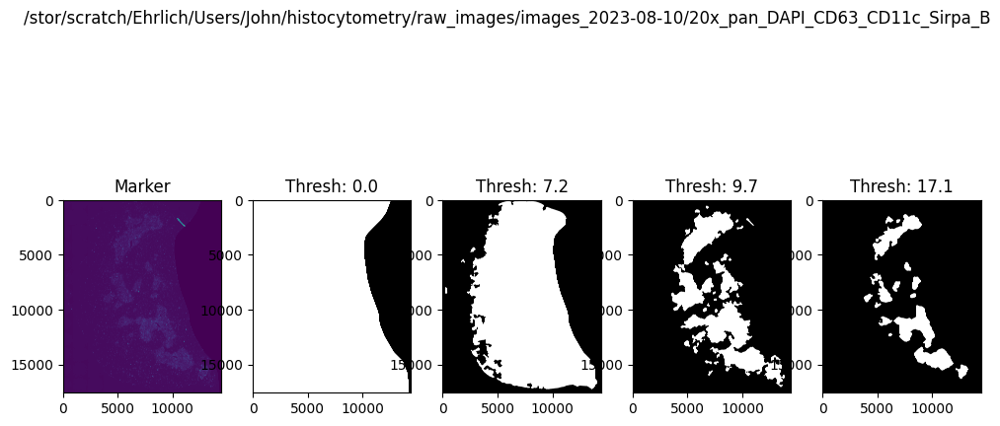

Starting plot


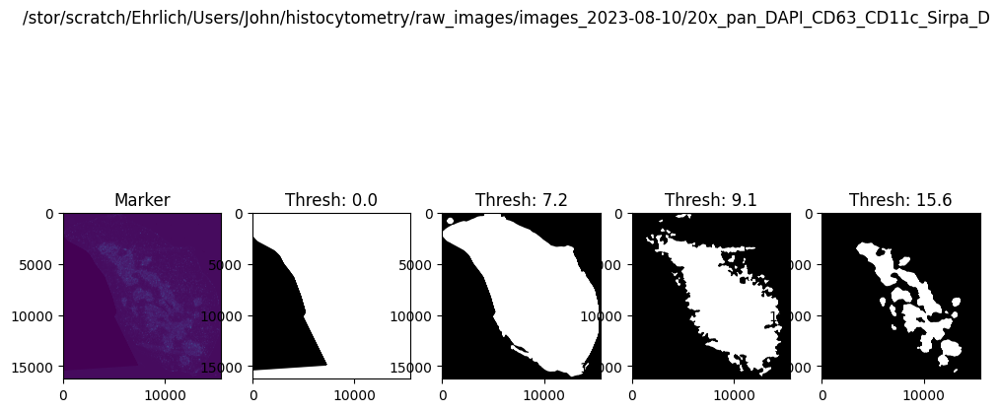

Starting plot
Starting plot
Starting plot


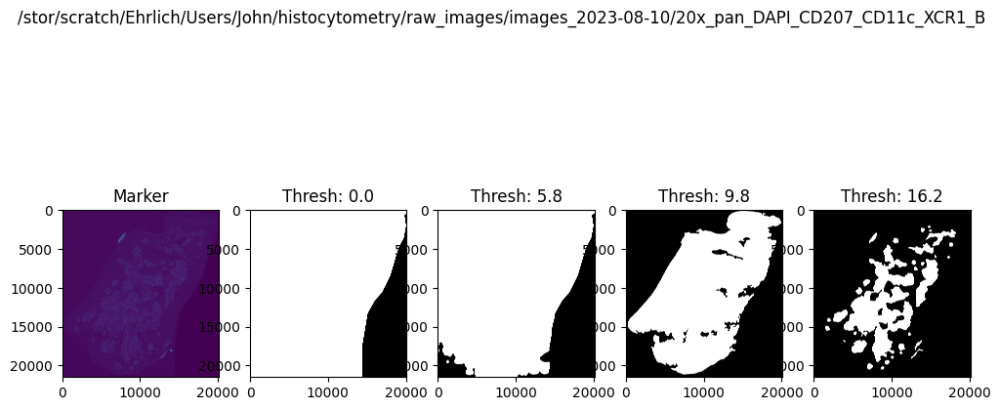

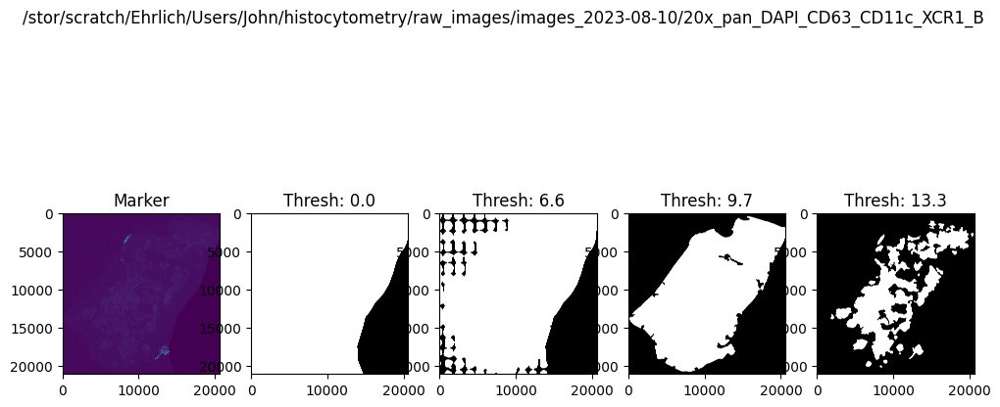

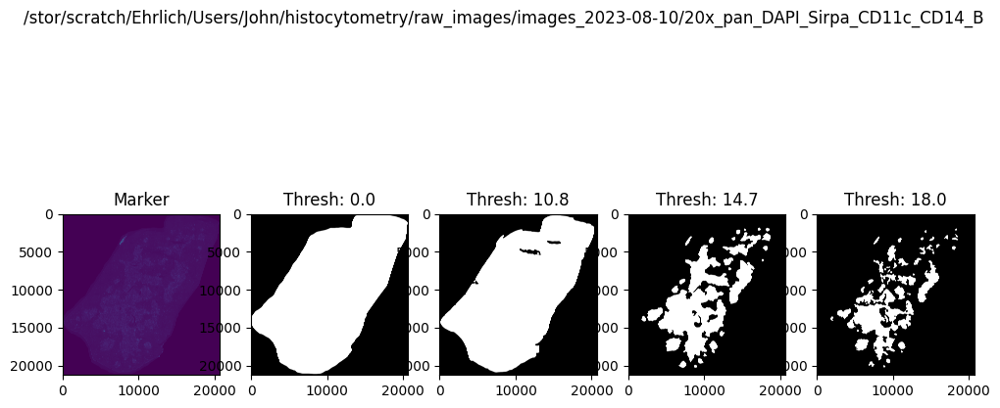

Starting plot


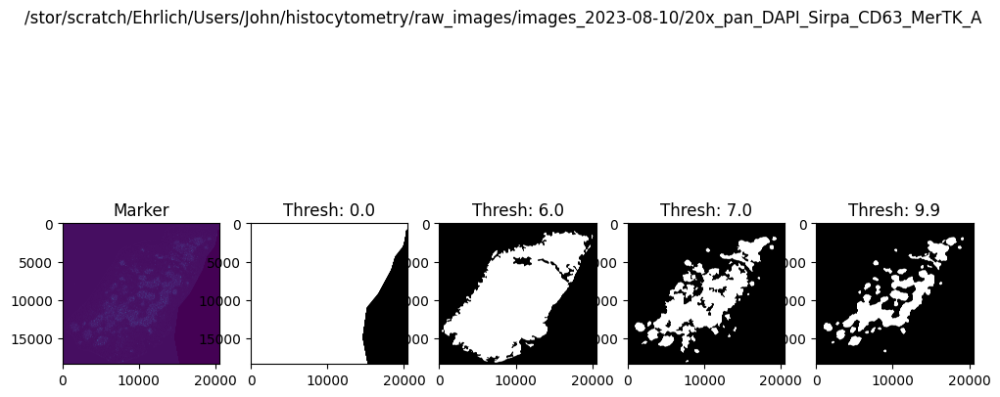

In [6]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"

## Using the fourth gaussian
assigned_M4_dirs = ["B220_CD11c_SiglecH_B", "B220_CD11c_SiglecH_C", 
                    "CD207_CD11c_XCR1_A", "CD207_CD11c_XCR1_B", "CD207_CD11c_XCR1_C", "CD207_CD11c_XCR1_D",
                    "CD63_CD11c_XCR1_A", "CD63_CD11c_XCR1_B", "CD63_CD11c_XCR1_C", "CD63_CD11c_XCR1_D",
                    "CD63_CD11c_Sirpa_B", "CD63_CD11c_Sirpa_D",
                    "Sirpa_CD63_MerTK_A", "Sirpa_CD63_MerTK_B", "Sirpa_CD63_MerTK_C", "Sirpa_CD63_MerTK_D",
                    "Sirpa_CD11c_CD14_A", "Sirpa_CD11c_CD14_C"]
M4_dirs = [os.path.join(raw_dir, "20x_pan_DAPI_" + img_dir) for img_dir in assigned_M4_dirs]
M4_dirs.sort()

for img_dir in M4_dirs:
    print(img_dir)

parallelize_medulla(
    img_dirs                 = M4_dirs, 
    medullary_threshold_rank = 4, 
    save_mask                = True, 
    channel_loc              = 2, 
    n_gaussians              = 4, 
    normalize                = False
) 


## Do I want to go through and manually remove the folds and capsule that are called medulla? 
    ## I think I do. The images are basically hand-drawn anyway. 

## I could pick a threshold for the medulla using the non-GMM method. 
## I also should pick the whole lobe segmentation with the normalized data. 


## How bad does MerTK_C actually look?
## MerTK_B needs the crab claw filled in.
## CD207_CD11c_XCR1_A needs wrinkle smoothing.
## CD207_CD11c_XCR1_D needs a fold removed and some smoothing of the medulla wrinkles
## CD14_A looks so bad.

## CD63_CD11c_XCR1_A might be better as G3. (I need to check this one.)
## CD207_CD11c_XCR1_C might need to be a G3. (This one has a hot spot that needs to be removed.)
## CD63_CD11c_XCR1_C has a hot spot on in that needs to be removed from the medulla mask.
## CD63_CD11c_XCR1_D needs capsule removed

## SiglecH_C needs to be a G3.
## Sirpa_B needs to have wrinkles smoothed.
## CD14_B needs to be G3.

In [11]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir) and not re.search("Sirpa_C$", img_dir)]
img_dirs.sort()
for img_dir in img_dirs:
    print(img_dir)

out_name = "img_w_medulla.ome.tif"
for img_dir in img_dirs:
    medulla= tifffile.imread(os.path.join(img_dir, "medulla_mask.tif"))
    medulla = medulla[np.newaxis,...]
    img    = tifffile.imread(os.path.join(img_dir, "reordered_image.ome.tif"))

    img_w_medulla= np.concatenate((img, medulla))
    tifffile.imwrite(os.path.join(img_dir, out_name), img_w_medulla)
    print(f"Done with {img_dir}")

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
/stor/scratch

In [11]:
assigned_M4_dirs = ["B220_CD11c_SiglecH_B", "B220_CD11c_SiglecH_C", 
                    "CD207_CD11C_XCR1_A", "CD207_CD11c_XCR1_B", "CD207_CD11c_XCR1_D",
                    "CD63_CD11c_XCR1_B", "CD63_CD11c_XCR1_C", "CD63_CD11c_XCR1_D",
                    "CD63_CD11c_Sirpa_B", "CD63_CD11c_Sirpa_D",
                    "Sirpa_CD63_MerTK_A", "Sirpa_CD63_MerTK_B", "Sirpa_CD63_MerTK_C", "Sirpa_CD63_MerTK_D",
                    "Sirpa_CD11c_CD14_A", "Sirpa_CD11c_CD14_B", "Sirpa_CD11c_CD14_C"]
print(len(assigned_M4_dirs))

assigned_M3_dirs = ["CD63_CD11c_XCR1_A", 
                    "CD207_CD11C_XCR1_C", 
                    "CD63_CD11c_Sirpa_A", 
                    "B220_CD11c_SiglecH_A"]
print(len(assigned_M3_dirs))
## This is the right number. (Trust me.)






## G3: 
    ## CD63_CD11c_XCR1_A 
    ## CD207_CD11C_XCR1_C
    ## CD63_CD11c_Sirpa_A
    ## B220_CD11c_SiglecH_A
## G4:
    ## B220_CD11c_SiglecH_B
    ## B220_CD11c_SiglecH_C
    ## CD207_CD11C_XCR1_A
    ## CD207_CD11c_XCR1_B
    ## CD207_CD11c_XCR1_D (Needs significant cleaning)
    ## CD63_CD11c_XCR1_B
    ## CD63_CD11c_XCR1_C
    ## CD63_CD11c_XCR1_D (Needs significant cleaning) 
    ## CD63_CD11c_Sirpa_B
    ## CD63_CD11c_Sirpa_D
    ## Sirpa_CD63_MerTK_A
    ## Sirpa_CD63_MerTK_B
    ## Sirpa_CD63_MerTK_C
    ## Sirpa_CD63_MerTK_D
    ## Sirpa_CD11c_CD14_A (This one really doesn't look good.)
    ## Sirpa_CD11c_CD14_B
    ## Sirpa_CD11c_CD14_C

## I should check the G3 images to make sure they look good.

17
4


In [ ]:
## Pulling out clean medulla_mask from img_w_medulla.ome.tif 
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir) and not re.search("Sirpa_C$", img_dir)]

for img_dir in img_dirs:
    print(img_dir)
    img_w_cleaned_medulla = tifffile.imread(os.path.join(img_dir, "img_w_medulla.ome.tif"))
    medulla = img_w_cleaned_medulla[4,...]
    tifffile.imwrite(os.path.join(img_dir, "cleaned_medulla_mask.tif"), medulla)

In [ ]:
for key in img_dict.keys():
    print(key)
    n= int(re.sub("M", "", key))
    parallelize_medulla(img_dict[key], medullary_threshold_rank= n, save_mask= False, channel_loc= 2, n_gaussians= 4)

['/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_A', '/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_B', '/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_C']
['/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B']
['/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A', '/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B', '/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C', '/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A', '/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD20

Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_B
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_C
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_A
Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_C
Starting /stor/scratch/Ehrlich/Users/John/histocytome

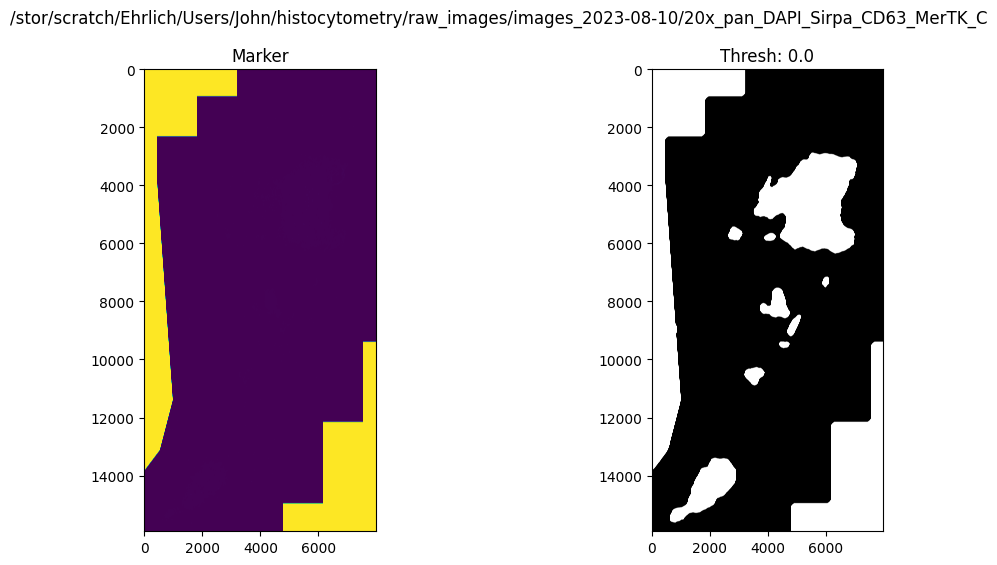

Starting plot


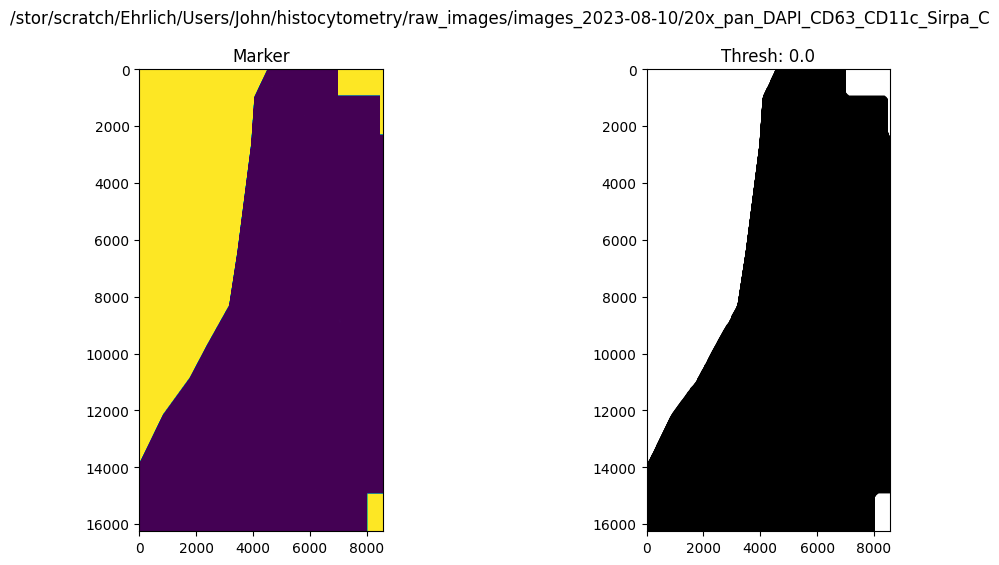

Starting plot
Starting plot
Starting plot


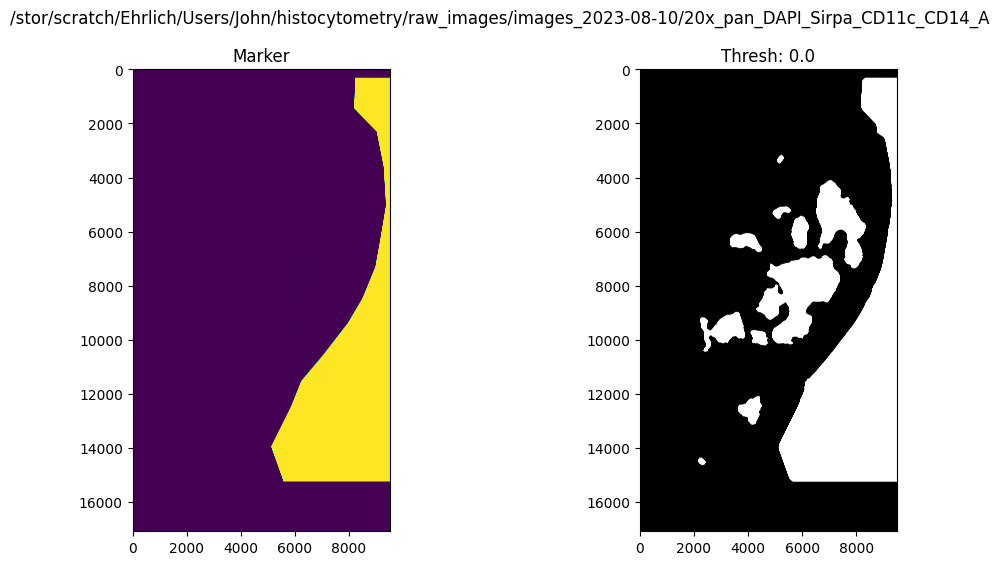

Starting plot
Starting plot
Starting plot


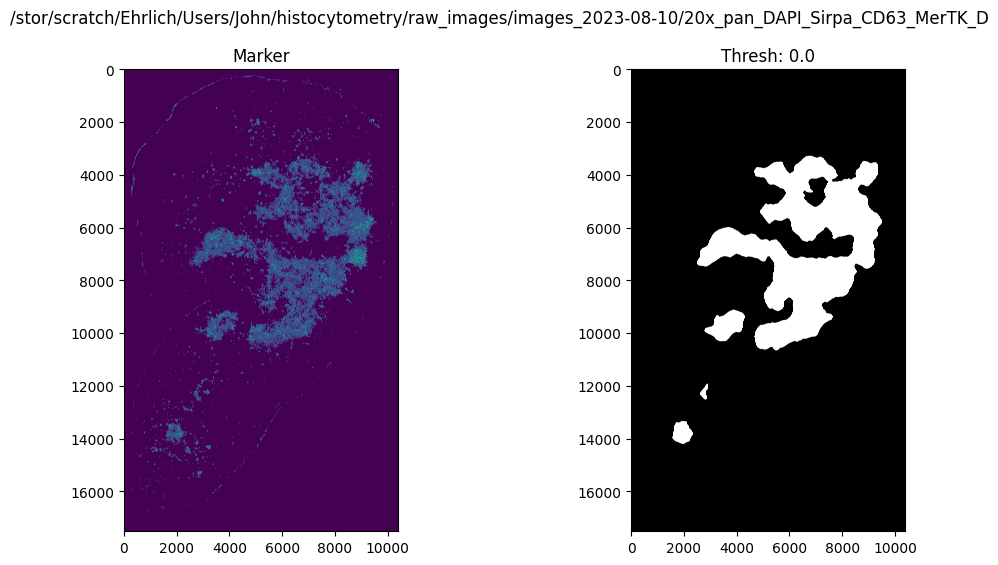

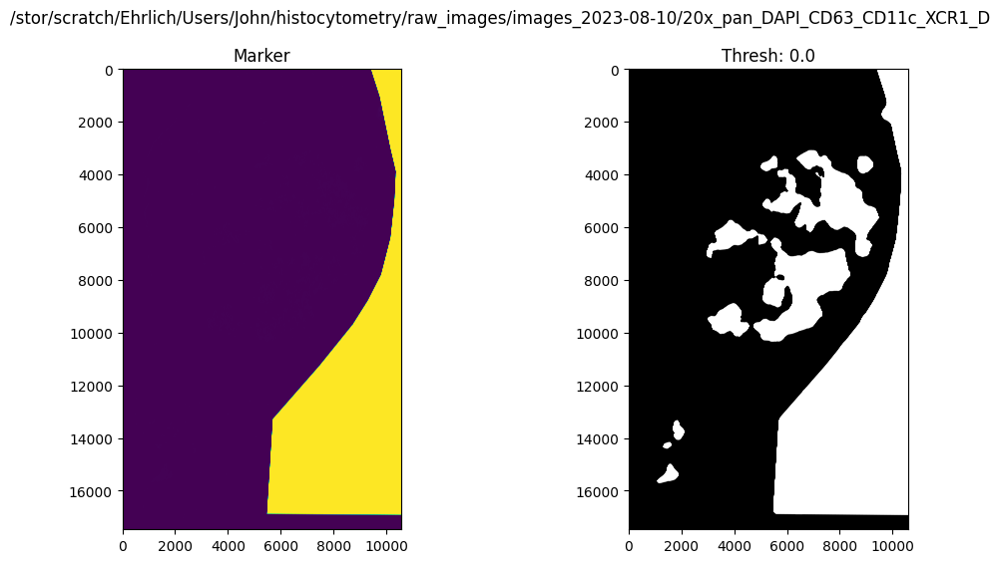

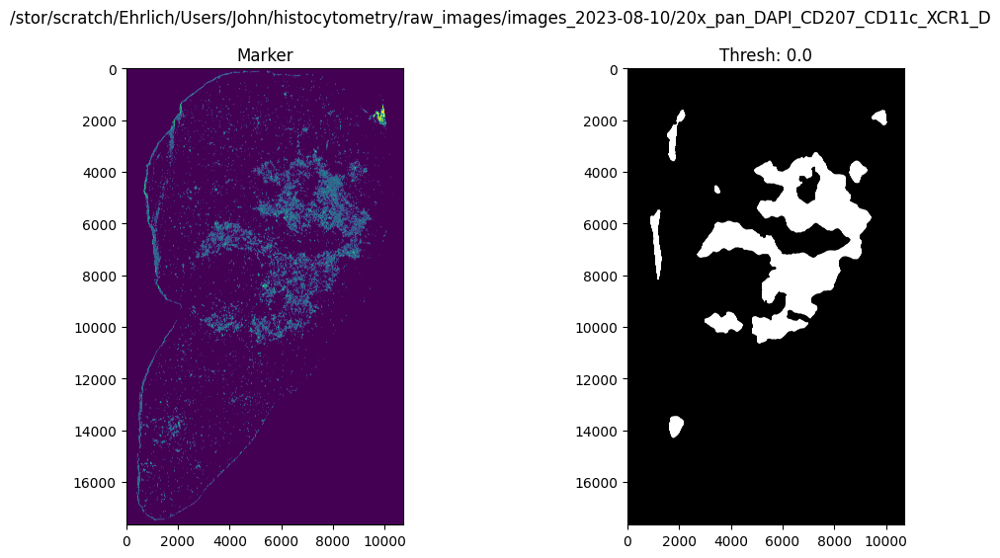

Starting plot
Starting plot
Starting plot
Starting plot
Starting plot
Starting plot
Starting plot


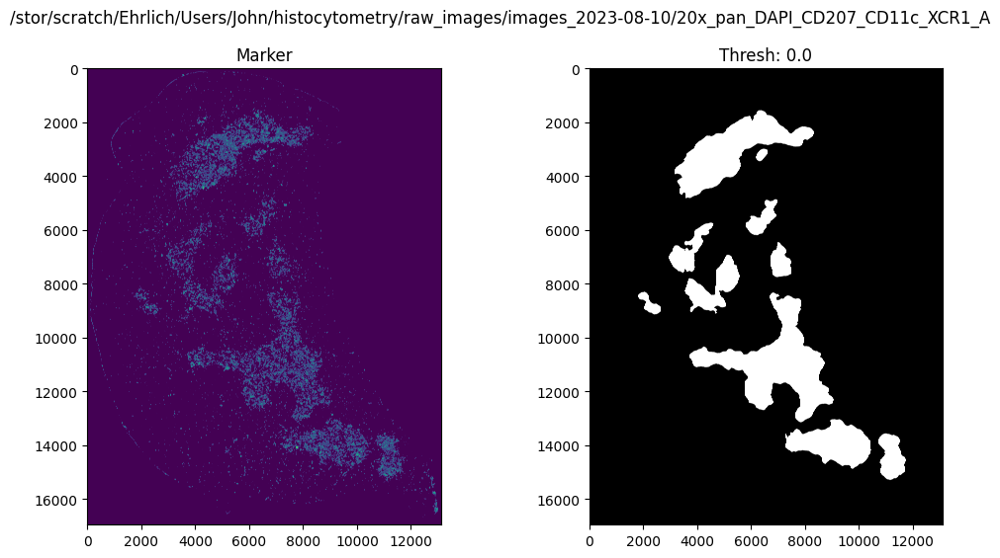

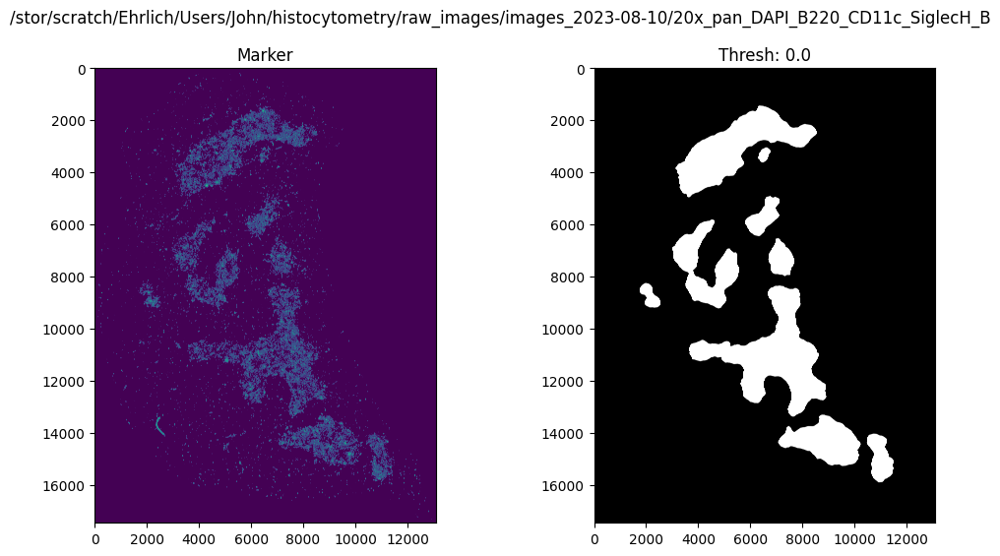

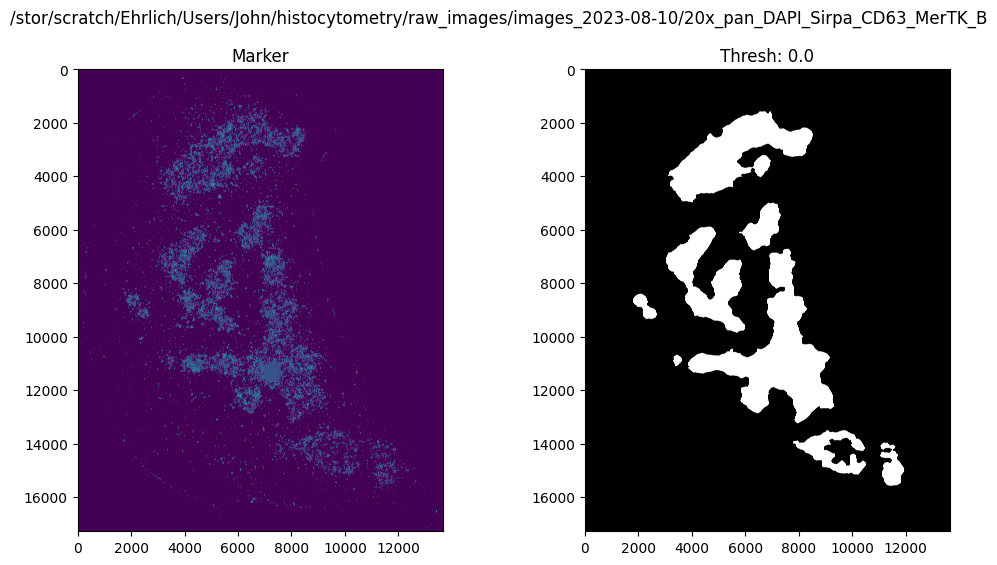

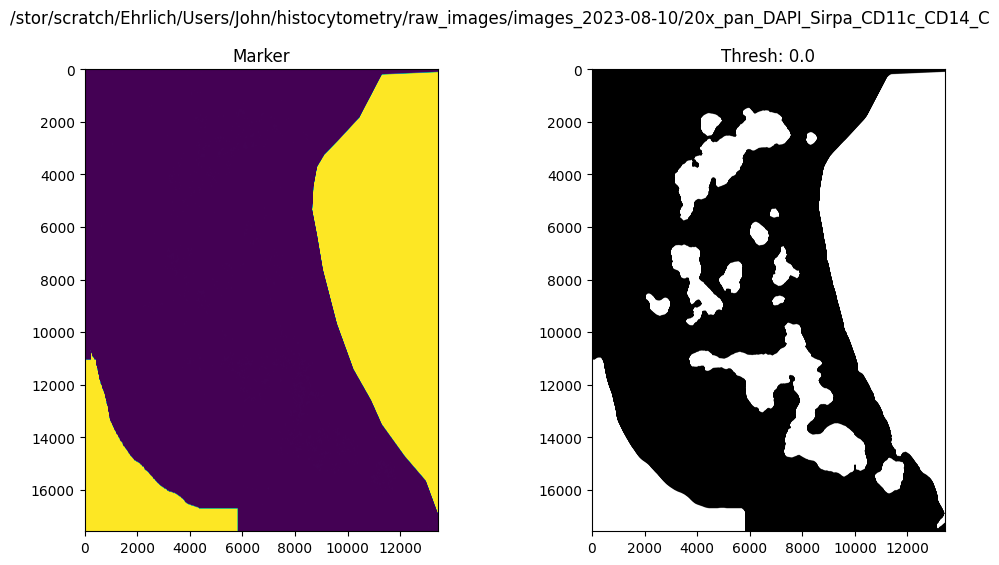

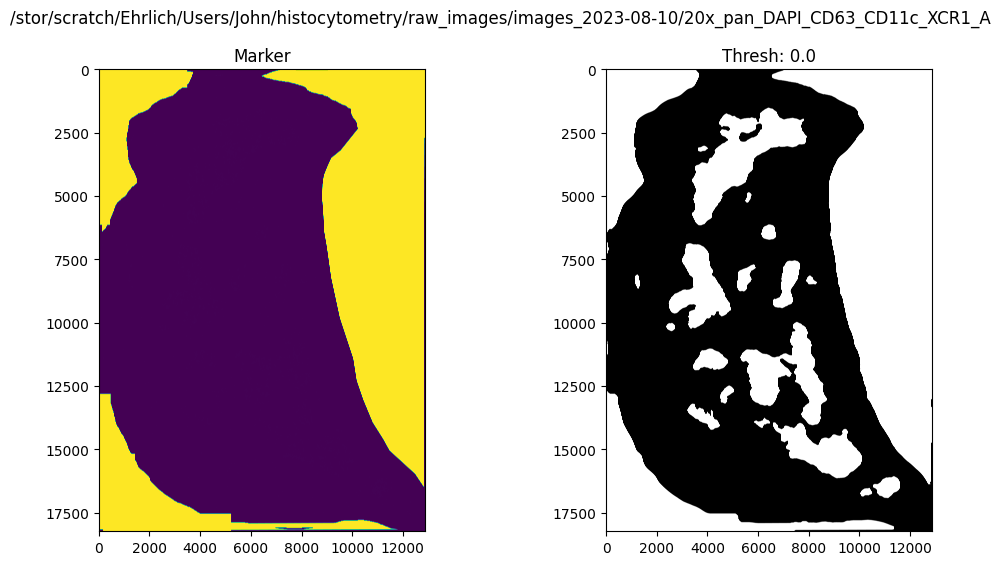

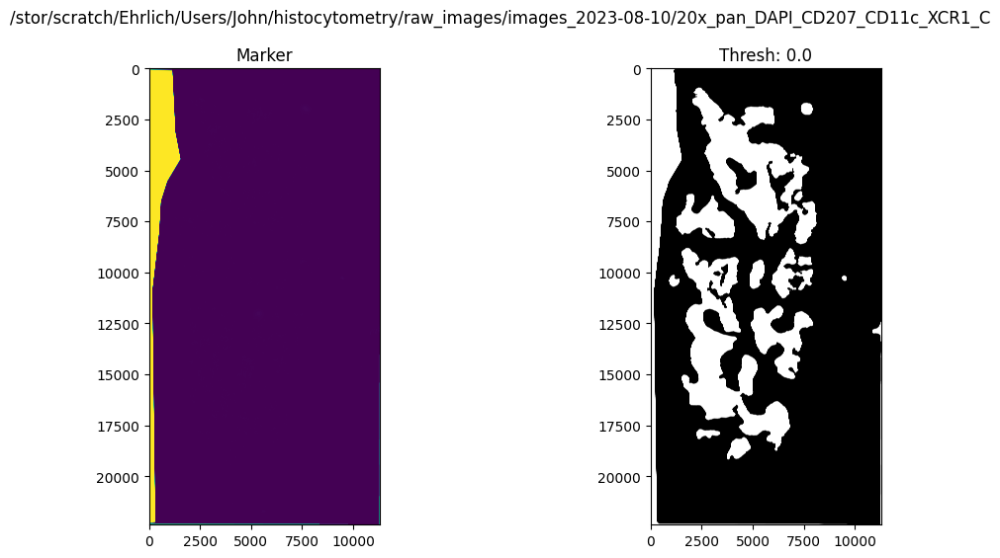

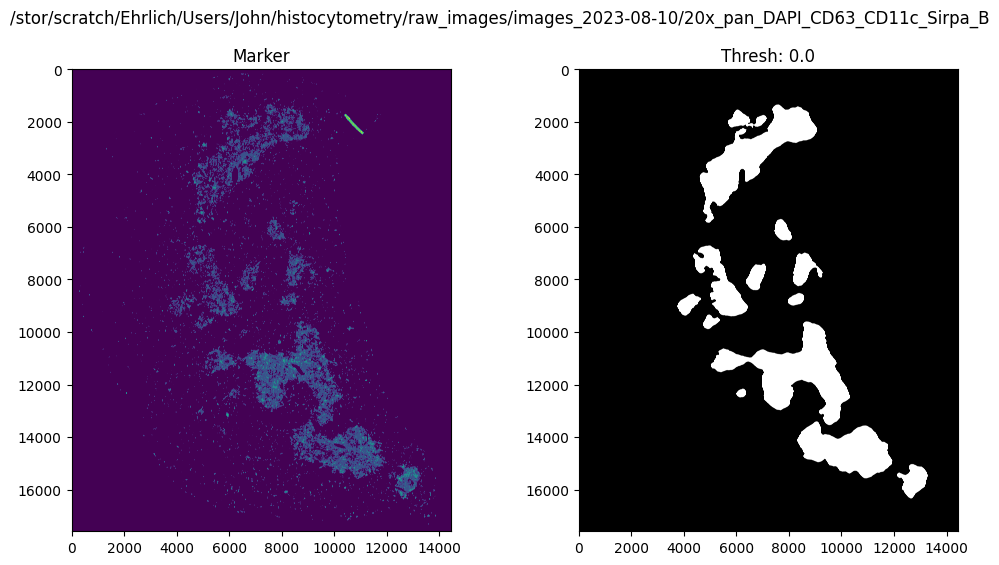

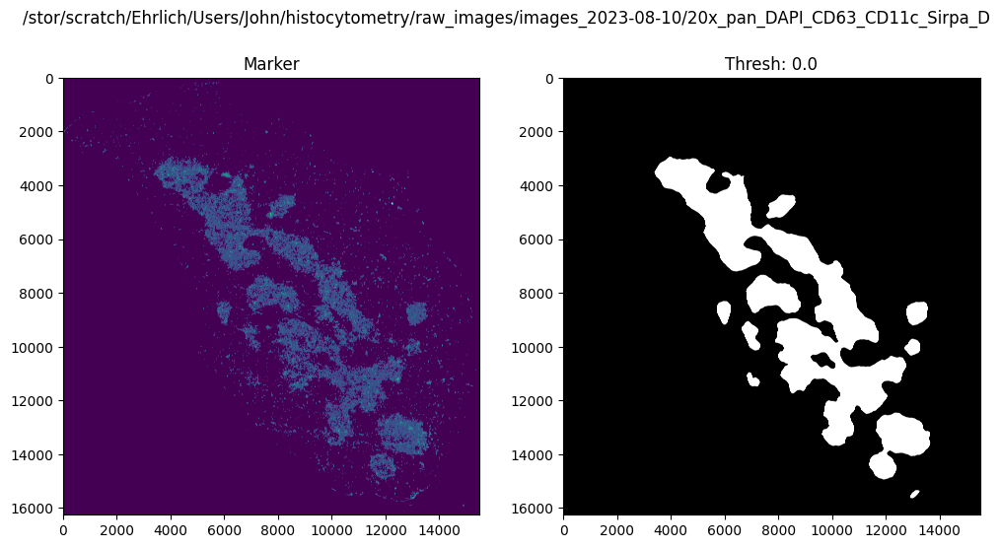

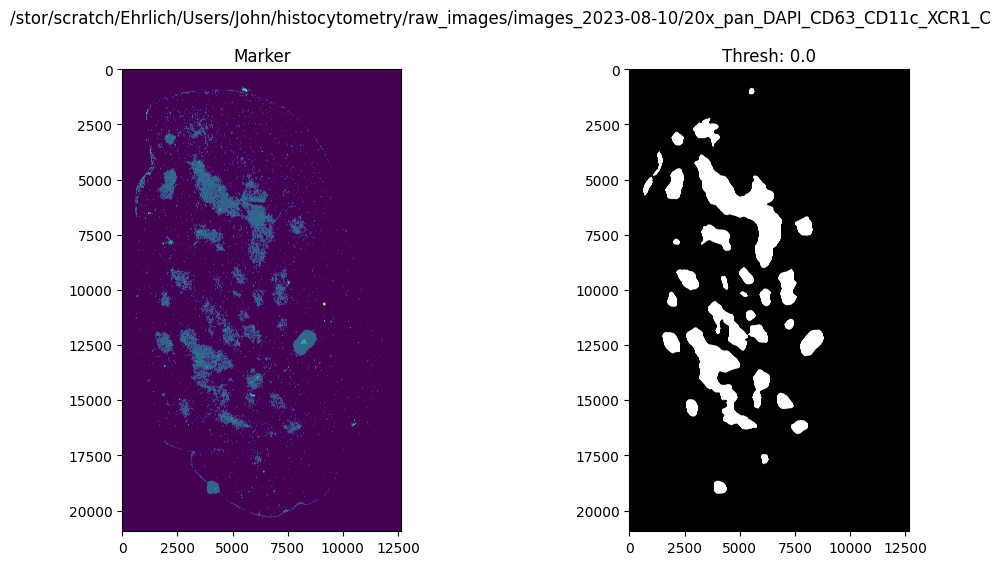

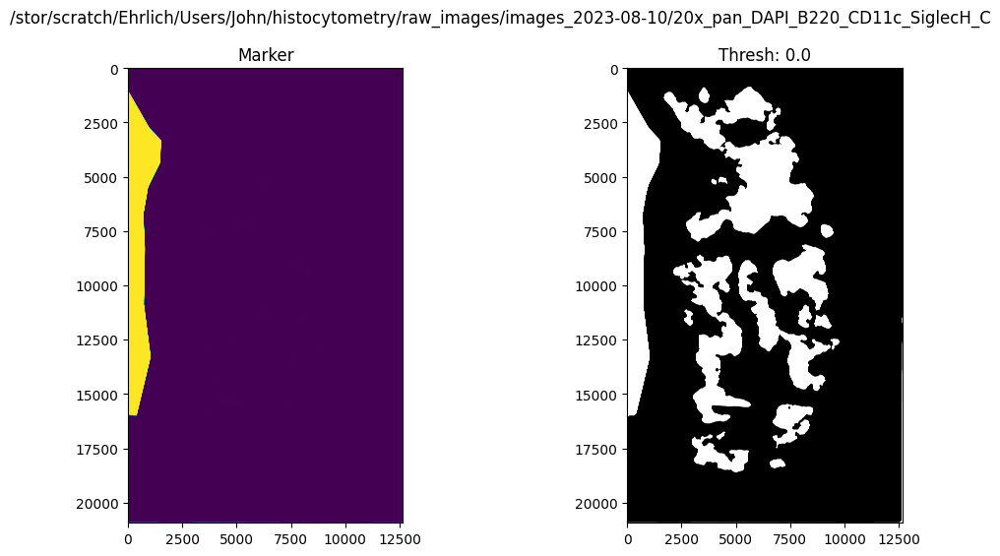

Starting plot
Starting plot
Starting plot
Starting plot
Starting plot


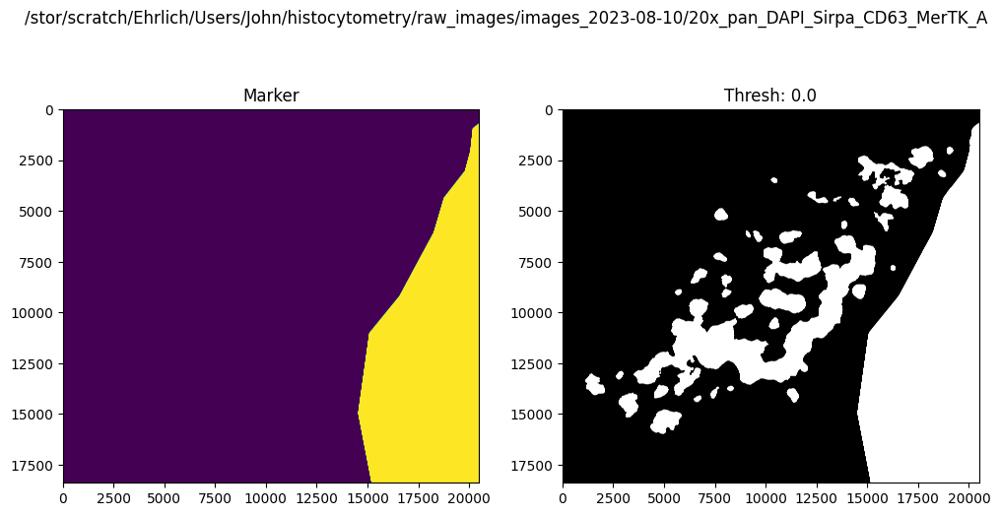

Starting plot


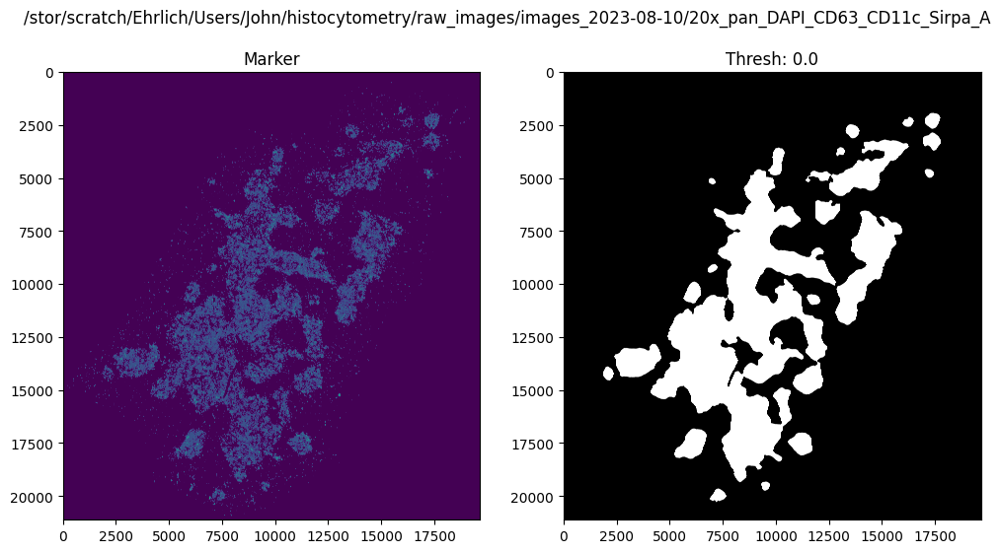

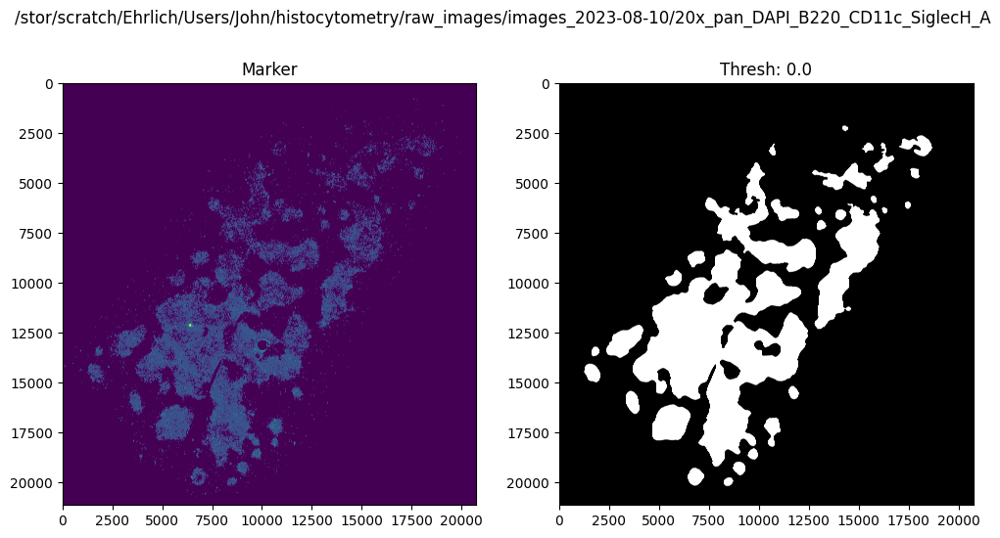

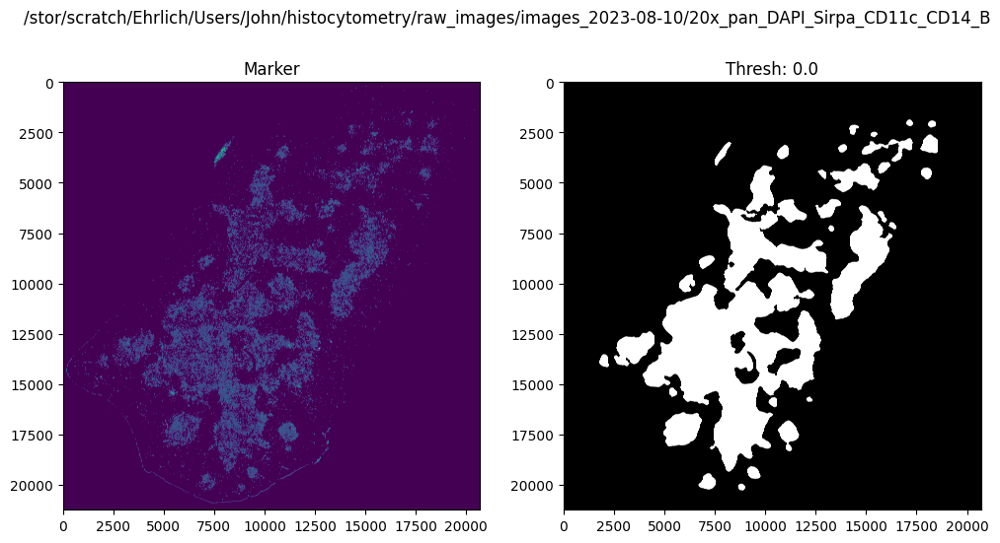

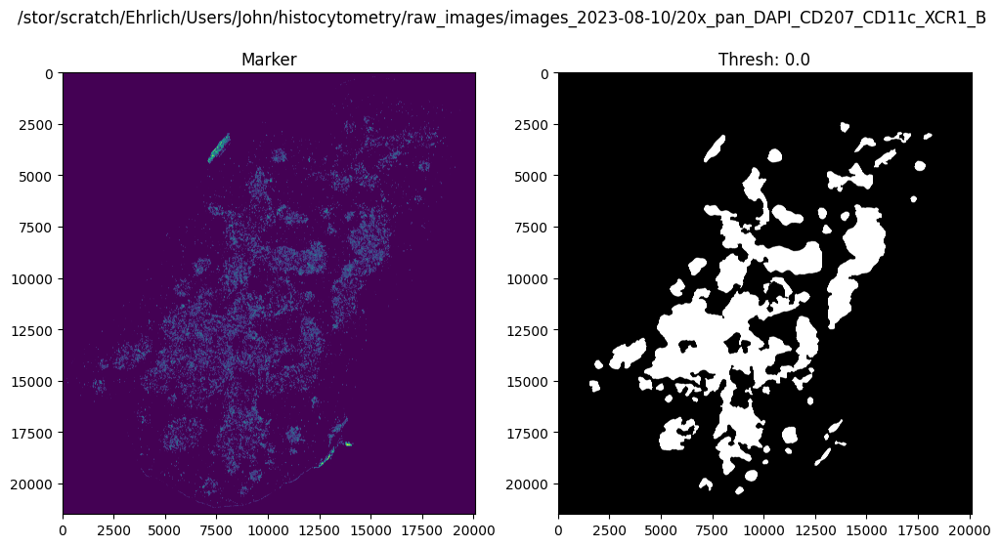

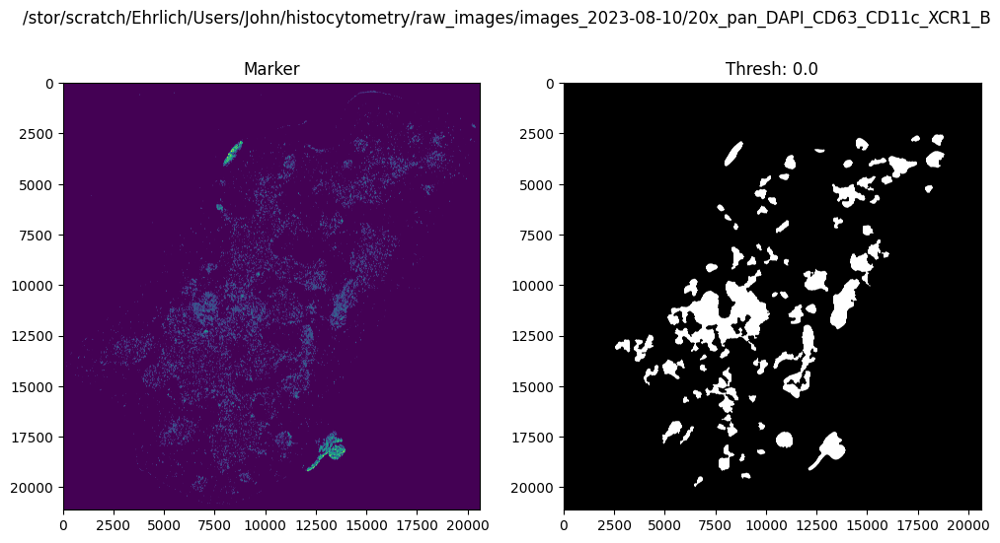

In [ ]:
if True:
    raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
    img_dirs= [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("_[A-D]$", img_dir)]

    thresholds = np.arange(0, 0.025, 0.025)
        ## Let's pick the best threshold

    parallelize_segmentation(
        img_dirs    = img_dirs, 
        thresholds  = thresholds, 
        channel_loc = 2, 
        glob_str    = "reordered_image.ome.tif",
        save_mask   = False,
        out_name    = "medulla_mask.tif"
    )  

## Making cortex out of medulla and whole lobe masks

In [ ]:
for img_dir in img_dirs:
    make_cortex(img_dir, medulla_mask= "medulla_mask.tif", whole_lobe_mask= "whole_lobe_mask.tif")
    print(f"Done with {img_dir}")
## There are some medulla.tif and whole_lobe.tif floating around. Don't use those. 

Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_B
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_A
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_C
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_A
Done with /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_C
Done with /stor/scratch/Ehrlich/Users/John/hi

## Overlay tissue masks on original image

In [ ]:
for img_dir in img_dirs:
    medulla_mask = tifffile.imread(os.path.join(img_dir, "medulla_mask.tif"))
    cortex_mask  = tifffile.imread(os.path.join(img_dir, "cortex_mask.tif"))

    overlay_cortex_and_medulla(
        image_dir  = img_dir,
        medulla    = medulla_mask, 
        cortex     = cortex_mask, 
        out_name   = "tissue_segmented_image.ome.tif", 
        image_name = "reordered_image.ome.tif"
    )

## My next step will be to look at how these masks look. 

## Iterating on cortical segmentation

In [ ]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs= ["20x_pan_DAPI_B220_CD11c_SiglecH_A",
           "20x_pan_DAPI_CD207_CD11c_XCR1_A",
           "20x_pan_DAPI_CD63_CD11c_Sirpa_A",
           "20x_pan_DAPI_CD63_CD11c_XCR1_A",
           "20x_pan_DAPI_Sirpa_CD11c_CD14_A",
           "20x_pan_DAPI_Sirpa_CD63_MerTK_A"]
img_dirs= [os.path.join(raw_dir, img_dir) for img_dir in img_dirs]

downsample_divisor= 8

for img_dir in img_dirs: 
    print("Starting " + img_dir)

    ## Take an example DAPI stain
    DAPI = setup_image(image_dir= img_dir, glob_str= "reordered_image.ome.tif",  channel_loc= 0)
    reshaped_img = DAPI.reshape((DAPI.size, 1)).flatten()

    ## Removing the outliers to deal w/ some bright medulla that might've caused some issues. 
        ## I thought about filtering the bottom outliers, but the values are always going to be 0. 
    top_outliers = np.percentile(reshaped_img, [97.5])
    reshaped_img = reshaped_img[(reshaped_img < top_outliers)]
    downsampled_img = np.random.choice(a       = reshaped_img, 
                                       size    = reshaped_img.size // downsample_divisor, 
                                       replace = False)
    downsampled_img= downsampled_img[..., np.newaxis]
    
    ## Run various GMMs
    n_gaussians= 4
    gm_models= parallelize_GMMs(img= downsampled_img, max_components= n_gaussians)

    ## Plot GMM output to pick best model
    for gm in gm_models: 
        thresholds = gm.means_.flatten()
        thresholds.sort()
        threshold_masks = make_threshold_masks(img= DAPI, sorted_thresholds= thresholds)
        threshold_masks = threshold_masks.astype("uint8") 

        _, ax = plt.subplots(1,len(thresholds)+1, figsize=(12, 6))
        ax[0].imshow(DAPI)
        ax[0].set_title("DAPI")
        for i in range(0, len(thresholds)):
            ax[i].imshow(threshold_masks[i,...], cmap= plt.cm.gray)
            ax[i].set_title(f'Gaussian {i+1}: {round(thresholds[i], 3)}')
        plt.suptitle(img_dir) 
        plt.show() 

## I t looks like gaussian 2 is the best for cortical segmentation
# I think a threshold of 25 looks good.  

Starting /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A


KeyboardInterrupt: 

## Tissue Segmentation

### Preparing image directories

In [ ]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"
img_dirs = [os.path.join(raw_dir, img_dir) for img_dir in os.listdir(raw_dir) if re.search("pan", img_dir) and re.search("_[A-D]$", img_dir)]
img_dirs.sort()
    ## This works, but doing .sort() on the end of the list comprehension produces a none type. 

# imgs_to_replace= ["20x_pan_DAPI_B220_CD11c_SiglecH_A", 
#                   "20x_pan_DAPI_B220_CD11c_SiglecH_B", 
#                   "20x_pan_DAPI_CD207_CD11c_XCR1_B",
#                   "20x_pan_DAPI_CD207_CD11c_XCR1_C",
#                   "20x_pan_DAPI_Sirpa_CD63_MerTK_C"]
#     # pDC_A, pDC_B, CD207 B and C, MerTK C 
# img_dirs = [img_dir for img_dir in img_dirs if not img_dir in imgs_to_replace]

for img_dir in img_dirs:
    print(img_dir)

/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
/stor/scratch

## Some notes

<!--
## I wonder if I'm overfitting for my training image. 
## This really is crazy slow. I should think about writing this in julia or with cython as well as using a gamma model instead. 

## The parallelization messes up the print statements. There is probably a way to hold the prints until everything is done on one image, but I don't want to mess with that.

## I need to go through the images and decide which ones look good and which ones look bad. 
## Several images have what really looks like clear batch effects from the tiles. 
## The biggest issues with the images are the technical issues. 
    ## I'll have to go through and manually remove the bright spots. (I have to document which ones have blacked out regions.)
## I think picking the medulla and cortex images will have to be done manually. 

## Why didn't any of the images get printed? I think this was a one off jupyter issue, but I removed the image figure size to see if that did anything. 
## I don't think this was the issue, but it worked after that. 

## After this run, I'll try it with five gaussians. 

## I need to break this apart into images that are using medullary or cortical for each gaussian. 
-->

## Plotting all images to decide which ones should use which gaussians

Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_D
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A

Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_B
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_A
Starting segmentation of /stor/scratch/Ehrlich/Users/John/h

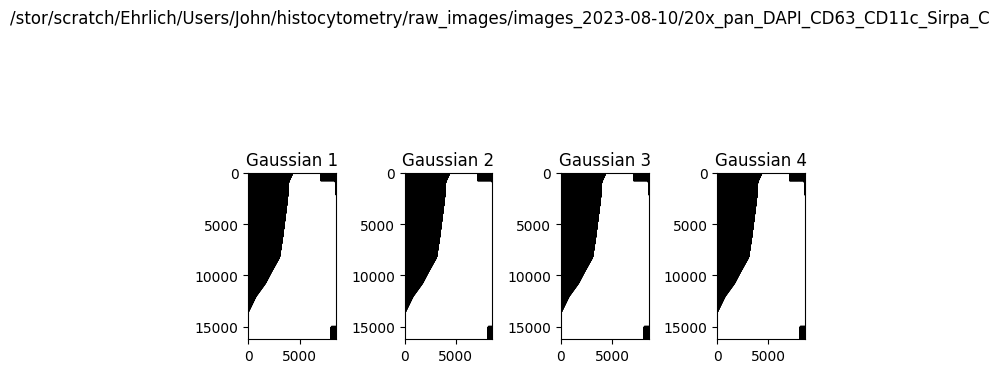

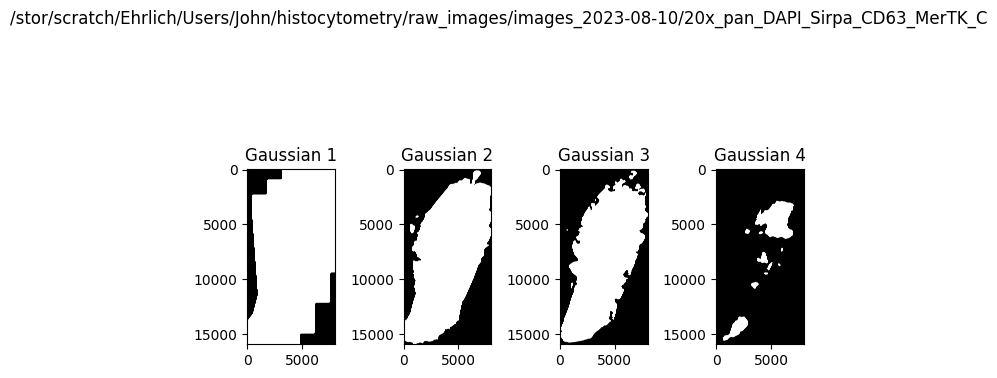

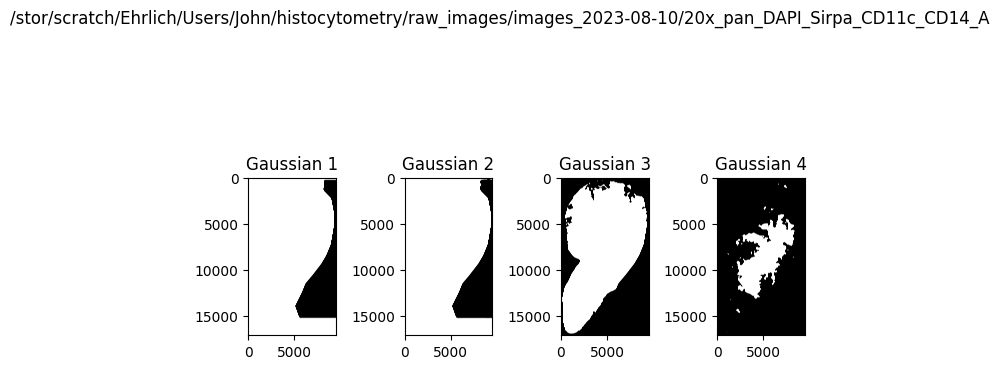

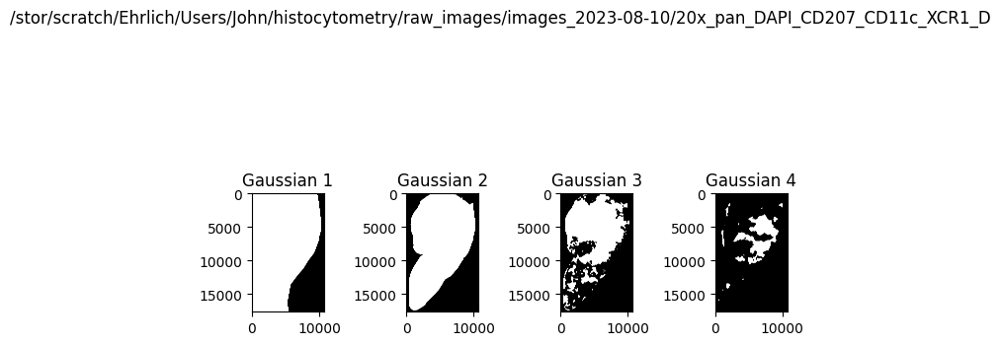

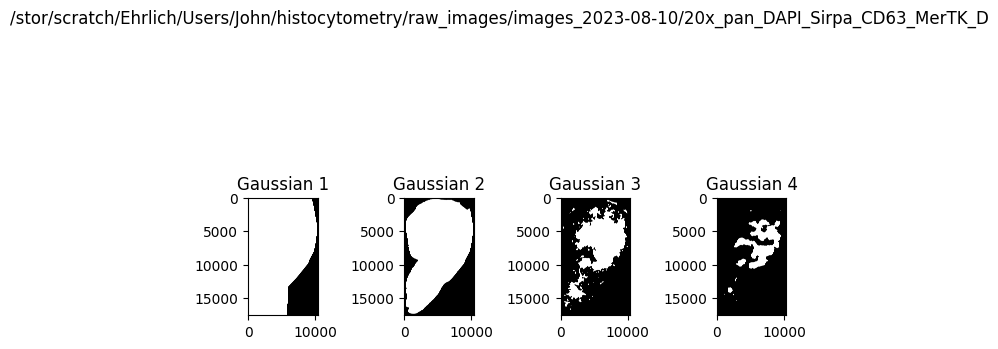

...

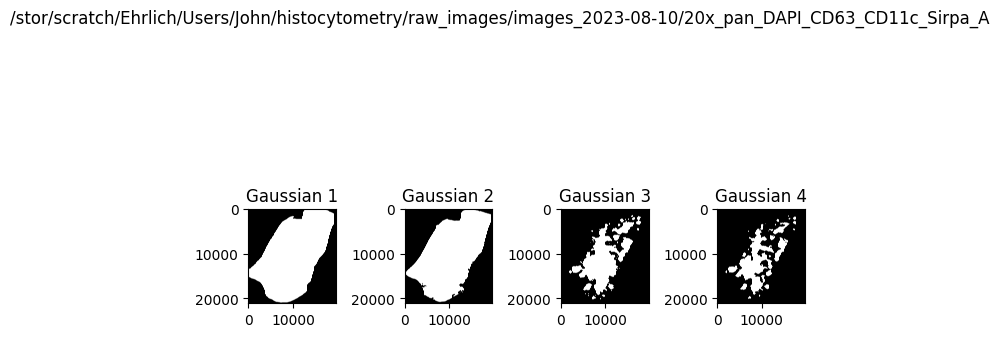

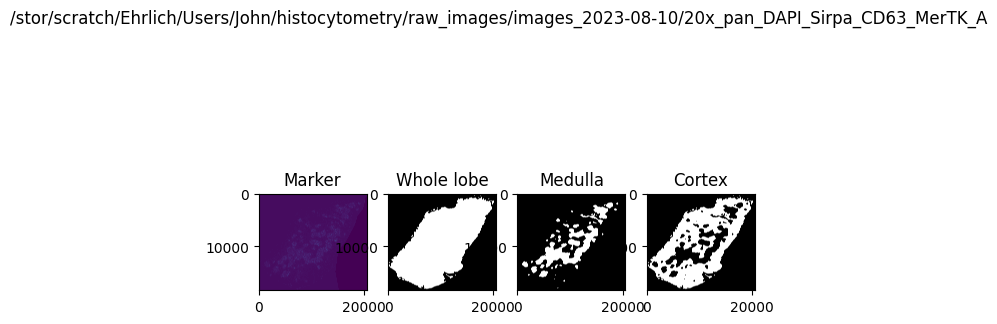

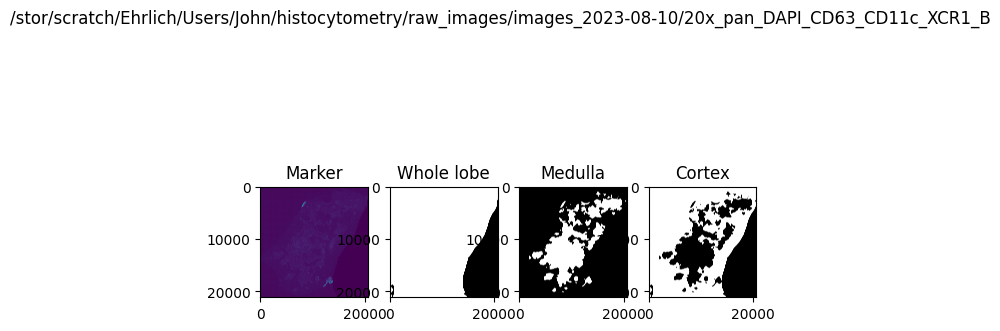

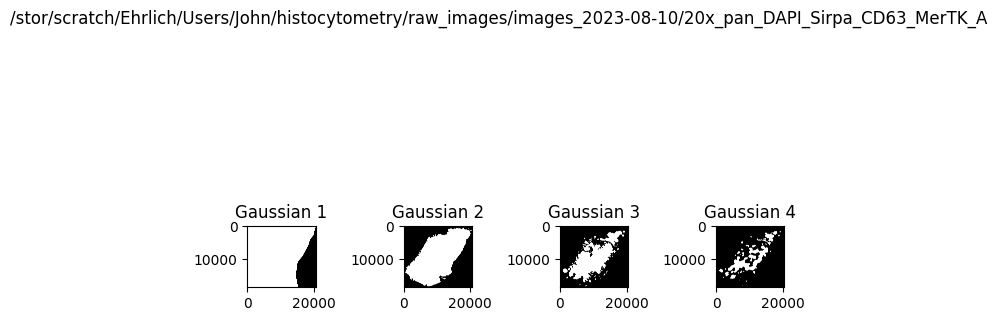

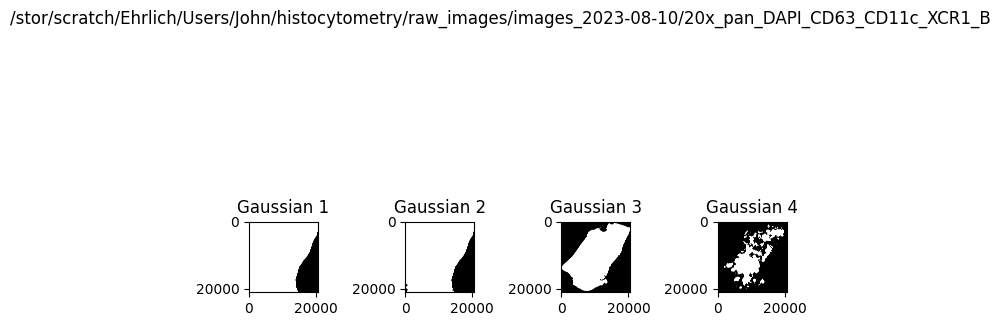

In [ ]:
histocytometry_wrapper_parallelization(image_dirs                = img_dirs, 
                                       whole_lobe_threshold_rank = 2, ## Setting ranks as placeholders
                                       medullary_threshold_rank  = 4, 
                                       save_masks                = False, 
                                       plot_tissues              = False,
                                       plot_thresholds           = True
                                       )

## Picking cortical and medullary gaussians for each image 

In [ ]:
img_dict = {
    "C2_M4" : ["20x_pan_DAPI_Sirpa_CD63_MerTK_A", "20x_pan_DAPI_Sirpa_CD63_MerTK_B", "20x_pan_DAPI_Sirpa_CD63_MerTK_C", "20x_pan_DAPI_Sirpa_CD63_MerTK_D", 
               "20x_pan_DAPI_B220_CD11c_SiglecH_A", "20x_pan_DAPI_B220_CD11c_SiglecH_C", 
               "20x_pan_DAPI_Sirpa_CD11c_CD14_A", "20x_pan_DAPI_Sirpa_CD11c_CD14_B",
               "20x_pan_DAPI_CD207_CD11c_XCR1_A", "20x_pan_DAPI_CD207_CD11c_XCR1_C",  "20x_pan_DAPI_CD207_CD11c_XCR1_D",
               "20x_pan_DAPI_CD63_CD11c_Sirpa_B", "20x_pan_DAPI_CD63_CD11c_Sirpa_D"],
    "C1_M4" : ["20x_pan_DAPI_CD63_CD11c_Sirpa_A", 
               "20x_pan_DAPI_CD63_CD11c_XCR1_A","20x_pan_DAPI_CD63_CD11c_XCR1_C",
               "20x_pan_DAPI_B220_CD11c_SiglecH_B"],
    "C3_M4" : ["20x_pan_DAPI_CD207_CD11c_XCR1_B", 
               "20x_pan_DAPI_Sirpa_CD11c_CD14_C",
               "20x_pan_DAPI_CD63_CD11c_XCR1_B","20x_pan_DAPI_CD63_CD11c_XCR1_D"]
}
        ## CD14_C, DAPI_CD63_CD11c_XCR1_A look bad
        ##"trash" : ["20x_pan_DAPI_CD63_CD11c_Sirpa_C"]
## I think that the background removal is causing artifically perfect looking segmentation of the whole lobe for pDC_B. 

i = 0 
for key in img_dict.keys():
    i = i + len(img_dict[key])
print(i)
## 22 is how many directoires I have in /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10
    ## I only have 21 b/c 20x_pan_DAPI_CD63_CD11c_Sirpa_C has no CD11c signal.

21


C2_M4
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_B
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_A
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_C
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD63_MerTK_D
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_A
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_C
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_A
Starting segmentation of /stor/scratch/Ehrlich/Users

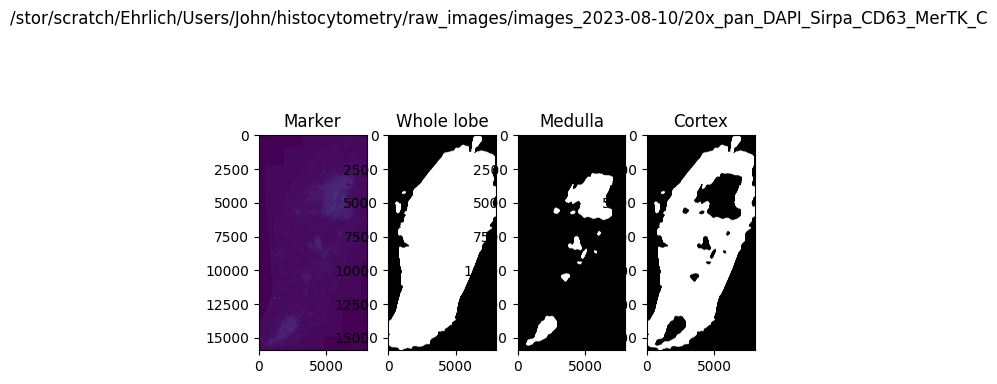

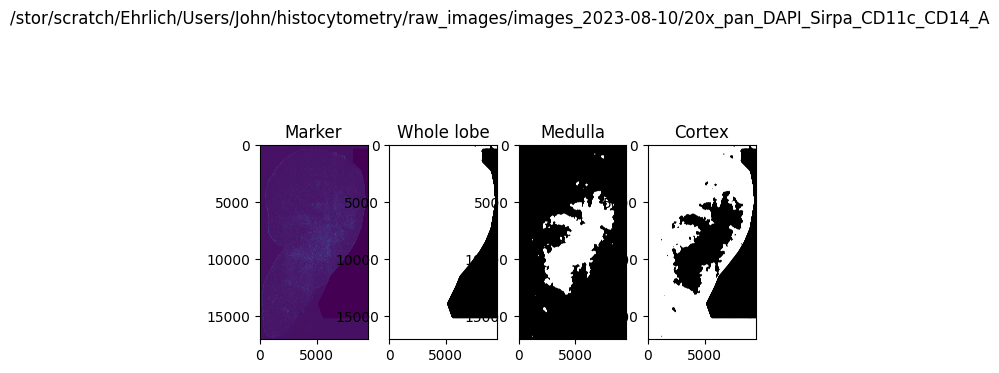

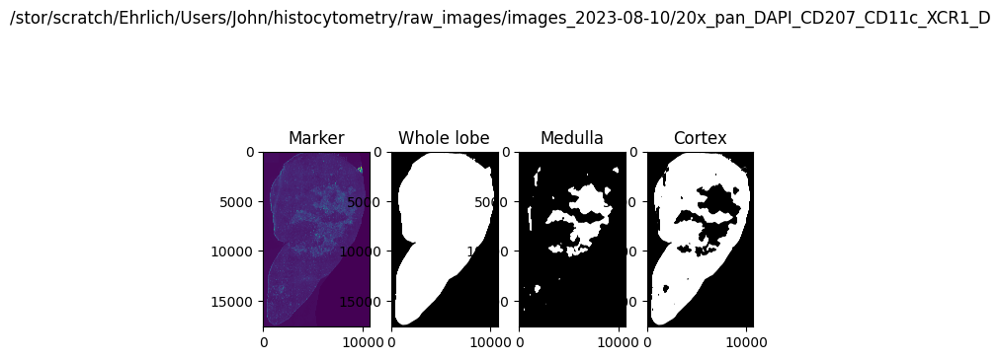

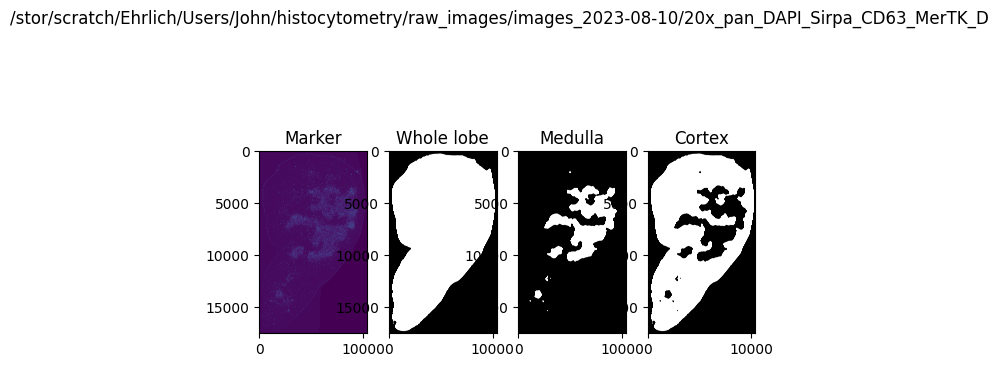

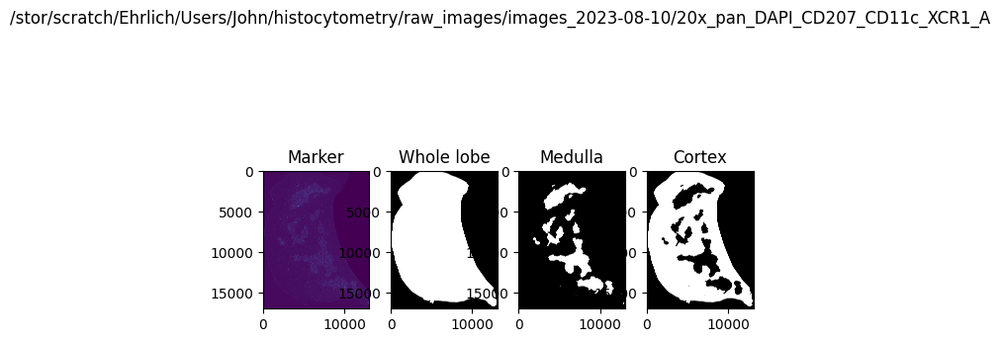

...

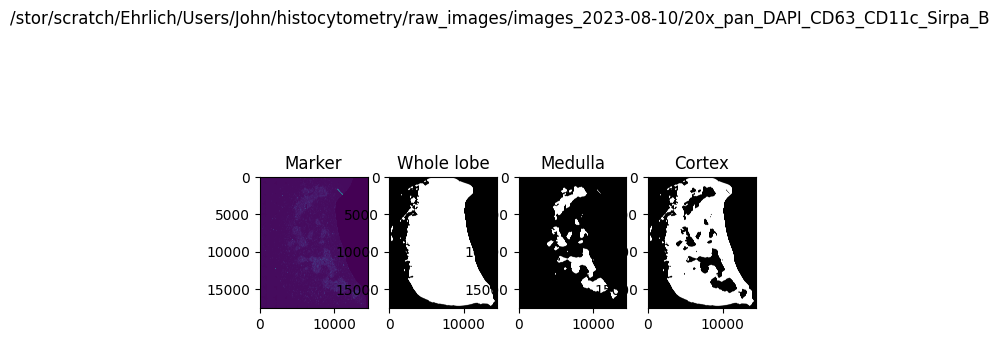

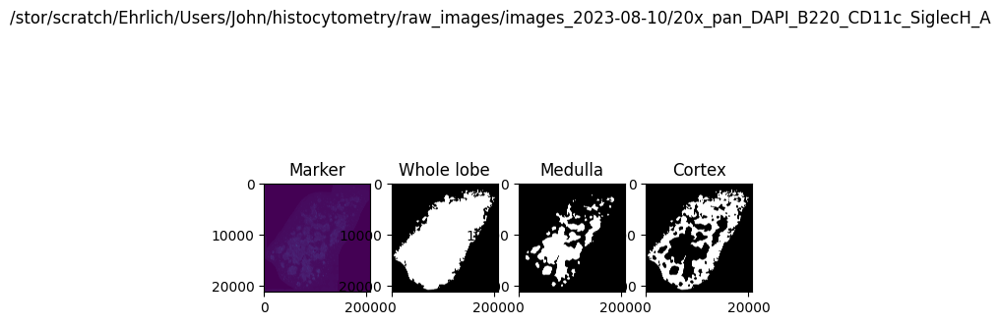

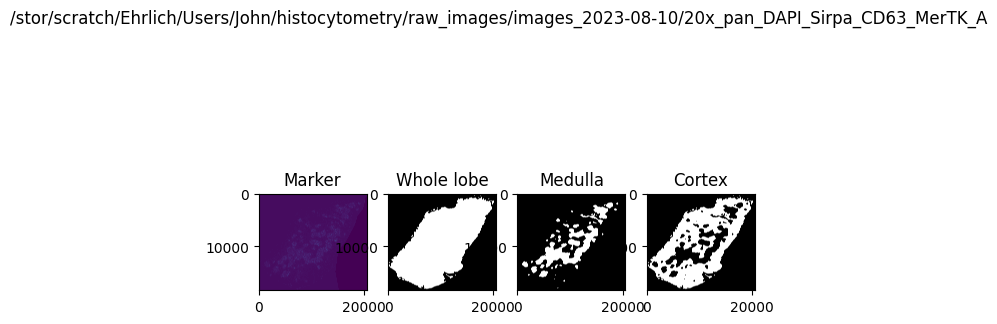

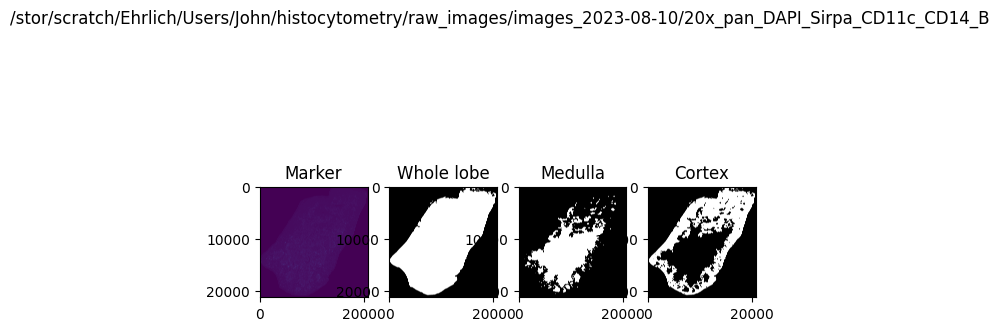

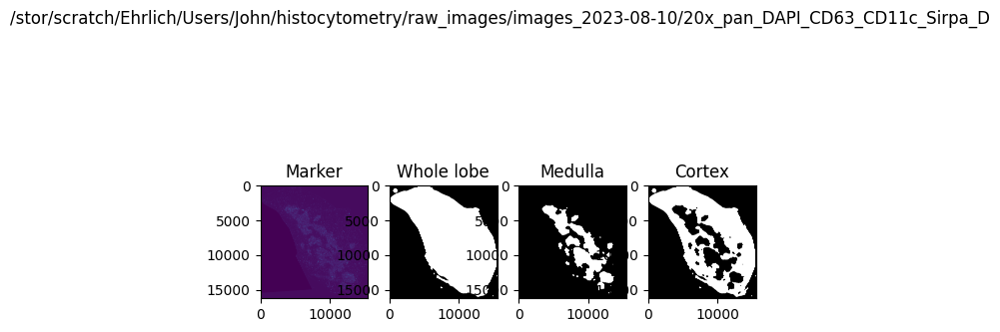

Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_Sirpa_A
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_A
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_B220_CD11c_SiglecH_B
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_C




C1_M4


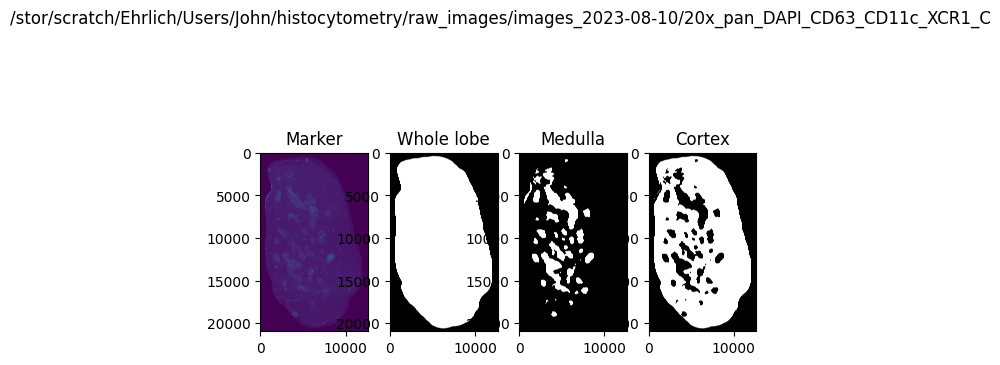

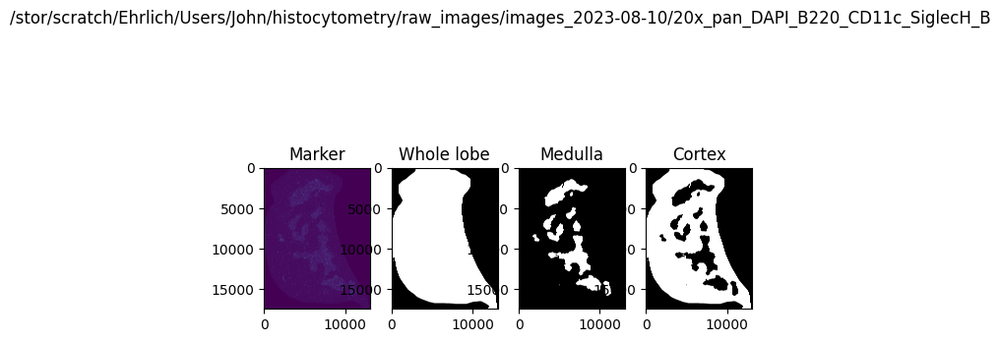

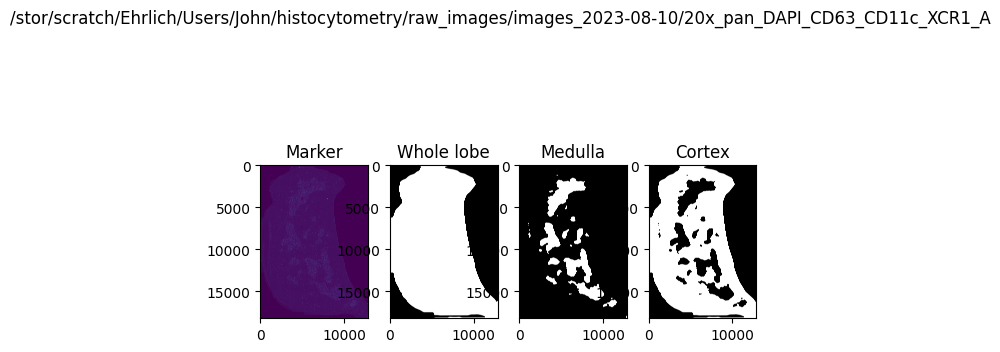

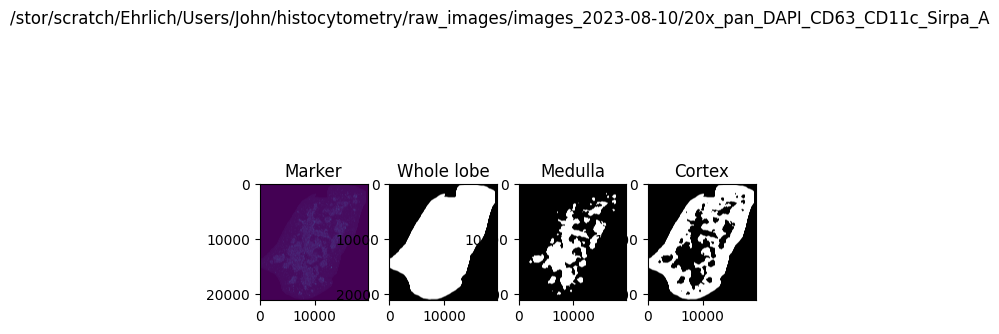

Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_B
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_C
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_D
Starting segmentation of /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD63_CD11c_XCR1_B




C3_M4


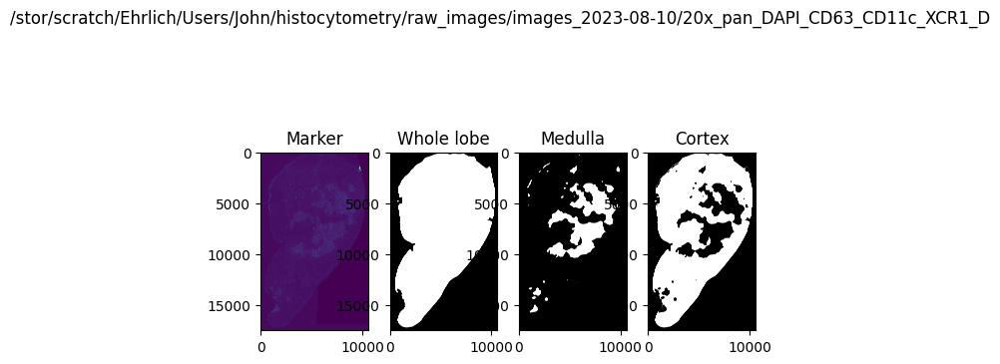

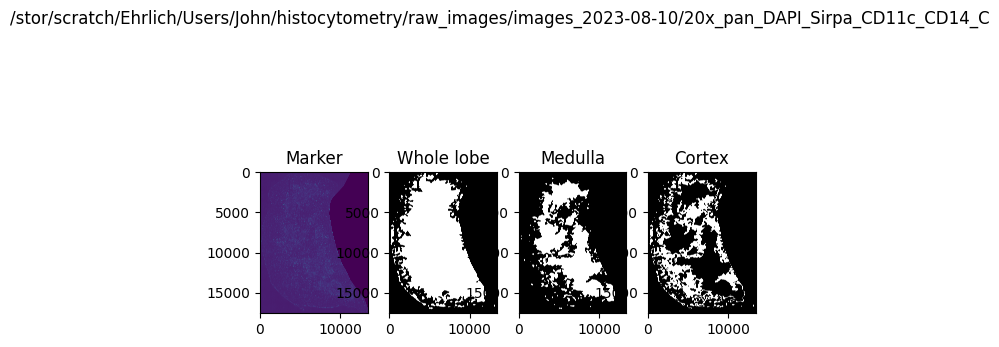

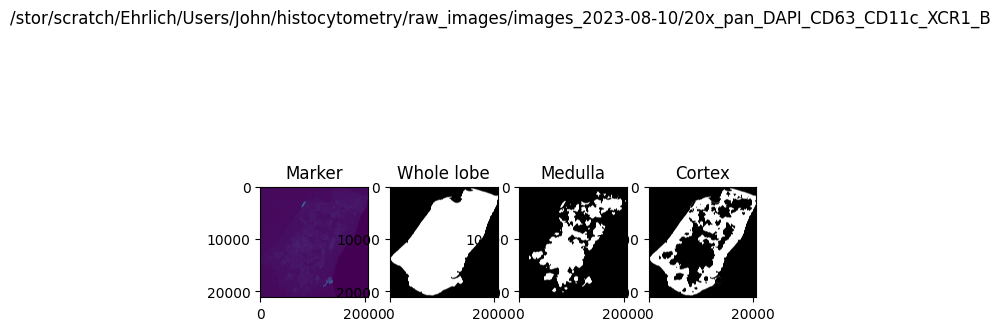

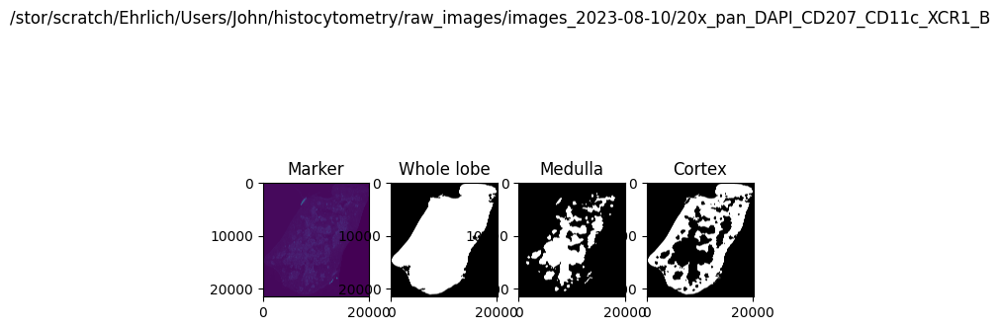

In [ ]:
raw_dir= "/stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10"

for key in img_dict.keys():
    print(key)
    whole_lobe_gaussian = int(re.search(r"C(\d)_.*$", key).group(1))
    medullary_gaussian  = int(re.search(r"C\d_M(\d)", key).group(1))

    key_dirs= [os.path.join(raw_dir, img_dir) for img_dir in img_dict[key]]

    histocytometry_wrapper_parallelization(image_dirs                = key_dirs,
                                           whole_lobe_threshold_rank = whole_lobe_gaussian, 
                                           medullary_threshold_rank  = medullary_gaussian, 
                                           save_masks                = True, 
                                           plot_tissues              = True,
                                           plot_thresholds           = True)


## Lobes that are wrong:
    ## /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_Sirpa_CD11c_CD14_A
        ## The whole lobe is too big, maybe a later gaussian would be better. 
    ## /stor/scratch/Ehrlich/Users/John/histocytometry/raw_images/images_2023-08-10/20x_pan_DAPI_CD207_CD11c_XCR1_C

## Some of these look like shit.
## I'm I really sure that I don't want to try to do a fifth gaussian again. 
## I'm not sure why they don't look great. 
## I think the real issue is that some of the images have the wrong gaussians being applied to them. 
    ## I'll plot the thresholds as well in the future. 

## I am almost convinced that XCR1_C and SiglecH_B have beautiful cortices because they segment the background noise away rather than the actual cortical signal. 


In [ ]:
if False:
    for img_dir in img_dirs:
        remove_tif(img_dir, image_to_remove= "reordered_image.ome.tif")
        remove_tif(img_dir, image_to_remove= "medulla_mask.tif")
        remove_tif(img_dir, image_to_remove= "cortex_mask.tif")

## Old Code

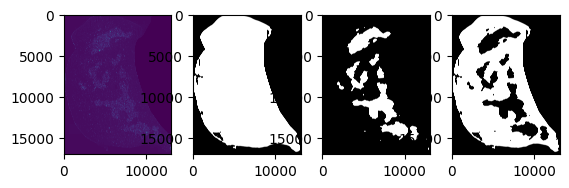

In [ ]:
medulla_mask = threshold_masks[2,...]
whole_lobe_mask = threshold_masks[1,...]
cortex_mask = whole_lobe_mask - medulla_mask

_ , ax = plt.subplots(1,4)
ax[0].imshow(img)
ax[1].imshow(whole_lobe_mask, cmap= plt.cm.gray)
ax[2].imshow(medulla_mask,    cmap= plt.cm.gray)
ax[3].imshow(cortex_mask,     cmap= plt.cm.gray)

In [ ]:
def segment_fluorescence(image_dir    : str_or_path, 
                         median_ksize : int         = 11, ## has to be odd
                         morph_ksize  : tuple       = (75,75), 
                         final_median_ksize : int   = 251, # Bigger to smooth out medulla regions
                         channel_loc  : int         = 2,
                         out_name     : str_or_path = "medulla",
                         inv_name     : str_or_path = "cortex_and_background",
                         glob_str     : str         = 'image.tif',
                         n_gaussian   : int         = 3
                        ) -> tuple:
    ## Loading image 
    print("Starting with " + image_dir)
    image_name = [file_path for file_path in Path(image_dir).rglob(glob_str)]
    if len(image_name) > 1:
        print(image_dir + " has more than one tif")
        return None
    full_img  = tifffile.imread(os.path.join(image_dir, *image_name))
    img  = full_img[channel_loc, ...]

    print("Loaded image")

    ## Median blur
    blur = cv2.medianBlur(img, median_ksize)

    print("Blurred image")

    ## GMM 
    classif = GaussianMixture(n_components= n_gaussian)
    classif.fit(img.reshape((blur.size, 1)))
        ## This is the step that takes a while 
    print("Fit mixture model")

    threshold = max(classif.means_)
        ## The top gaussian should be the bright medulla 
    binary_img = blur > threshold
    binary_img = binary_img * np.uint8(1)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, morph_ksize)
    binary_img = cv2.morphologyEx(binary_img, cv2.MORPH_CLOSE, kernel)
    print("Calculated morphology")
    
    ## Final median blur to remove the salt-and-pepper high values in cortex
    binary_img = cv2.medianBlur(binary_img, final_median_ksize)
    print("Blurred morphology")
    
    ## Making subsetted image
    medulla_dir = os.path.join(image_dir + "_" + out_name)
    if not os.path.isdir(medulla_dir):
        os.makedirs(medulla_dir)
    subset_img = full_img * binary_img
    subset_name = out_name + ".ome.tif" 
    tifffile.imwrite(os.path.join(medulla_dir, subset_name), subset_img)
    print("Subsetted image")
    
    ## Overlaying medulla mask onto original image
    binary_img_3d = binary_img[np.newaxis,...]
    overlaid_image = np.concatenate((full_img, binary_img_3d))
    overlaid_name = out_name + "_on_image.ome.tif"
    tifffile.imwrite(os.path.join(image_dir, overlaid_name), overlaid_image)
    print("Overlaid mask onto original image")
    
    ## Making inverse of subsetted image
        ## In this instance, it would be defining out_name as the subset and inv_name as the inv_subset (medulla and cortex respectively)
    cortex_dir = os.path.join(image_dir + "_" + inv_name)
    if not os.path.isdir(cortex_dir):
        os.makedirs(cortex_dir)
    inv_binary_img = np.uint8(1) - binary_img
    inv_subset_img = full_img * inv_binary_img
    inv_binary_name = inv_name + ".ome.tif"
    tifffile.imwrite(os.path.join(cortex_dir, inv_binary_name), inv_subset_img)
    print("Subsetted inverse region")
    
    return (binary_img, img)

In [ ]:
## Parameters for Ryan's images 
if False:
    for img_dir in img_dirs_old: 
        img_output = segment_fluorescence(image_dir          = img_dir,
                                        median_ksize       = 11, ## has to be odd
                                        morph_ksize        = (75,75), 
                                        final_median_ksize = 251, # Bigger to smooth out medulla regions
                                        channel_loc        = 2,
                                        out_name           = "medulla",
                                        inv_name           = "cortex_and_background",
                                        glob_str           = 'image.tif',
                                        n_gaussian         = 3) ## Gaussians for the background, cortex, and medulla (medulla is the only one that gets properly segmented).
        
        ## Plotting
        _, ax = plt.subplots(1,2)
        ax[0].imshow(img_output[0], cmap= plt.cm.gray, interpolation= "nearest")
        ax[1].imshow(img_output[1], interpolation= "nearest")
        plt.show()    

In [ ]:
if False: 
    for img_dir in img_dirs_new: 
        img_output = segment_fluorescence(image_dir          = img_dir,
                                        median_ksize       = 11, ## has to be odd
                                        morph_ksize        = (200,200), 
                                        final_median_ksize = 251, # Bigger to smooth out medulla regions
                                        channel_loc        = 2,
                                        out_name           = "medulla",
                                        inv_name           = "cortex_and_background",
                                        glob_str           = 'image.tif',
                                        n_gaussian         = 3) ## Gaussians for the background, cortex, and medulla (medulla is the only one that gets properly segmented).
        
        ## Plotting
        _, ax = plt.subplots(1,2)
        ax[0].imshow(img_output[0], cmap= plt.cm.gray, interpolation= "nearest")
        ax[1].imshow(img_output[1], interpolation= "nearest")
        plt.show() 

Loaded image


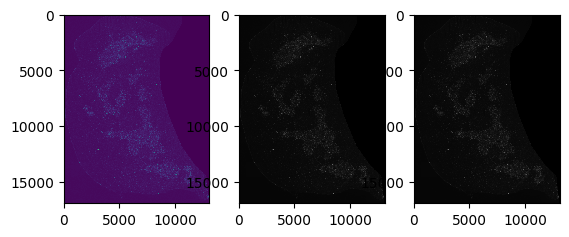

In [ ]:
_, ax = plt.subplots(1,3)
ax[0].imshow(img, interpolation= "nearest")
ax[1].imshow(med_blur,  cmap= plt.cm.gray, interpolation= "nearest")
ax[2].imshow(mean_blur, cmap= plt.cm.gray, interpolation= "nearest")
plt.show() 

morph_ksize:  (75, 75)
Morphed image
Final median kernel size:  251


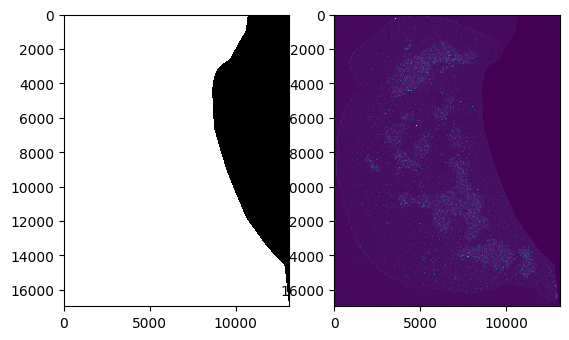

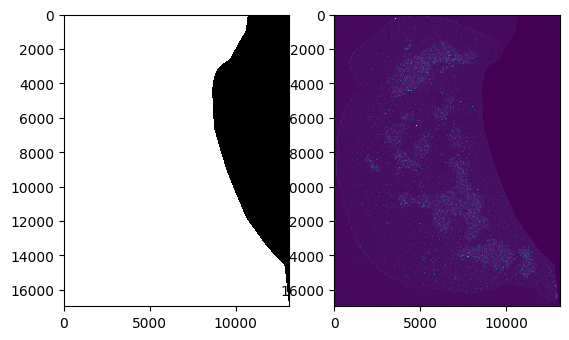

morph_ksize:  (75, 75)
Morphed image
Final median kernel size:  251


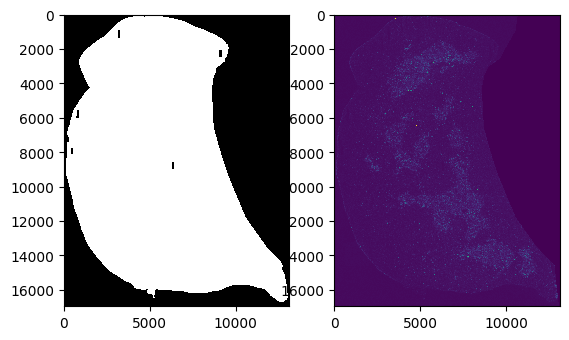

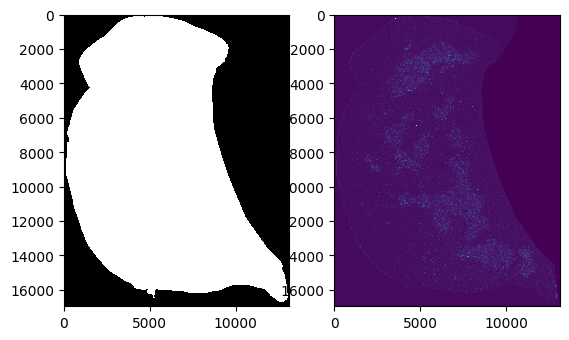

morph_ksize:  (75, 75)
Morphed image
Final median kernel size:  251


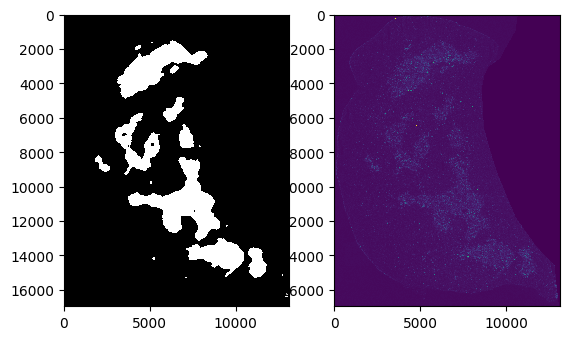

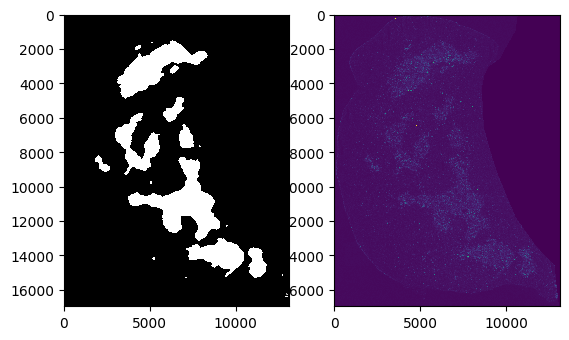

morph_ksize:  (75, 75)
Morphed image
Final median kernel size:  251


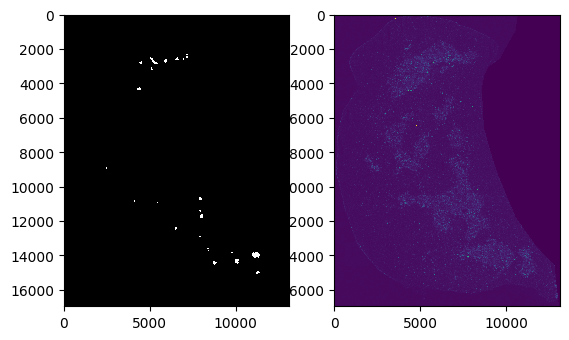

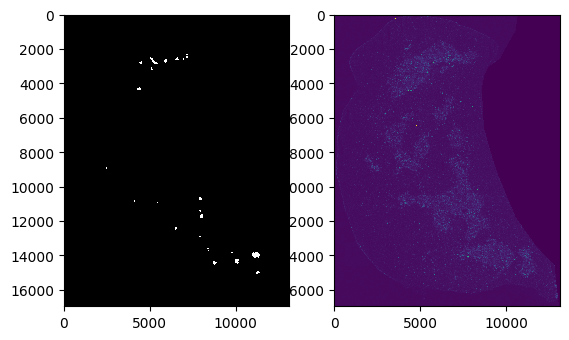

In [ ]:
# morph_ksize= (75, 75)
#     ## Maybe increasing the morph kernel size increases the segmentation of the medullary regions.


# final_median_ksize = 251

# # thresholds = thresholds[[0,2]]
# # threshold = max(thresholds)
#     ## The top gaussian should be the bright medulla 


# # binary_img = mean_blur > threshold
# # binary_img = binary_img * np.uint8(1)

# ## I think the higher morphology values are shrinking the smaller medullary regions too much. (The higher values look really smooth for the bigger regions though.)
# ## For the bigger regions, 200 is perfect. 


# def make_threshold_masks():
# for threshold in thresholds:
#     binary_img = mean_blur > threshold
#     binary_img = binary_img * np.uint8(1)     

#     ## I think if I increase the morph kernel size, the medulla will smooth out. 
#     # morph_ksize = (75 + i, 75 + i)
#     morph_ksize = (75, 75)
#     print("morph_ksize: ",morph_ksize)
#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, morph_ksize)
#     binary_img = cv2.morphologyEx(binary_img, cv2.MORPH_CLOSE, kernel)
#     print("Morphed image")

#     final_median_ksize= 251 
#     print("Final median kernel size: ", final_median_ksize)
#     binary_img = cv2.medianBlur(binary_img, final_median_ksize)

#     _, ax = plt.subplots(1,2)
#     ax[0].imshow(binary_img, cmap= plt.cm.gray, interpolation= "nearest")
#     ax[1].imshow(img, interpolation= "nearest")
#     plt.show() 

#     ## Smoothing remaining holes 
#     contour,hier = cv2.findContours(binary_img, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

#     for cnt in contour:
#         cv2.drawContours(binary_img,[cnt],0,255,-1)

#     _, ax = plt.subplots(1,2)
#     ax[0].imshow(binary_img, cmap= plt.cm.gray, interpolation= "nearest")
#     ax[1].imshow(img, interpolation= "nearest")
#     plt.show() 



# medulla_mask = binary_img
# cortex_mask = background_mask * cv2.bitwise_not(medulla_mask)

In [ ]:
import pickle

pickle_file= os.path.join(image_dir, "model_list.pkl")
with open(pickle_file, 'wb') as fp:
    pickle.dump(models, fp)